<a href="https://colab.research.google.com/github/frnocentini/brain-tumor-object-dectection/blob/main/Brain_Tumor_Object_Detection_Scratch_Crop_Brightness.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
%cd '/content/drive/MyDrive/dataset brain tumor/dataset'

/content/drive/.shortcut-targets-by-id/1LSYxqUtErLWfbOg3Kht_4Q02IsWLPY5r/dataset brain tumor/dataset


In [3]:
!unzip 'axial_t1wce_2_class' -d '/dataset unzipped'

Archive:  axial_t1wce_2_class.zip
  inflating: /dataset unzipped/axial_t1wce_2_class/axial_t1wce_2_class.yaml  
   creating: /dataset unzipped/axial_t1wce_2_class/images/
   creating: /dataset unzipped/axial_t1wce_2_class/images/test/
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_101.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_109.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_111.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_117.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_121.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_126.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_134.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_66.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_75.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/image

In [4]:
!unzip 'coronal_t1wce_2_class' -d '/dataset unzipped'

Archive:  coronal_t1wce_2_class.zip
  inflating: /dataset unzipped/coronal_t1wce_2_class/coronal_t1wce_2_class.yaml  
   creating: /dataset unzipped/coronal_t1wce_2_class/images/
   creating: /dataset unzipped/coronal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/13.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/15.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/17.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/19.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/20.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/23.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/33.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/34.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/35.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/36.jpg  
  inflating: /d

In [5]:
!unzip 'sagittal_t1wce_2_class' -d '/dataset unzipped'

Archive:  sagittal_t1wce_2_class.zip
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_102.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_121.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_140.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_159.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_110.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_129.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_147.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_166.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_154.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_173.jpg  
  inflating: /

In [6]:
# Data Manipulation
import numpy as np
import pandas as pd
import os
# Visualization/Image Processing
import cv2
import matplotlib.pyplot as plt
from tqdm import tqdm
# Machine Learning
import tensorflow as tf
from tensorflow.keras.layers import Conv2D, Input, BatchNormalization, Flatten, MaxPool2D, MaxPooling2D, Dense, Activation, Dropout
from PIL import Image
# Other
from pathlib import Path
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
from tensorflow import keras
from tensorflow.keras.applications import EfficientNetB0
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.models import Model
import xml.etree.ElementTree as ET
from tensorflow.keras.models import Sequential
from tensorflow.keras import layers
import imutils
from PIL import Image, ImageEnhance

In [7]:
%cd '/dataset unzipped'

/dataset unzipped


In [8]:
def crop_brain_contour(image, plot=False):
    
    #import imutils
    #import cv2
    #from matplotlib import pyplot as plt
    
    brightness = 30
    image = np.int16(image)
    image = image + brightness
    image = np.clip(image,0,255)
    image = np.uint8(image)
    #image_enhance = ImageEnhance.Brightness(image)
    #factor = 1.5
    #image = image_enhance.enhance(factor)

    # Convert the image to grayscale, and blur it slightl
    
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    gray = cv2.GaussianBlur(gray, (5, 5), 0)

    # Threshold the image, then perform a series of erosions +
    # dilations to remove any small regions of noise
    #thresh = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY,11,2)
    thresh = cv2.threshold(gray, 30, 255, cv2.THRESH_BINARY)[1]
    #thresh = cv2.erode(thresh, None, iterations=2)
    #thresh = cv2.dilate(thresh, None, iterations=2)

    # Find contours in thresholded image, then grab the largest one
    cnts = cv2.findContours(thresh.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cnts = imutils.grab_contours(cnts)
    c = max(cnts, key=cv2.contourArea)
    

    # Find the extreme points
    extLeft = tuple(c[c[:, :, 0].argmin()][0])
    extRight = tuple(c[c[:, :, 0].argmax()][0])
    extTop = tuple(c[c[:, :, 1].argmin()][0])
    extBot = tuple(c[c[:, :, 1].argmax()][0])
    
    # crop new image out of the original image using the four extreme points (left, right, top, bottom)
    new_image = image[extTop[1]:extBot[1], extLeft[0]:extRight[0]]            

    if plot:
        plt.figure()

        plt.subplot(1, 2, 1)
        plt.imshow(image)
        
        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)
        
        plt.title('Original Image')
            
        plt.subplot(1, 2, 2)
        plt.imshow(new_image)

        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)

        plt.title('Cropped Image')
        
        plt.show()

    #add contrast
    #kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(3,3))
    # Top Hat Transform
    #topHat = cv2.morphologyEx(new_image, cv2.MORPH_TOPHAT, kernel)
    # Black Hat Transform
    #blackHat = cv2.morphologyEx(new_image, cv2.MORPH_BLACKHAT, kernel)
    
    #new_image = new_image + topHat - blackHat
    
    return new_image,extLeft,extRight,extTop,extBot

In [9]:
#Codice per rendere l'immagine quadrata 
def make_square(im, fill_color=(0, 0, 0, 0)):
    x, y = im.shape[0], im.shape[1]
    size = max(x, y)
    BLACK = [0, 0, 0]
    new_im = cv2.copyMakeBorder(im,int((size-y)/2),int((size-y)/2),int((size-x)/2),int((size-x)/2),cv2.BORDER_CONSTANT, value = BLACK)
    return new_im

In [10]:
#Bounding box with one tumor
lab = ['axial_t1wce_2_class','coronal_t1wce_2_class', 'sagittal_t1wce_2_class']
X_train = []
bb = []
count = 0;
temp_array  = []
extLeft_coords_x = []
extLeft_coords_y = []
extRight_coords_x = []
extRight_coords_y = []
extTop_coords_x = []
extTop_coords_y = []
extBot_coords_x = []
extBot_coords_y = []
image_width = []
image_height = []


extLeft_coords_x_test = []
extLeft_coords_y_test = []
extRight_coords_x_test = []
extRight_coords_y_test = []
extTop_coords_x_test = []
extTop_coords_y_test = []
extBot_coords_x_test = []
extBot_coords_y_test = []
images_width_test = []
images_height_test = []
width_new_im = []
height_new_im = []
traslazione_x_test = []
traslazione_y_test = []

image_size = 224

for i in lab:
    folderPath = os.path.join('./',i,'images','train')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        image_width.append(img.shape[1])
        image_height.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image,extLeft,extRight,extTop,extBot = crop_brain_contour(img,False)
        extLeft_coords_x.append(extLeft[0])
        extLeft_coords_y.append(extLeft[1])
        extRight_coords_x.append(extRight[0])
        extRight_coords_y.append(extRight[1])
        extTop_coords_x.append(extTop[0])
        extTop_coords_y.append(extTop[1])
        extBot_coords_x.append(extBot[0])
        extBot_coords_y.append(extBot[1])
        # resize image
        image = cv2.resize(image, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        #if img.shape[0] != img.shape[1]:
            #img = make_square(img, fill_color=(0, 0, 0, 0))
        #img = cv2.resize(img,(image_size, image_size))
        X_train.append(image)

image_index = 0
#bb_train = np.zeros((len(X_train),4))
bb_list = []
duplicate_img = []
for i in lab:
    labelsPath = os.path.join('./',i,'labels','train')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            lbls_array = []
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)
                 
                temp_array[0] = temp_array[0]*image_width[count] #centro x immagine originale
                temp_array[0] = temp_array[0]-extLeft_coords_x[count]
                temp_array[0] = (temp_array[0]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                temp_array[1] = temp_array[1]*image_height[count]
                temp_array[1] = temp_array[1]-extTop_coords_y[count]
                temp_array[1] = (temp_array[1]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size
                
                temp_array[2] = temp_array[2]*(image_width[count])
                temp_array[2] = (temp_array[2]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                
                temp_array[3] = temp_array[3]*(image_height[count])
                temp_array[3] = (temp_array[3]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size                 
            
                lbls_array.append(temp_array)

                #print(temp_array)
                #bb_train[image_index] = np.array([temp_array])
                #print(bb_train[image_index])

            bb_list.append(temp_array)
            duplicate_img.append(lbls_array)
            image_index += 1
            count += 1

#Codice per duplicare le immagini con due bounding box
print('Dimensione delle liste prima di duplicare le immagini:')
print('X_train: ', len(X_train))
print('bb_list: ', len(bb_list))

for i in range(len(X_train)):
  if(len(duplicate_img[i]) == 2):
    X_train.append(X_train[i])
    bb_list.append(duplicate_img[i][0])  #dentro bb_list è già stata inserita la seconda label, quindi ora insieriamo la prima per l'immagine duplicata
bb_train = np.zeros((len(X_train),4))

for j in range(len(bb_list)):
  bb_train[j] = np.array([bb_list[j]])

#Dimensione delle liste dopo la duplicazione delle immagini:
print('Dimensione delle liste dopo la duplicazione delle immagini:')
print('X_train: ', len(X_train))
print('bb_train: ', len(bb_train))

X_test = []
for i in lab:
    folderPath = os.path.join('./',i,'images','test')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        images_width_test.append(img.shape[1])
        images_height_test.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image_test,extLeft_test,extRight_test,extTop_test,extBot_test = crop_brain_contour(img,False)
        extLeft_coords_x_test.append(extLeft_test[0])
        extLeft_coords_y_test.append(extLeft_test[1])
        extRight_coords_x_test.append(extRight_test[0])
        extRight_coords_y_test.append(extRight_test[1])
        extTop_coords_x_test.append(extTop_test[0])
        extTop_coords_y_test.append(extTop_test[1])
        extBot_coords_x_test.append(extBot_test[0])
        extBot_coords_y_test.append(extBot_test[1])
        # resize image
        image_test = cv2.resize(image_test, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        #if img.shape[0] != img.shape[1]:
            #img = make_square(img, fill_color=(0, 0, 0, 0))
        #img = cv2.resize(img,(image_size, image_size))
        X_test.append(image_test)

image_index = 0
count_test = 0;
#bb_test = np.zeros((len(X_test),4))
bb_list = []
duplicate_img = []
for i in lab:
    labelsPath = os.path.join('./',i,'labels','test')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            lbls_array = []
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)
                #width_new_im.append(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test])
                #height_new_im.append(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test])
                
                
                temp_array[0] = temp_array[0]*images_width_test[count_test] #centro x immagine originale
                temp_array[0] = temp_array[0]-extLeft_coords_x_test[count_test]
                temp_array[0] = (temp_array[0]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                temp_array[1] = temp_array[1]*images_height_test[count_test]
                temp_array[1] = temp_array[1]-extTop_coords_y_test[count_test]
                temp_array[1] = (temp_array[1]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size
                
                temp_array[2] = temp_array[2]*(images_width_test[count_test])
                temp_array[2] = (temp_array[2]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                
                temp_array[3] = temp_array[3]*(images_height_test[count_test])
                temp_array[3] = (temp_array[3]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size                 
            
                lbls_array.append(temp_array)

                #bb_test[image_index] = np.array([temp_array])
                #print(bb_test[image_index])

            bb_list.append(temp_array)
            duplicate_img.append(lbls_array)
            image_index += 1
            count_test += 1

#Codice per duplicare le immagini con due bounding box
print('Dimensione delle liste prima di duplicare le immagini:')
print('X_test: ', len(X_test))
print('bb_list: ', len(bb_list))

for i in range(len(X_test)):
  if(len(duplicate_img[i]) == 2):
    X_test.append(X_test[i])
    bb_list.append(duplicate_img[i][0])  #dentro bb_list è già stata inserita la seconda label, quindi ora insieriamo la prima per l'immagine duplicata

bb_test = np.zeros((len(X_test),4))

for j in range(len(bb_test)):
  bb_test[j] = np.array([bb_list[j]])

#Dimensione delle liste dopo la duplicazione delle immagini:
print('Dimensione delle liste dopo la duplicazione delle immagini:')
print('X_test: ', len(X_test))
print('bb_test: ', len(bb_test))

#print(bb_test[30])
#print(extRight_coords_x_test[30])
#print(extLeft_coords_x_test[30])
     


Dimensione delle liste prima di duplicare le immagini:
X_train:  878
bb_list:  878
Dimensione delle liste dopo la duplicazione delle immagini:
X_train:  919
bb_train:  919
Dimensione delle liste prima di duplicare le immagini:
X_test:  223
bb_list:  223
Dimensione delle liste dopo la duplicazione delle immagini:
X_test:  237
bb_test:  237


In [11]:
#prepare dataset 
train_dataset = ImageDataGenerator()
val_dataset = ImageDataGenerator()
test_dataset = ImageDataGenerator()

In [12]:
datagen = ImageDataGenerator(
  rescale = 1./255,
  #rotation_range = 5,
  shear_range = 0.02,
  #zoom_range = 0.02, 
  samplewise_center = True,
  samplewise_std_normalization = True
  #horizontal_flip=True
)

val_data_gen = ImageDataGenerator(rescale = 1./255)

In [13]:
#array conversion
X_train = np.array(X_train)
X_test = np.array(X_test)

In [14]:
#Shuffle
X_train, bb_train = shuffle(X_train, bb_train)

In [15]:
#Validation set created
X_train, X_val, bb_train, bb_val = train_test_split(X_train, bb_train, test_size = 0.1, shuffle = False)

In [16]:
tf.keras.backend.set_image_data_format('channels_last')
BATCH_SIZE = 32
#save_path = os.path.join('./', 'model_from_scratch')
train_dataset = train_dataset.flow(X_train, bb_train, batch_size = BATCH_SIZE)
val_dataset = val_dataset.flow(X_val, bb_val, batch_size = BATCH_SIZE)
test_dataset = test_dataset.flow(X_test, bb_test)

In [17]:
input_ = Input(shape=[image_size,image_size, 3])

x = input_

for i in range(10):
    n_filters = 2**(i + 3)
    x = Conv2D(n_filters, 3, activation='relu', padding='same')(x)
    x = BatchNormalization()(x)
    x = MaxPool2D(2, padding='same')(x)

x = Dropout(0.5)(x)
x = Flatten()(x)
x = Dense(256, activation='relu')(x)
x = Dense(32, activation='relu')(x)
output = Dense(4, name='coords')(x)

model = tf.keras.models.Model(input_, output)
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 conv2d (Conv2D)             (None, 224, 224, 8)       224       
                                                                 
 batch_normalization (BatchN  (None, 224, 224, 8)      32        
 ormalization)                                                   
                                                                 
 max_pooling2d (MaxPooling2D  (None, 112, 112, 8)      0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 112, 112, 16)      1168      
                                                                 
 batch_normalization_1 (Batc  (None, 112, 112, 16)     64    

In [18]:
# Draw the predicted bounding boxes
def display_image(img, bbox_coords, pred_coords):
    if len(bbox_coords) == 4: #in rosso
        xmin, ymin, height, width = bbox_coords
        img = cv2.rectangle(img, (int(xmin-height/2), int(ymin-width/2)), (int(xmin+height/2), int(ymin+width/2)), (255, 0, 0), 1)
    print(len(pred_coords))    
    if len(pred_coords) == 4: #in verde
        xmin1, ymin1, height1, width1 = pred_coords
        img = cv2.rectangle(img, (int(xmin1-height1/2), int(ymin1-width1/2)), (int(xmin1+height1/2), int(ymin1+width1/2)), (0, 255, 0), 1)
    plt.imshow(img)
    plt.xticks([])
    plt.yticks([])

In [19]:
#To test the model
def test_model(model):
    rand_index = np.random.randint(0, bb_test.shape[0])
    pred_bbox = model.predict(X_test)[rand_index]
    img_original = X_test[rand_index]
    img = img_original.copy()
    coords = bb_test[rand_index]
    #example, label = next(datagen)
    #X = example['image']
    #y = label['coords']
    #pred_bbox = model.predict(X)[0]
    #img = X[0]
    #gt_coords = y[0]
    
    display_image(img,bbox_coords = coords, pred_coords=pred_bbox)

def test(model):
    
    plt.figure(figsize=(15,7))
    for i in range(3):
        plt.subplot(1, 3, i + 1)
        test_model(model)    
    plt.show()

class ShowTestImages(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        test(self.model)
        

In [20]:
%cd '../content/drive/MyDrive'
! mkdir  model_checkpoint_SCRATCH

save_path = './model_checkpoint_SCRATCH/model_SCRATCH.h5'
     

/content/drive/MyDrive
mkdir: cannot create directory ‘model_checkpoint_SCRATCH’: File exists


In [21]:
callbacks_list = [
    keras.callbacks.ModelCheckpoint(
    save_format = 'h5',
    filepath=save_path,
    monitor='val_loss',
    verbose=1,
    save_best_only=True
    ),
    ShowTestImages()
]

In [22]:
METRIC_THRESH = 0.3

def raw_iou(y_true, y_pred):
    results = []
    for i in range(0,y_true.shape[0]):


        boxTrue_width = y_true[i,2]
        boxTrue_height = y_true[i,3]
        x_boxTrue_tleft = y_true[i,0]-boxTrue_width/2  # numpy index selection
        y_boxTrue_tleft = y_true[i,1]-boxTrue_height/2
    
        area_boxTrue = (boxTrue_width * boxTrue_height)

        # boxPred
        boxPred_width = y_pred[i,2]
        boxPred_height = y_pred[i,3]
        x_boxPred_tleft = y_pred[i,0]-boxPred_width/2  
        y_boxPred_tleft = y_pred[i,1]-boxPred_height/2
    
        area_boxPred = (boxPred_width * boxPred_height)


        # calculate the bottom right coordinates for boxTrue and boxPred

        # boxTrue
        x_boxTrue_br = x_boxTrue_tleft + boxTrue_width
        y_boxTrue_br = y_boxTrue_tleft + boxTrue_height # Version 2 revision

        # boxPred
        x_boxPred_br = x_boxPred_tleft + boxPred_width
        y_boxPred_br = y_boxPred_tleft + boxPred_height # Version 2 revision


        # calculate the top left and bottom right coordinates for the intersection box, boxInt

        # boxInt - top left coords
        x_boxInt_tleft = np.max([x_boxTrue_tleft,x_boxPred_tleft])
        y_boxInt_tleft = np.max([y_boxTrue_tleft,y_boxPred_tleft]) # Version 2 revision

        # boxInt - bottom right coords
        x_boxInt_br = np.min([x_boxTrue_br,x_boxPred_br])
        y_boxInt_br = np.min([y_boxTrue_br,y_boxPred_br]) 

        # Calculate the area of boxInt, i.e. the area of the intersection 
        # between boxTrue and boxPred.
        # The np.max() function forces the intersection area to 0 if the boxes don't overlap.
        
        
        # Version 2 revision
        area_of_intersection = \
        np.max([0,(x_boxInt_br - x_boxInt_tleft)]) * np.max([0,(y_boxInt_br - y_boxInt_tleft)])

        iou = np.mean(area_of_intersection / ((area_boxTrue + area_boxPred) - area_of_intersection)).astype(np.float32)


        # This must match the type used in py_func
        results.append(iou)
    return np.mean(results)
def IoU(y_true, y_pred):
    iou = tf.numpy_function(raw_iou, [y_true, y_pred], tf.float32)
    return iou

In [23]:
model.compile(
    loss={
        'coords': 'mae'
    },
    optimizer=tf.keras.optimizers.Adam(1e-3),
    metrics=[IoU]
)

Epoch 1/200
26/26 [==============================] - ETA: 0s - loss: 42.0479 - IoU: 0.0436
Epoch 1: val_loss improved from inf to 54.11315, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 1s 95ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 41ms/step
4


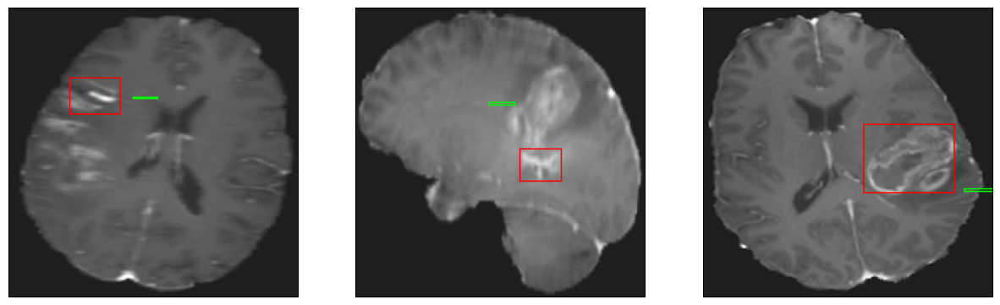

26/26 [==============================] - 46s 1s/step - loss: 42.0479 - IoU: 0.0436 - val_loss: 54.1131 - val_IoU: 0.0016
Epoch 2/200
26/26 [==============================] - ETA: 0s - loss: 25.9343 - IoU: 0.0791
Epoch 2: val_loss improved from 54.11315 to 26.13661, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 41ms/step
4


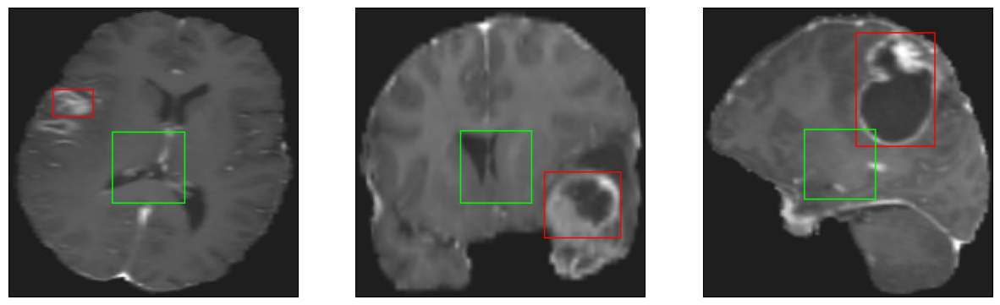

26/26 [==============================] - 14s 551ms/step - loss: 25.9343 - IoU: 0.0791 - val_loss: 26.1366 - val_IoU: 0.0923
Epoch 3/200
26/26 [==============================] - ETA: 0s - loss: 23.7131 - IoU: 0.1109
Epoch 3: val_loss did not improve from 26.13661
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4


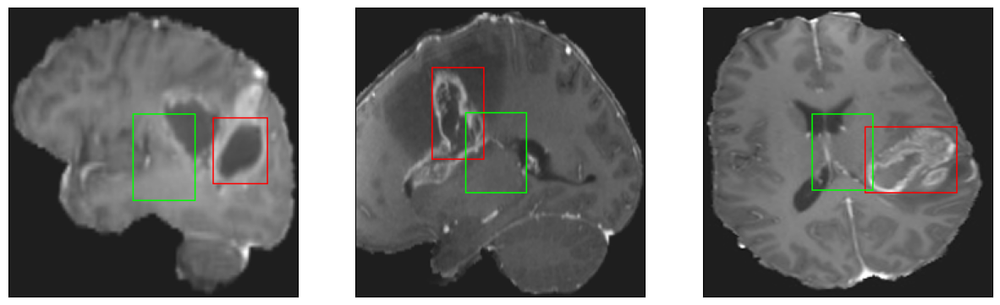

26/26 [==============================] - 7s 276ms/step - loss: 23.7131 - IoU: 0.1109 - val_loss: 26.5309 - val_IoU: 0.0916
Epoch 4/200
26/26 [==============================] - ETA: 0s - loss: 22.5704 - IoU: 0.1443
Epoch 4: val_loss improved from 26.13661 to 24.61154, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 47ms/step
4


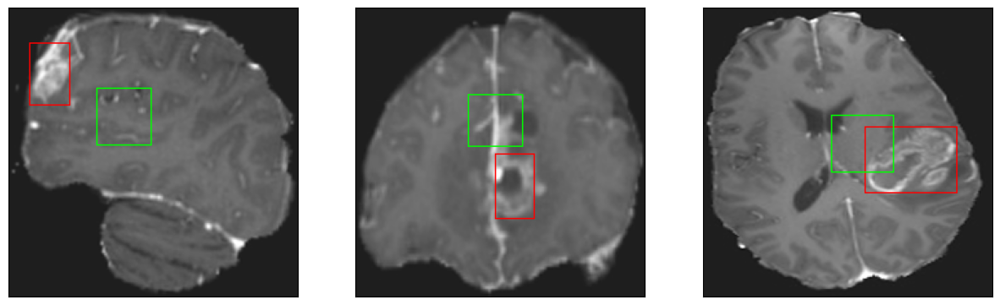

26/26 [==============================] - 14s 545ms/step - loss: 22.5704 - IoU: 0.1443 - val_loss: 24.6115 - val_IoU: 0.0934
Epoch 5/200
26/26 [==============================] - ETA: 0s - loss: 19.9612 - IoU: 0.1806
Epoch 5: val_loss improved from 24.61154 to 22.63535, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4


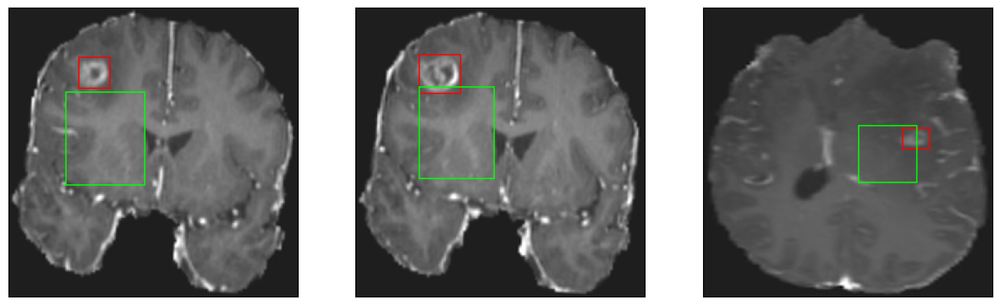

26/26 [==============================] - 14s 537ms/step - loss: 19.9612 - IoU: 0.1806 - val_loss: 22.6354 - val_IoU: 0.2290
Epoch 6/200
26/26 [==============================] - ETA: 0s - loss: 18.2161 - IoU: 0.2076
Epoch 6: val_loss did not improve from 22.63535
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


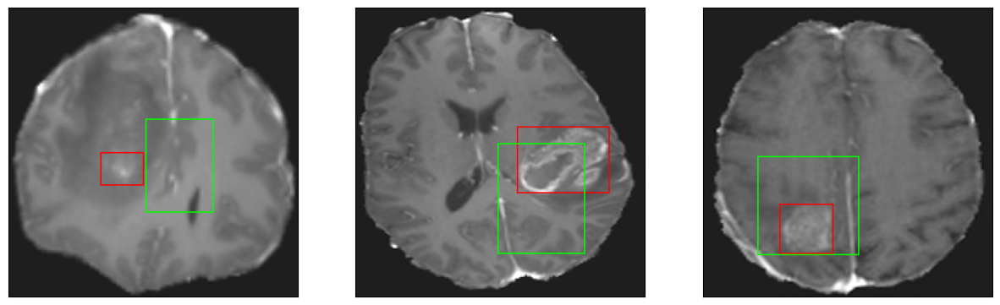

26/26 [==============================] - 8s 295ms/step - loss: 18.2161 - IoU: 0.2076 - val_loss: 28.8933 - val_IoU: 0.1687
Epoch 7/200
26/26 [==============================] - ETA: 0s - loss: 19.4411 - IoU: 0.1753
Epoch 7: val_loss did not improve from 22.63535
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


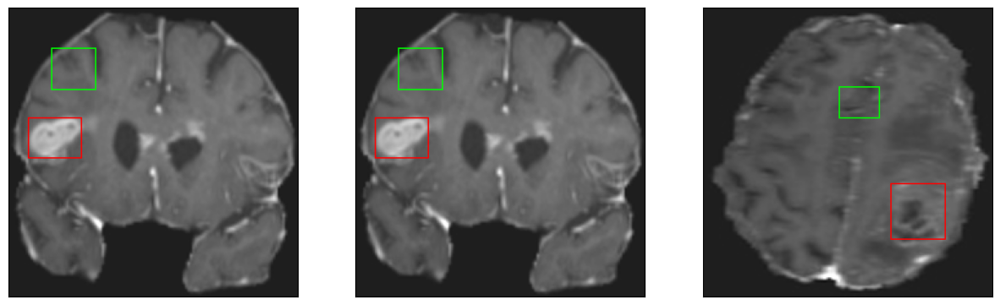

26/26 [==============================] - 8s 308ms/step - loss: 19.4411 - IoU: 0.1753 - val_loss: 23.4717 - val_IoU: 0.1324
Epoch 8/200
26/26 [==============================] - ETA: 0s - loss: 17.2962 - IoU: 0.2240
Epoch 8: val_loss did not improve from 22.63535
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


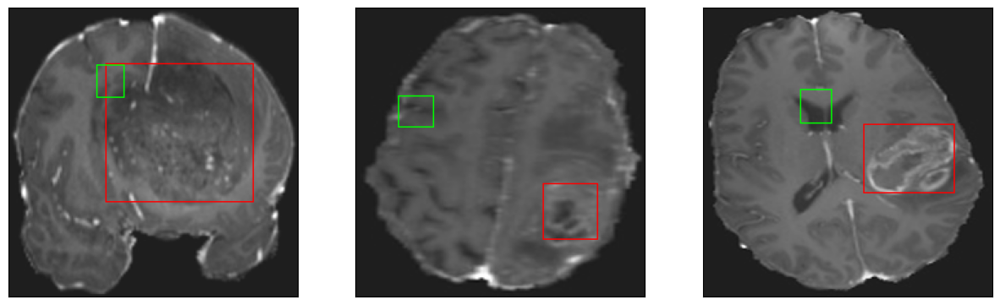

26/26 [==============================] - 8s 291ms/step - loss: 17.2962 - IoU: 0.2240 - val_loss: 23.3005 - val_IoU: 0.1849
Epoch 9/200
26/26 [==============================] - ETA: 0s - loss: 14.8604 - IoU: 0.2836
Epoch 9: val_loss improved from 22.63535 to 20.42054, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 40ms/step
4


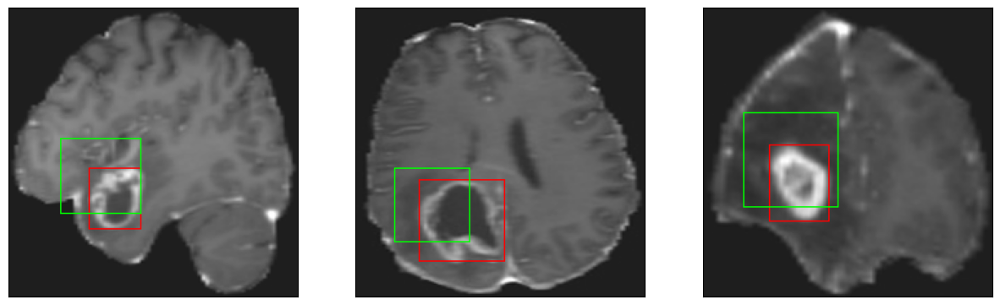

26/26 [==============================] - 17s 676ms/step - loss: 14.8604 - IoU: 0.2836 - val_loss: 20.4205 - val_IoU: 0.2387
Epoch 10/200
26/26 [==============================] - ETA: 0s - loss: 14.2073 - IoU: 0.2940
Epoch 10: val_loss did not improve from 20.42054
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4


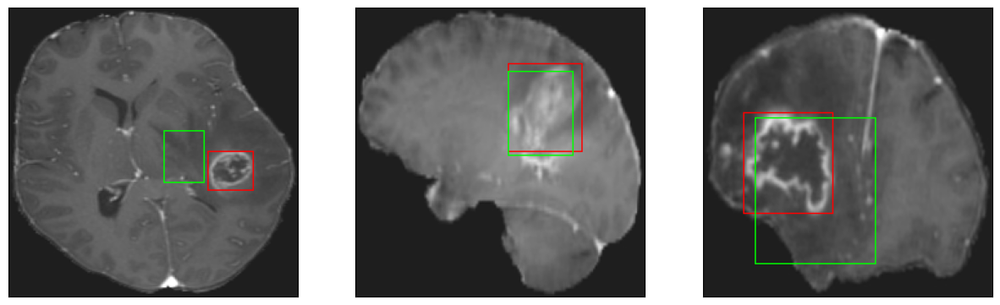

26/26 [==============================] - 8s 295ms/step - loss: 14.2073 - IoU: 0.2940 - val_loss: 21.2984 - val_IoU: 0.2403
Epoch 11/200
26/26 [==============================] - ETA: 0s - loss: 14.7245 - IoU: 0.2706
Epoch 11: val_loss did not improve from 20.42054
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


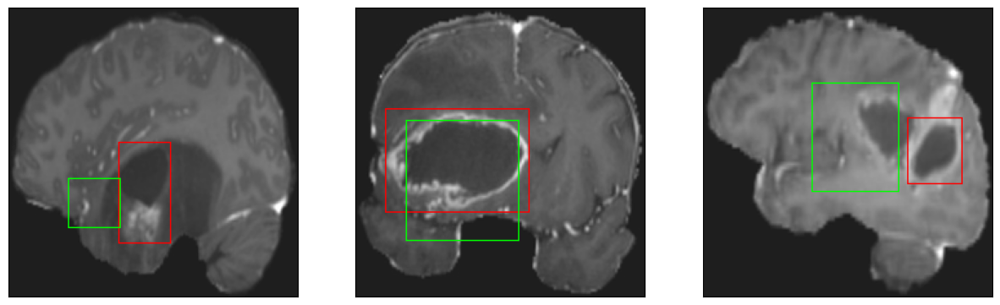

26/26 [==============================] - 8s 312ms/step - loss: 14.7245 - IoU: 0.2706 - val_loss: 26.2013 - val_IoU: 0.2412
Epoch 12/200
26/26 [==============================] - ETA: 0s - loss: 14.0351 - IoU: 0.2940
Epoch 12: val_loss improved from 20.42054 to 18.81993, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


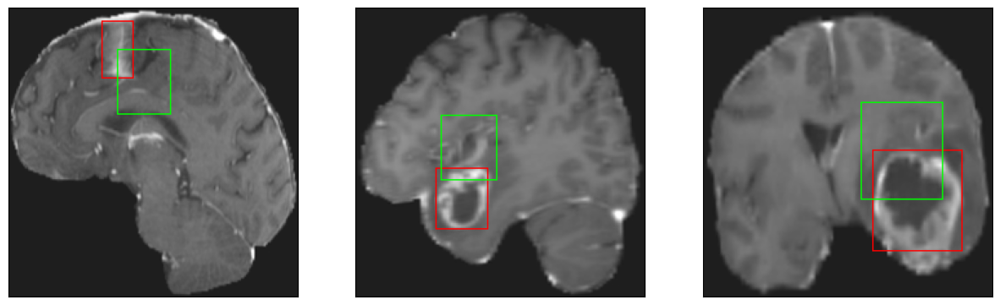

26/26 [==============================] - 14s 539ms/step - loss: 14.0351 - IoU: 0.2940 - val_loss: 18.8199 - val_IoU: 0.2120
Epoch 13/200
26/26 [==============================] - ETA: 0s - loss: 13.1729 - IoU: 0.3197
Epoch 13: val_loss improved from 18.81993 to 15.48172, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


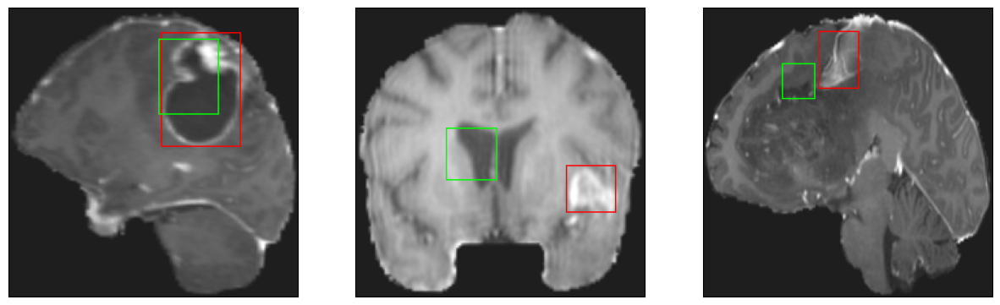

26/26 [==============================] - 14s 538ms/step - loss: 13.1729 - IoU: 0.3197 - val_loss: 15.4817 - val_IoU: 0.2659
Epoch 14/200
26/26 [==============================] - ETA: 0s - loss: 12.6383 - IoU: 0.3281
Epoch 14: val_loss improved from 15.48172 to 14.49431, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


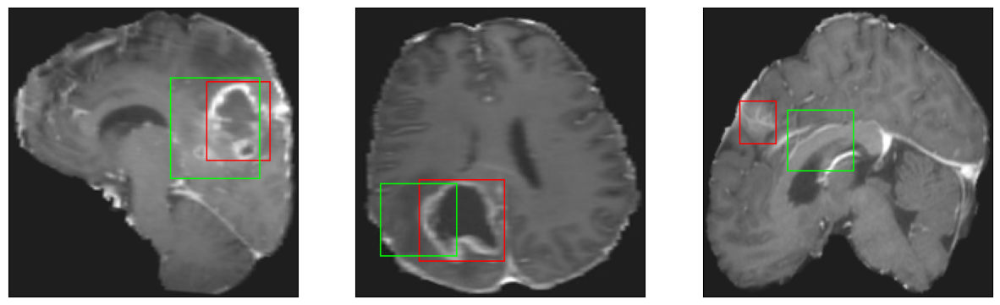

26/26 [==============================] - 14s 549ms/step - loss: 12.6383 - IoU: 0.3281 - val_loss: 14.4943 - val_IoU: 0.3435
Epoch 15/200
26/26 [==============================] - ETA: 0s - loss: 12.7220 - IoU: 0.3220
Epoch 15: val_loss did not improve from 14.49431
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 47ms/step
4


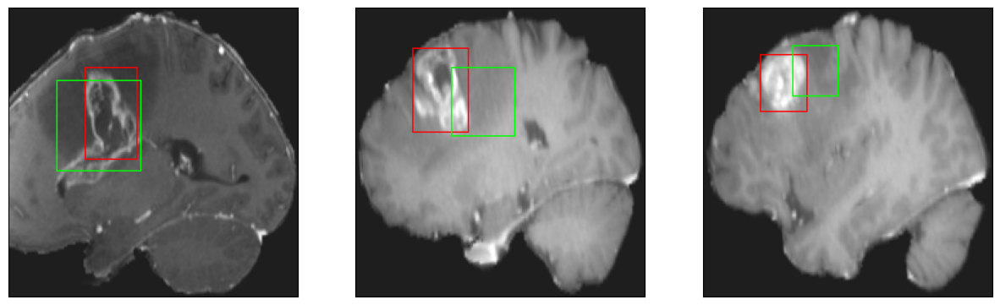

26/26 [==============================] - 8s 313ms/step - loss: 12.7220 - IoU: 0.3220 - val_loss: 15.6635 - val_IoU: 0.2952
Epoch 16/200
26/26 [==============================] - ETA: 0s - loss: 13.1904 - IoU: 0.3181
Epoch 16: val_loss improved from 14.49431 to 14.06057, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 45ms/step
4


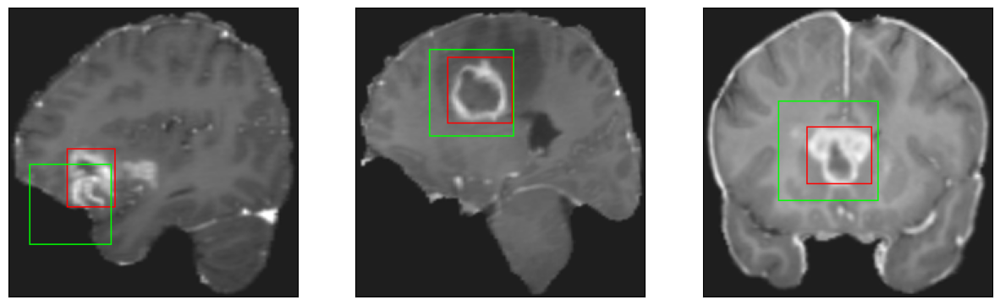

26/26 [==============================] - 14s 561ms/step - loss: 13.1904 - IoU: 0.3181 - val_loss: 14.0606 - val_IoU: 0.3596
Epoch 17/200
26/26 [==============================] - ETA: 0s - loss: 11.9862 - IoU: 0.3409
Epoch 17: val_loss improved from 14.06057 to 13.54510, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


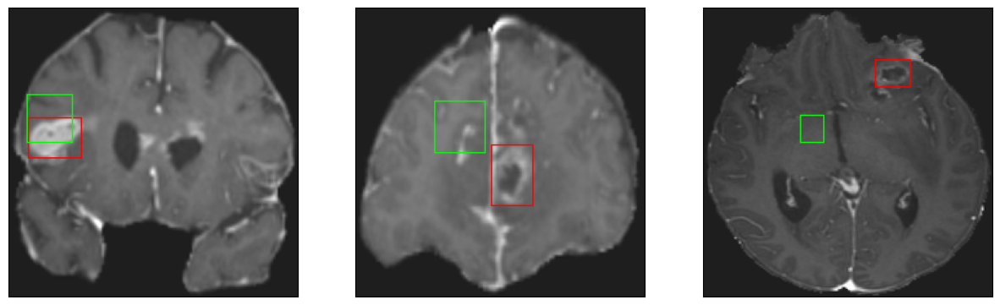

26/26 [==============================] - 13s 515ms/step - loss: 11.9862 - IoU: 0.3409 - val_loss: 13.5451 - val_IoU: 0.3282
Epoch 18/200
26/26 [==============================] - ETA: 0s - loss: 11.8012 - IoU: 0.3467
Epoch 18: val_loss did not improve from 13.54510
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 47ms/step
4
8/8 [==============================] - 0s 44ms/step
4


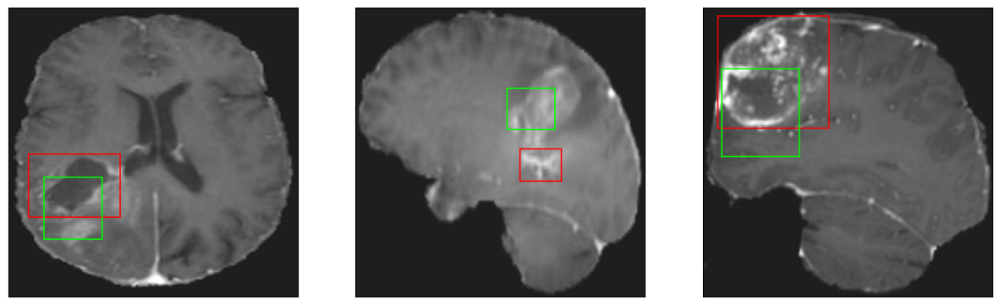

26/26 [==============================] - 8s 296ms/step - loss: 11.8012 - IoU: 0.3467 - val_loss: 13.8870 - val_IoU: 0.3082
Epoch 19/200
26/26 [==============================] - ETA: 0s - loss: 13.2350 - IoU: 0.3001
Epoch 19: val_loss did not improve from 13.54510
8/8 [==============================] - 0s 47ms/step
4
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 48ms/step
4


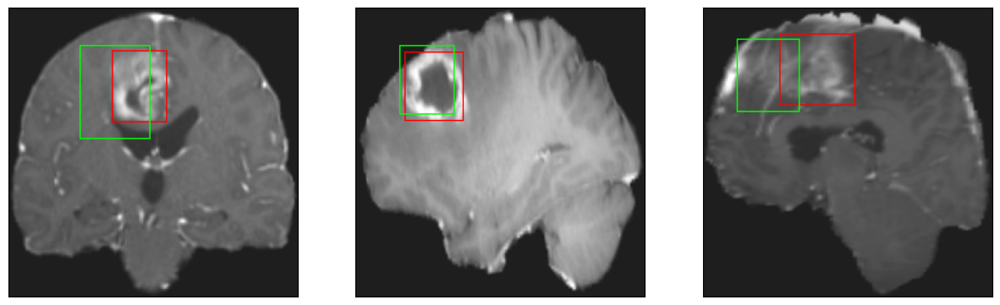

26/26 [==============================] - 8s 313ms/step - loss: 13.2350 - IoU: 0.3001 - val_loss: 14.6014 - val_IoU: 0.2913
Epoch 20/200
26/26 [==============================] - ETA: 0s - loss: 12.0048 - IoU: 0.3357
Epoch 20: val_loss did not improve from 13.54510
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


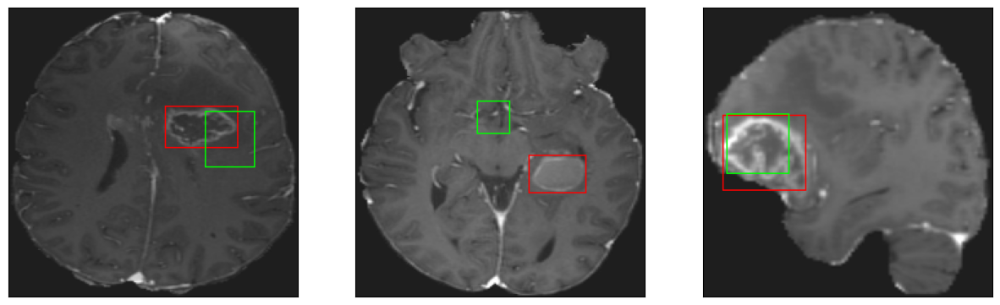

26/26 [==============================] - 7s 274ms/step - loss: 12.0048 - IoU: 0.3357 - val_loss: 17.6110 - val_IoU: 0.2454
Epoch 21/200
26/26 [==============================] - ETA: 0s - loss: 12.1889 - IoU: 0.3334
Epoch 21: val_loss improved from 13.54510 to 11.79383, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 48ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 43ms/step
4


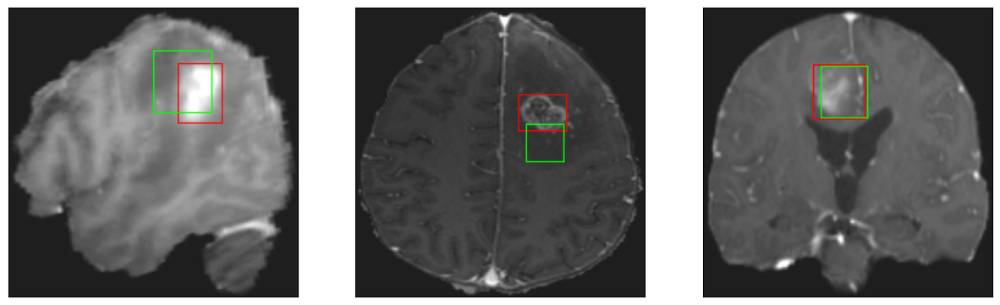

26/26 [==============================] - 18s 719ms/step - loss: 12.1889 - IoU: 0.3334 - val_loss: 11.7938 - val_IoU: 0.3996
Epoch 22/200
26/26 [==============================] - ETA: 0s - loss: 11.8814 - IoU: 0.3449
Epoch 22: val_loss did not improve from 11.79383
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 44ms/step
4


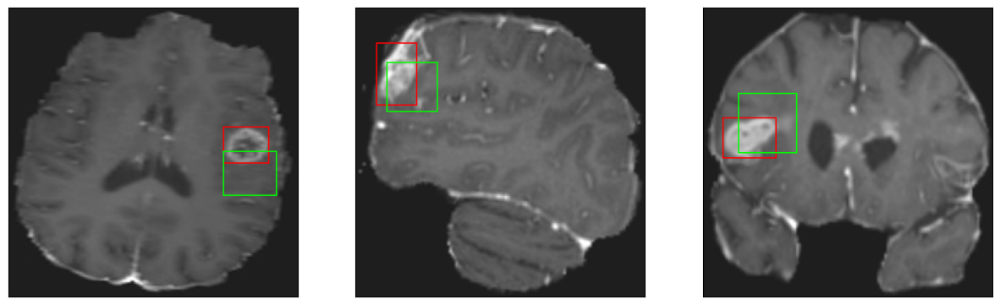

26/26 [==============================] - 8s 301ms/step - loss: 11.8814 - IoU: 0.3449 - val_loss: 12.9289 - val_IoU: 0.3549
Epoch 23/200
26/26 [==============================] - ETA: 0s - loss: 10.9790 - IoU: 0.3786
Epoch 23: val_loss did not improve from 11.79383
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 44ms/step
4


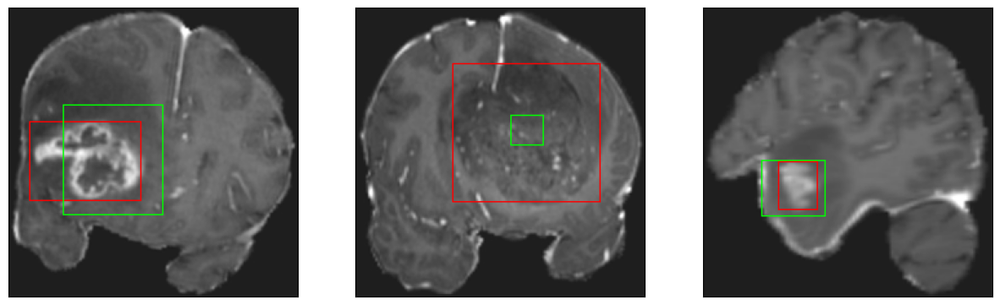

26/26 [==============================] - 8s 309ms/step - loss: 10.9790 - IoU: 0.3786 - val_loss: 12.5187 - val_IoU: 0.3838
Epoch 24/200
26/26 [==============================] - ETA: 0s - loss: 10.9003 - IoU: 0.3763
Epoch 24: val_loss did not improve from 11.79383
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 44ms/step
4


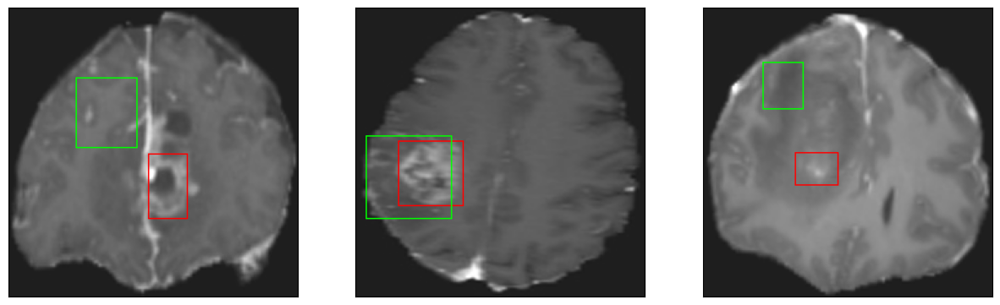

26/26 [==============================] - 8s 304ms/step - loss: 10.9003 - IoU: 0.3763 - val_loss: 20.2824 - val_IoU: 0.2168
Epoch 25/200
26/26 [==============================] - ETA: 0s - loss: 10.6529 - IoU: 0.3868
Epoch 25: val_loss did not improve from 11.79383
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 40ms/step
4


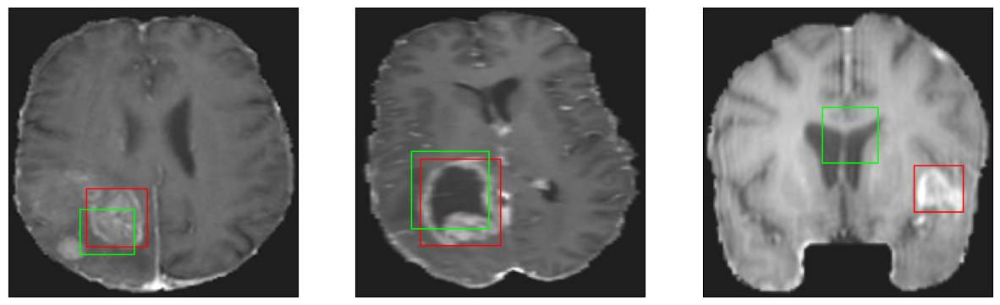

26/26 [==============================] - 7s 289ms/step - loss: 10.6529 - IoU: 0.3868 - val_loss: 12.9988 - val_IoU: 0.3396
Epoch 26/200
26/26 [==============================] - ETA: 0s - loss: 10.6799 - IoU: 0.3801
Epoch 26: val_loss improved from 11.79383 to 11.04163, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


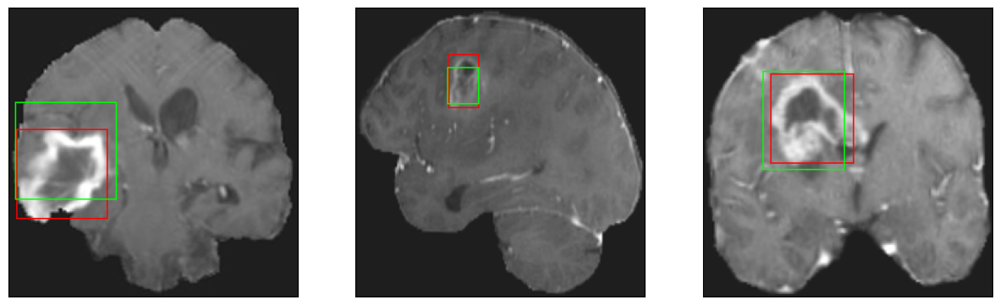

26/26 [==============================] - 18s 705ms/step - loss: 10.6799 - IoU: 0.3801 - val_loss: 11.0416 - val_IoU: 0.4121
Epoch 27/200
26/26 [==============================] - ETA: 0s - loss: 10.5006 - IoU: 0.3868
Epoch 27: val_loss did not improve from 11.04163
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 43ms/step
4


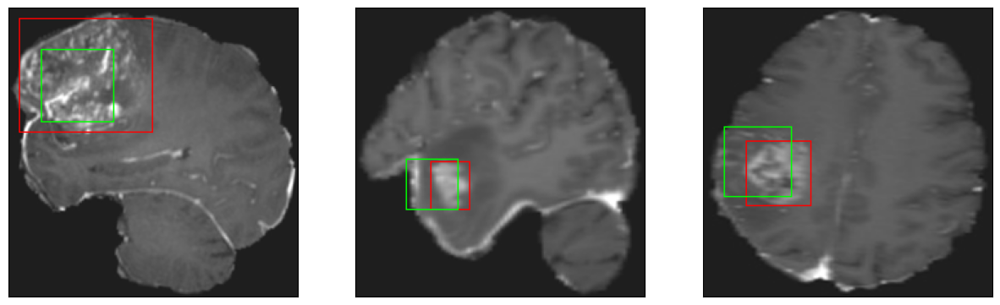

26/26 [==============================] - 8s 290ms/step - loss: 10.5006 - IoU: 0.3868 - val_loss: 13.4330 - val_IoU: 0.3162
Epoch 28/200
26/26 [==============================] - ETA: 0s - loss: 10.5422 - IoU: 0.3836
Epoch 28: val_loss did not improve from 11.04163
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 44ms/step
4


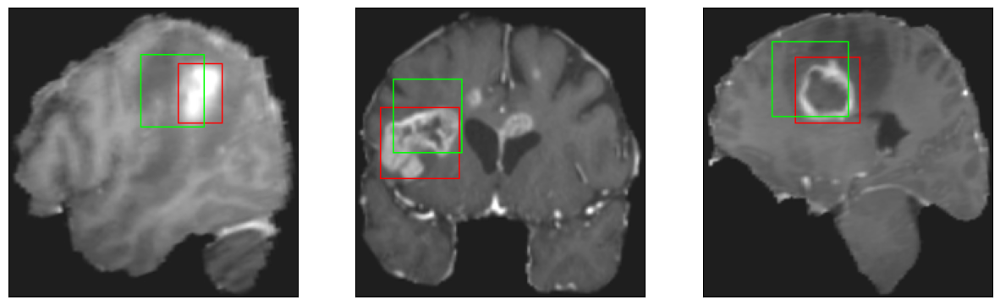

26/26 [==============================] - 8s 323ms/step - loss: 10.5422 - IoU: 0.3836 - val_loss: 12.7514 - val_IoU: 0.3562
Epoch 29/200
26/26 [==============================] - ETA: 0s - loss: 10.3959 - IoU: 0.3810
Epoch 29: val_loss did not improve from 11.04163
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


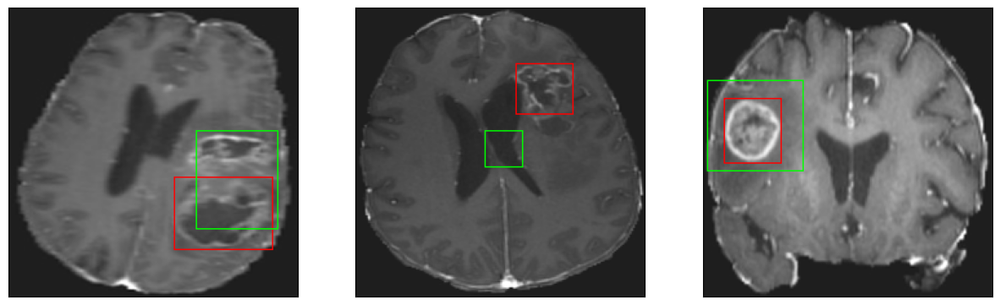

26/26 [==============================] - 8s 301ms/step - loss: 10.3959 - IoU: 0.3810 - val_loss: 14.0351 - val_IoU: 0.3882
Epoch 30/200
26/26 [==============================] - ETA: 0s - loss: 10.0716 - IoU: 0.3952
Epoch 30: val_loss did not improve from 11.04163
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


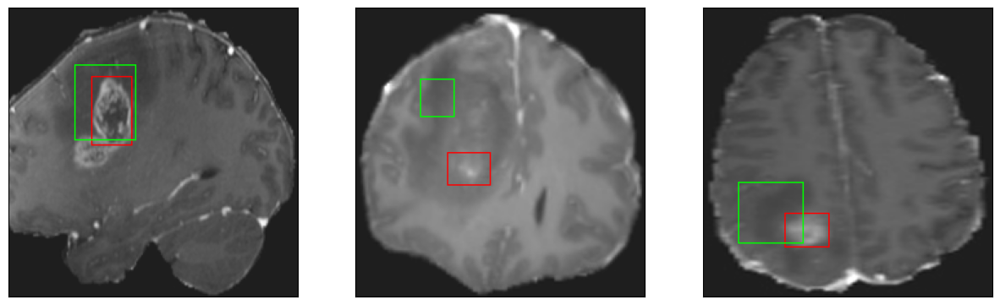

26/26 [==============================] - 7s 287ms/step - loss: 10.0716 - IoU: 0.3952 - val_loss: 13.6033 - val_IoU: 0.3336
Epoch 31/200
26/26 [==============================] - ETA: 0s - loss: 10.2936 - IoU: 0.3878
Epoch 31: val_loss did not improve from 11.04163
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 44ms/step
4


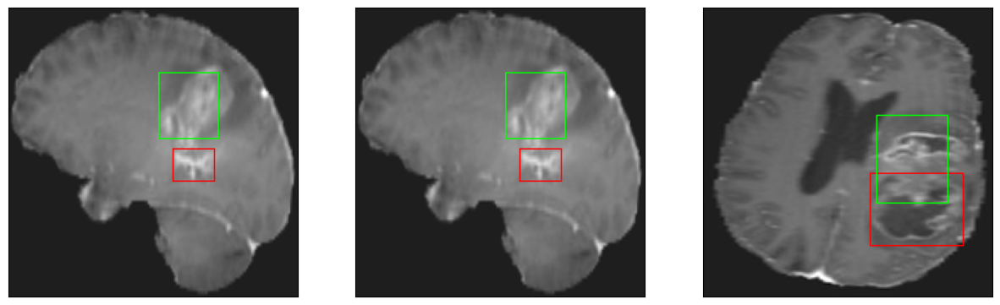

26/26 [==============================] - 7s 290ms/step - loss: 10.2936 - IoU: 0.3878 - val_loss: 12.4120 - val_IoU: 0.3958
Epoch 32/200
26/26 [==============================] - ETA: 0s - loss: 9.7406 - IoU: 0.4057
Epoch 32: val_loss did not improve from 11.04163
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


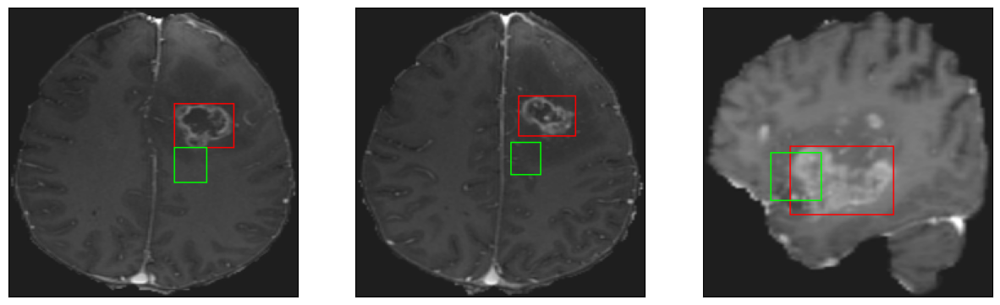

26/26 [==============================] - 7s 289ms/step - loss: 9.7406 - IoU: 0.4057 - val_loss: 13.2414 - val_IoU: 0.3720
Epoch 33/200
26/26 [==============================] - ETA: 0s - loss: 9.2603 - IoU: 0.4305
Epoch 33: val_loss did not improve from 11.04163
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 44ms/step
4


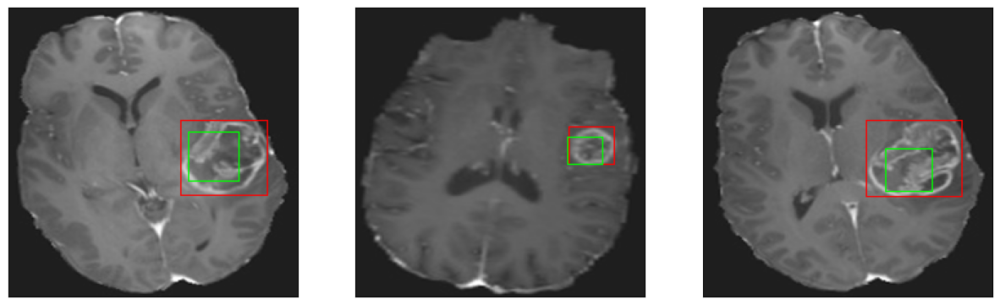

26/26 [==============================] - 8s 300ms/step - loss: 9.2603 - IoU: 0.4305 - val_loss: 12.7844 - val_IoU: 0.3697
Epoch 34/200
26/26 [==============================] - ETA: 0s - loss: 9.6518 - IoU: 0.3994
Epoch 34: val_loss did not improve from 11.04163
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


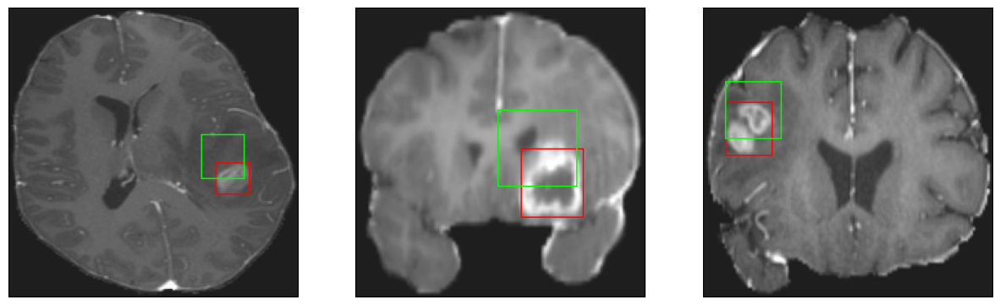

26/26 [==============================] - 7s 288ms/step - loss: 9.6518 - IoU: 0.3994 - val_loss: 15.4949 - val_IoU: 0.2733
Epoch 35/200
26/26 [==============================] - ETA: 0s - loss: 10.0594 - IoU: 0.3924
Epoch 35: val_loss did not improve from 11.04163
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 44ms/step
4


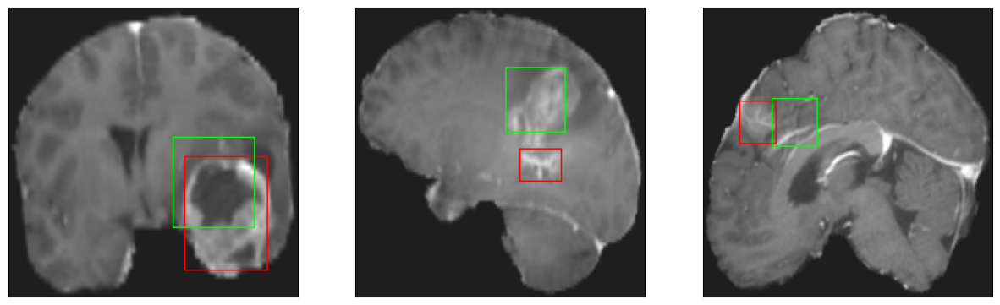

26/26 [==============================] - 8s 294ms/step - loss: 10.0594 - IoU: 0.3924 - val_loss: 14.9066 - val_IoU: 0.3140
Epoch 36/200
26/26 [==============================] - ETA: 0s - loss: 9.5102 - IoU: 0.4096
Epoch 36: val_loss did not improve from 11.04163
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


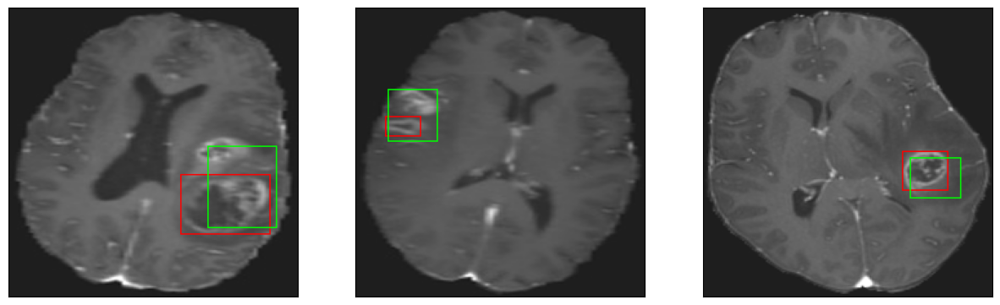

26/26 [==============================] - 7s 279ms/step - loss: 9.5102 - IoU: 0.4096 - val_loss: 12.8009 - val_IoU: 0.4222
Epoch 37/200
26/26 [==============================] - ETA: 0s - loss: 9.7565 - IoU: 0.4078
Epoch 37: val_loss did not improve from 11.04163
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


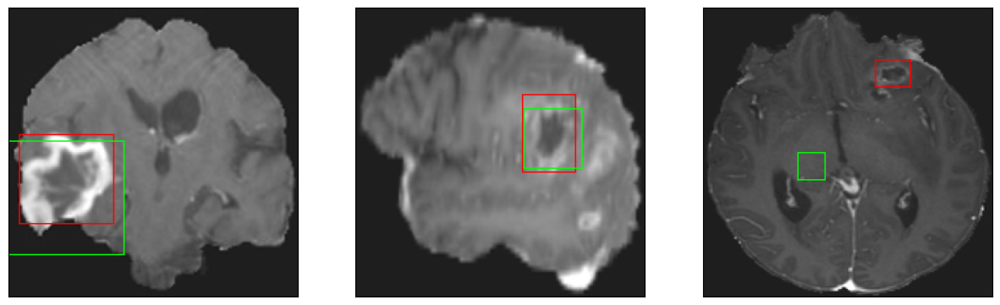

26/26 [==============================] - 8s 300ms/step - loss: 9.7565 - IoU: 0.4078 - val_loss: 13.3296 - val_IoU: 0.3919
Epoch 38/200
26/26 [==============================] - ETA: 0s - loss: 9.4518 - IoU: 0.4105
Epoch 38: val_loss did not improve from 11.04163
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 44ms/step
4


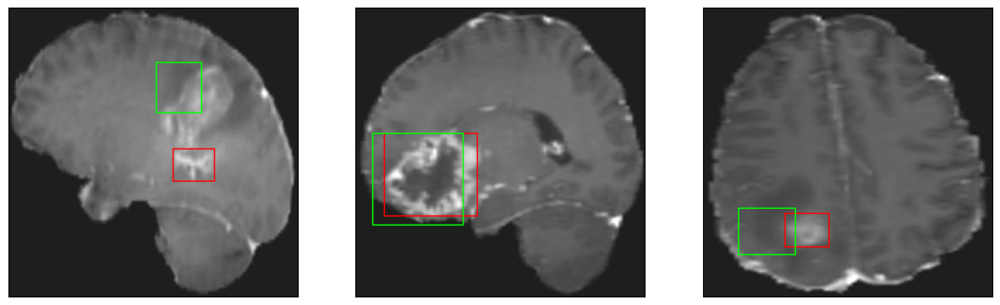

26/26 [==============================] - 8s 296ms/step - loss: 9.4518 - IoU: 0.4105 - val_loss: 12.4167 - val_IoU: 0.3642
Epoch 39/200
26/26 [==============================] - ETA: 0s - loss: 9.4571 - IoU: 0.4082
Epoch 39: val_loss did not improve from 11.04163
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


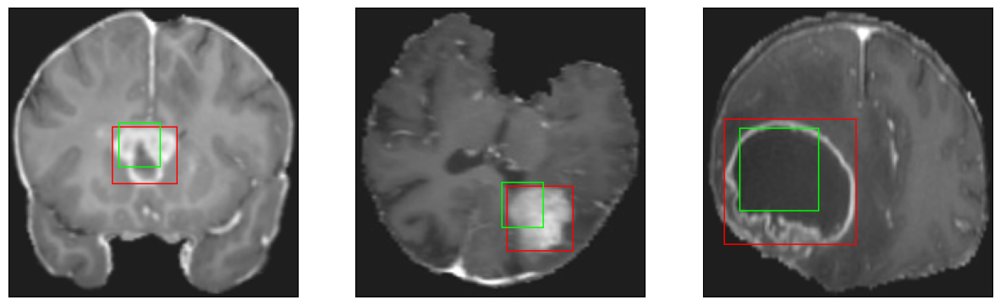

26/26 [==============================] - 7s 290ms/step - loss: 9.4571 - IoU: 0.4082 - val_loss: 13.5596 - val_IoU: 0.3887
Epoch 40/200
26/26 [==============================] - ETA: 0s - loss: 8.9486 - IoU: 0.4320
Epoch 40: val_loss did not improve from 11.04163
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 43ms/step
4


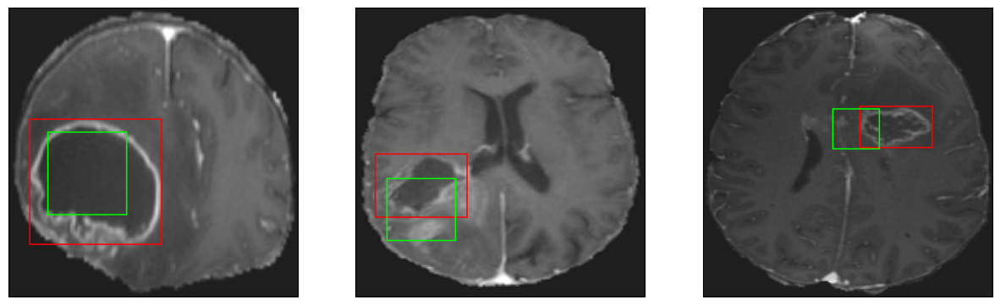

26/26 [==============================] - 8s 303ms/step - loss: 8.9486 - IoU: 0.4320 - val_loss: 13.5541 - val_IoU: 0.3475
Epoch 41/200
26/26 [==============================] - ETA: 0s - loss: 8.7557 - IoU: 0.4415
Epoch 41: val_loss did not improve from 11.04163
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


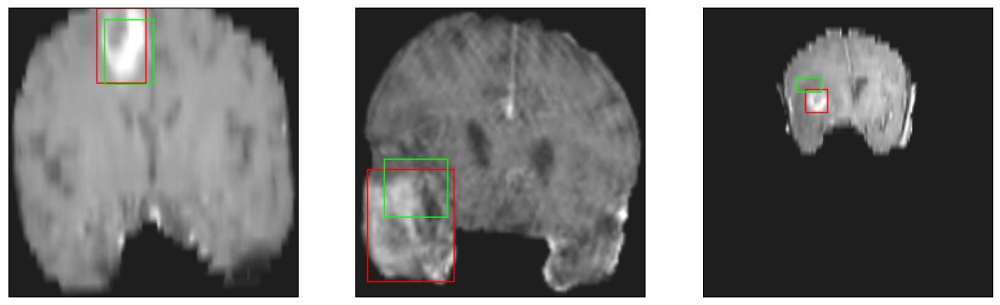

26/26 [==============================] - 7s 272ms/step - loss: 8.7557 - IoU: 0.4415 - val_loss: 13.0619 - val_IoU: 0.3198
Epoch 42/200
26/26 [==============================] - ETA: 0s - loss: 9.2557 - IoU: 0.4214
Epoch 42: val_loss did not improve from 11.04163
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


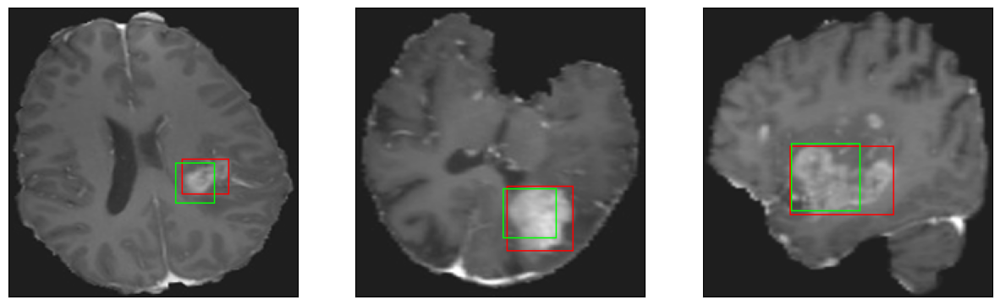

26/26 [==============================] - 7s 270ms/step - loss: 9.2557 - IoU: 0.4214 - val_loss: 12.1480 - val_IoU: 0.4098
Epoch 43/200
26/26 [==============================] - ETA: 0s - loss: 9.0526 - IoU: 0.4285
Epoch 43: val_loss did not improve from 11.04163
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


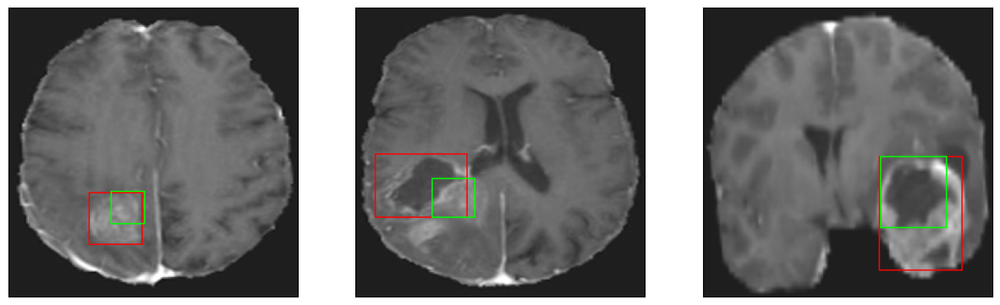

26/26 [==============================] - 8s 298ms/step - loss: 9.0526 - IoU: 0.4285 - val_loss: 15.8882 - val_IoU: 0.3210
Epoch 44/200
26/26 [==============================] - ETA: 0s - loss: 8.8125 - IoU: 0.4350
Epoch 44: val_loss did not improve from 11.04163
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


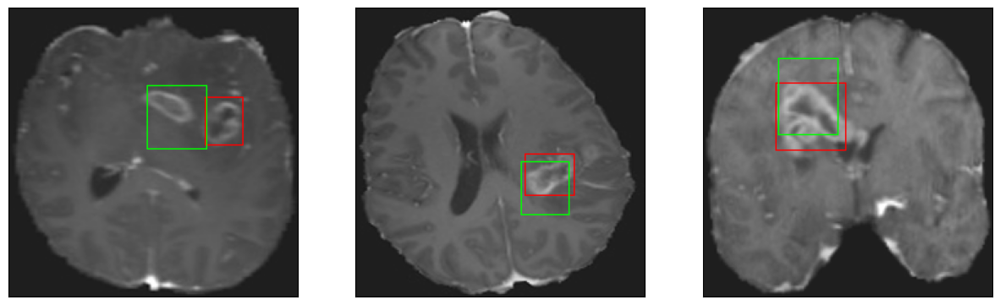

26/26 [==============================] - 7s 289ms/step - loss: 8.8125 - IoU: 0.4350 - val_loss: 14.1946 - val_IoU: 0.3605
Epoch 45/200
26/26 [==============================] - ETA: 0s - loss: 8.9642 - IoU: 0.4234
Epoch 45: val_loss did not improve from 11.04163
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


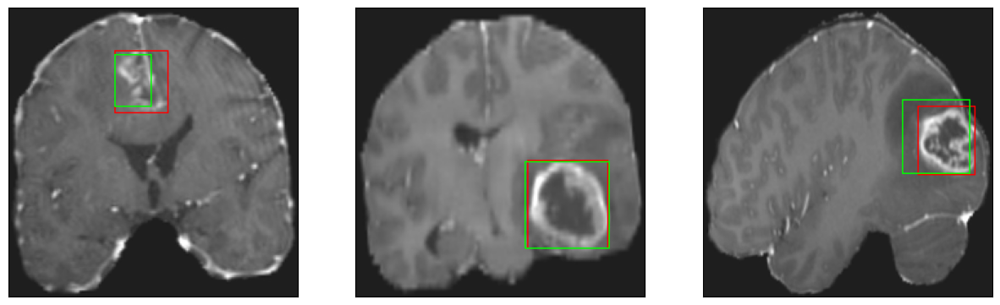

26/26 [==============================] - 7s 281ms/step - loss: 8.9642 - IoU: 0.4234 - val_loss: 11.5401 - val_IoU: 0.4439
Epoch 46/200
26/26 [==============================] - ETA: 0s - loss: 8.9918 - IoU: 0.4324
Epoch 46: val_loss improved from 11.04163 to 10.35386, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


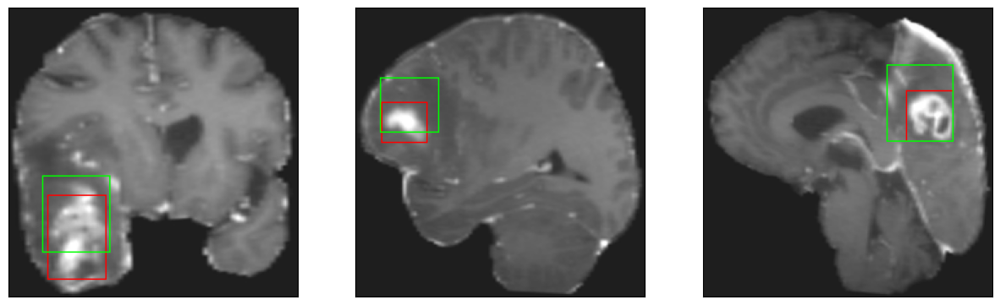

26/26 [==============================] - 17s 685ms/step - loss: 8.9918 - IoU: 0.4324 - val_loss: 10.3539 - val_IoU: 0.4478
Epoch 47/200
26/26 [==============================] - ETA: 0s - loss: 8.4484 - IoU: 0.4475
Epoch 47: val_loss did not improve from 10.35386
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


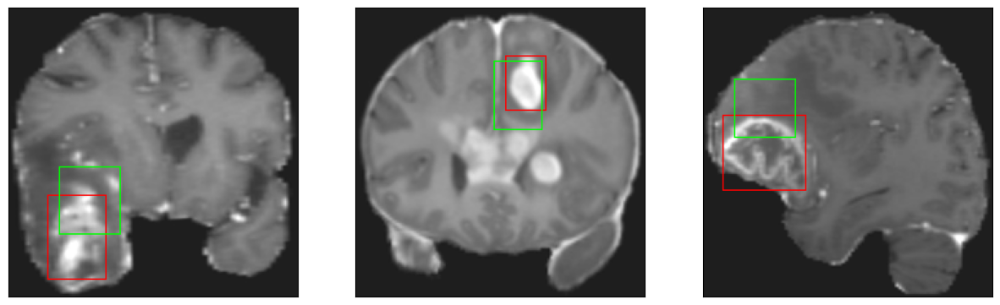

26/26 [==============================] - 7s 287ms/step - loss: 8.4484 - IoU: 0.4475 - val_loss: 14.1432 - val_IoU: 0.2687
Epoch 48/200
26/26 [==============================] - ETA: 0s - loss: 8.3239 - IoU: 0.4530
Epoch 48: val_loss did not improve from 10.35386
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 43ms/step
4


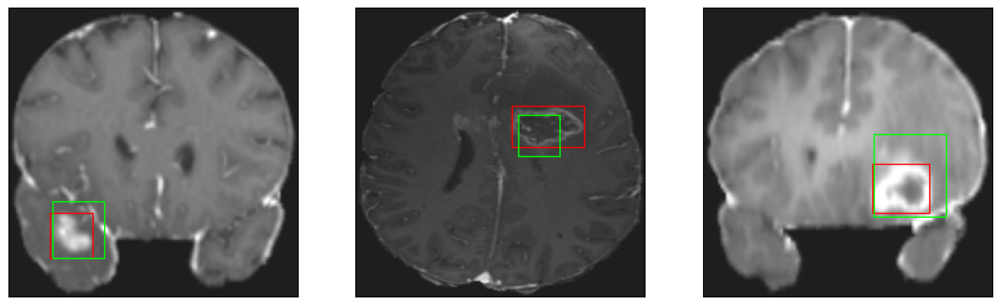

26/26 [==============================] - 9s 359ms/step - loss: 8.3239 - IoU: 0.4530 - val_loss: 10.4646 - val_IoU: 0.4438
Epoch 49/200
26/26 [==============================] - ETA: 0s - loss: 8.7740 - IoU: 0.4336
Epoch 49: val_loss did not improve from 10.35386
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


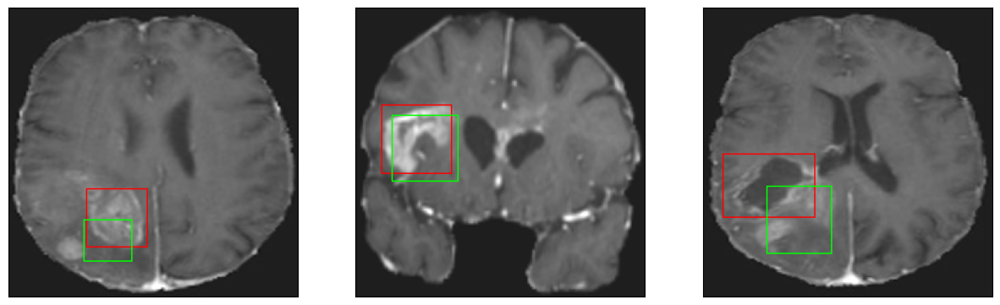

26/26 [==============================] - 8s 303ms/step - loss: 8.7740 - IoU: 0.4336 - val_loss: 10.9504 - val_IoU: 0.4257
Epoch 50/200
26/26 [==============================] - ETA: 0s - loss: 8.5238 - IoU: 0.4431
Epoch 50: val_loss did not improve from 10.35386
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 45ms/step
4


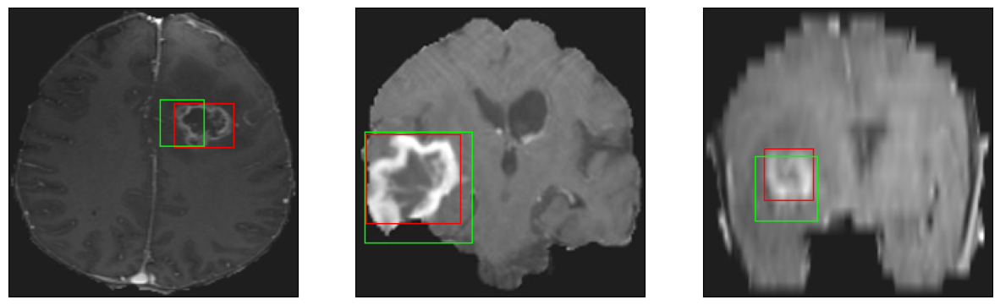

26/26 [==============================] - 8s 307ms/step - loss: 8.5238 - IoU: 0.4431 - val_loss: 11.5995 - val_IoU: 0.4190
Epoch 51/200
26/26 [==============================] - ETA: 0s - loss: 8.7629 - IoU: 0.4373
Epoch 51: val_loss did not improve from 10.35386
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


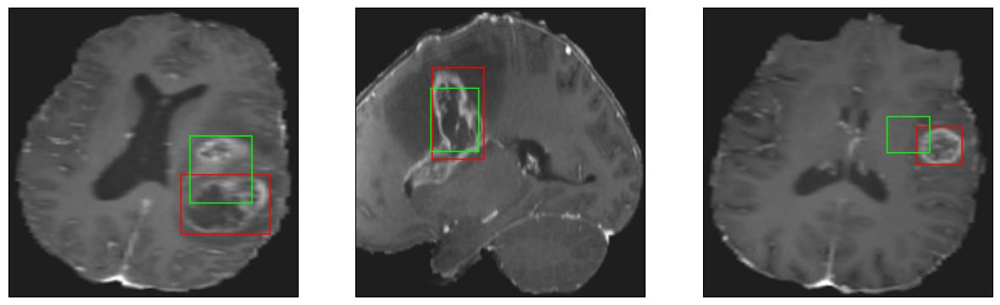

26/26 [==============================] - 8s 299ms/step - loss: 8.7629 - IoU: 0.4373 - val_loss: 13.2010 - val_IoU: 0.3214
Epoch 52/200
26/26 [==============================] - ETA: 0s - loss: 8.3380 - IoU: 0.4529
Epoch 52: val_loss did not improve from 10.35386
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


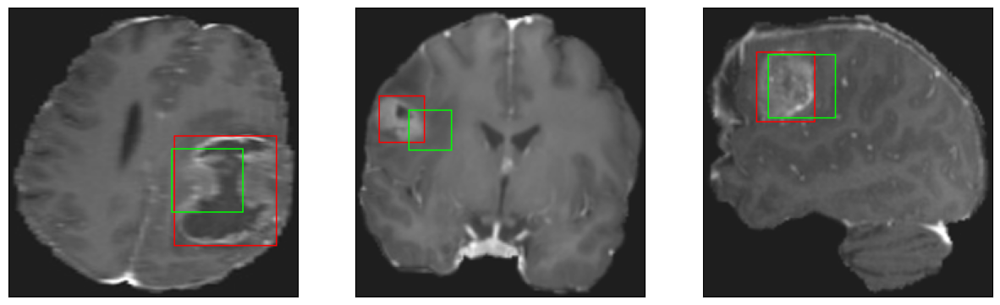

26/26 [==============================] - 7s 289ms/step - loss: 8.3380 - IoU: 0.4529 - val_loss: 11.3597 - val_IoU: 0.4206
Epoch 53/200
26/26 [==============================] - ETA: 0s - loss: 8.4694 - IoU: 0.4500
Epoch 53: val_loss did not improve from 10.35386
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 46ms/step
4


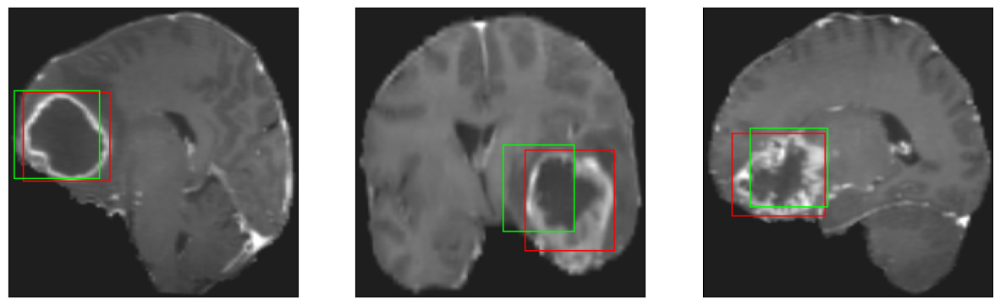

26/26 [==============================] - 8s 297ms/step - loss: 8.4694 - IoU: 0.4500 - val_loss: 12.3398 - val_IoU: 0.3718
Epoch 54/200
26/26 [==============================] - ETA: 0s - loss: 8.9060 - IoU: 0.4355
Epoch 54: val_loss did not improve from 10.35386
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


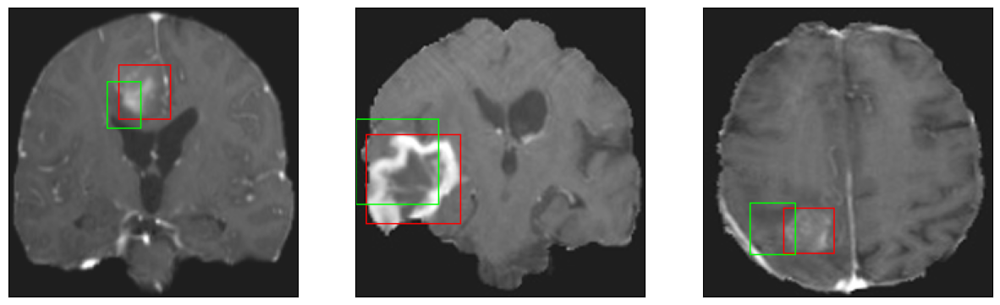

26/26 [==============================] - 8s 300ms/step - loss: 8.9060 - IoU: 0.4355 - val_loss: 12.8904 - val_IoU: 0.3516
Epoch 55/200
26/26 [==============================] - ETA: 0s - loss: 8.5289 - IoU: 0.4396
Epoch 55: val_loss did not improve from 10.35386
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 42ms/step
4


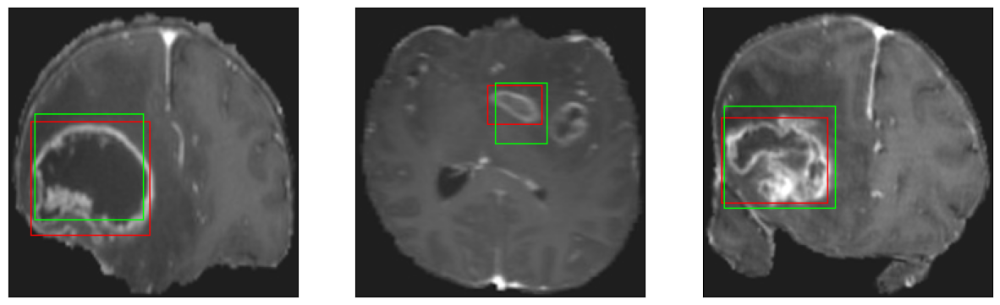

26/26 [==============================] - 8s 293ms/step - loss: 8.5289 - IoU: 0.4396 - val_loss: 12.8729 - val_IoU: 0.3822
Epoch 56/200
26/26 [==============================] - ETA: 0s - loss: 7.8534 - IoU: 0.4795
Epoch 56: val_loss did not improve from 10.35386
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4


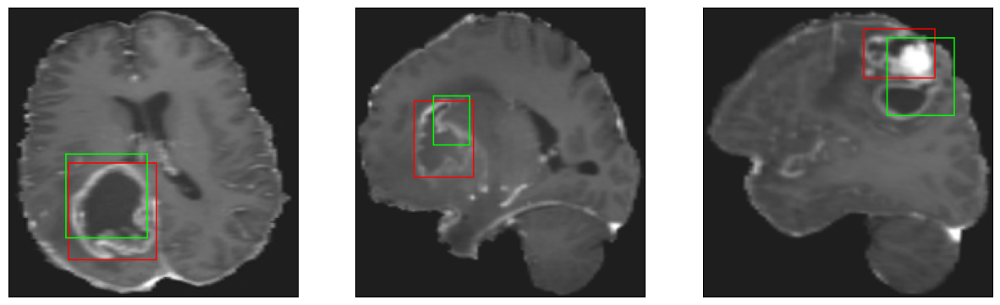

26/26 [==============================] - 8s 291ms/step - loss: 7.8534 - IoU: 0.4795 - val_loss: 12.6488 - val_IoU: 0.3774
Epoch 57/200
26/26 [==============================] - ETA: 0s - loss: 7.8169 - IoU: 0.4636
Epoch 57: val_loss did not improve from 10.35386
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 45ms/step
4


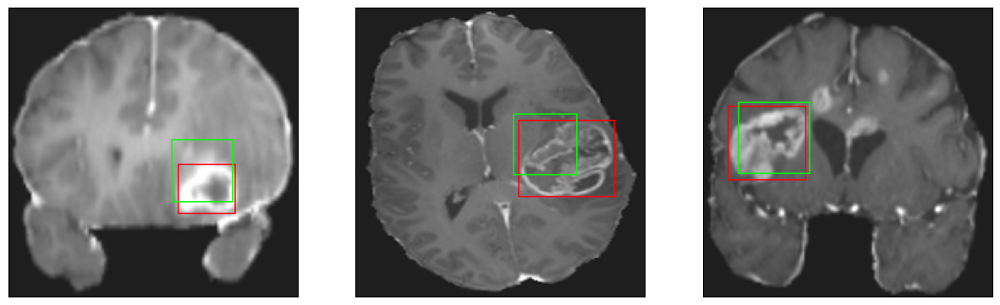

26/26 [==============================] - 8s 321ms/step - loss: 7.8169 - IoU: 0.4636 - val_loss: 11.9088 - val_IoU: 0.3981
Epoch 58/200
26/26 [==============================] - ETA: 0s - loss: 8.3617 - IoU: 0.4461
Epoch 58: val_loss did not improve from 10.35386
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


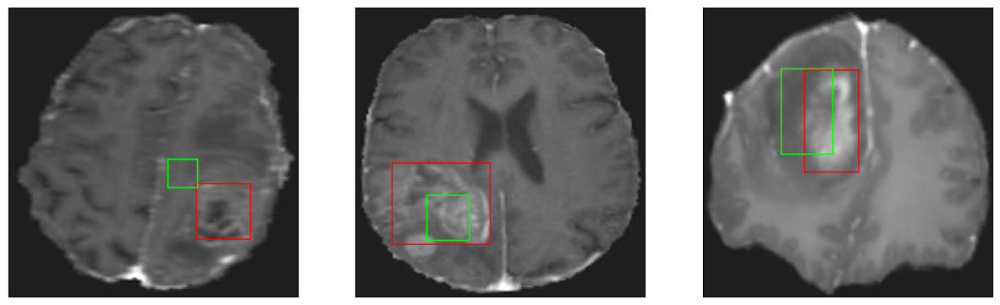

26/26 [==============================] - 7s 277ms/step - loss: 8.3617 - IoU: 0.4461 - val_loss: 11.4322 - val_IoU: 0.3958
Epoch 59/200
26/26 [==============================] - ETA: 0s - loss: 8.4489 - IoU: 0.4350
Epoch 59: val_loss did not improve from 10.35386
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 42ms/step
4


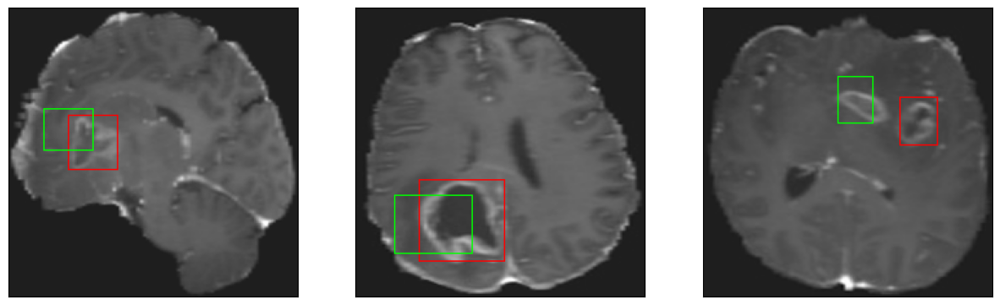

26/26 [==============================] - 8s 322ms/step - loss: 8.4489 - IoU: 0.4350 - val_loss: 12.7354 - val_IoU: 0.3787
Epoch 60/200
26/26 [==============================] - ETA: 0s - loss: 8.4634 - IoU: 0.4437
Epoch 60: val_loss did not improve from 10.35386
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


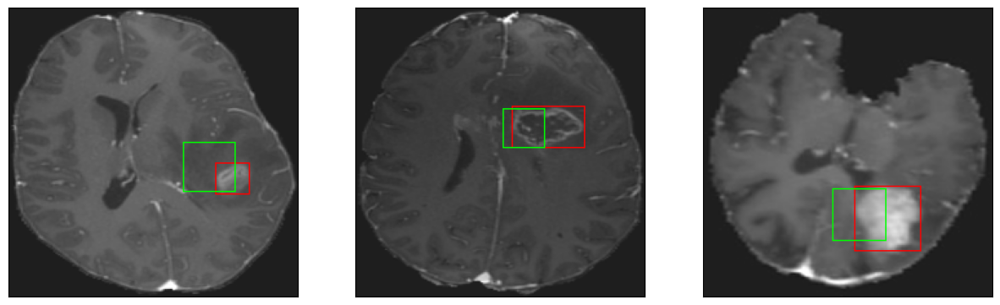

26/26 [==============================] - 8s 293ms/step - loss: 8.4634 - IoU: 0.4437 - val_loss: 11.6067 - val_IoU: 0.3951
Epoch 61/200
26/26 [==============================] - ETA: 0s - loss: 8.1052 - IoU: 0.4568
Epoch 61: val_loss did not improve from 10.35386
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 42ms/step
4


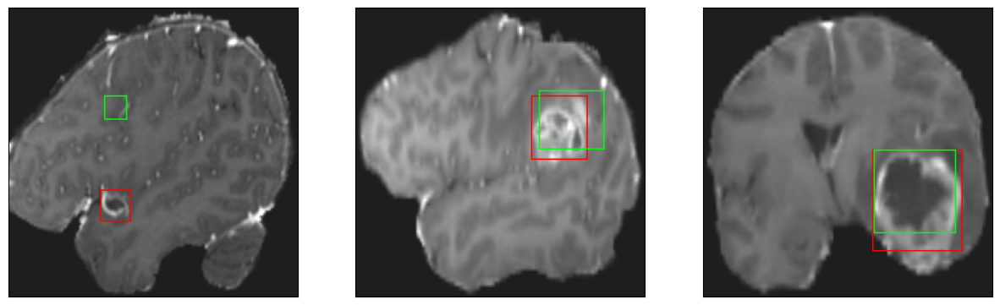

26/26 [==============================] - 8s 316ms/step - loss: 8.1052 - IoU: 0.4568 - val_loss: 11.6229 - val_IoU: 0.3715
Epoch 62/200
26/26 [==============================] - ETA: 0s - loss: 7.8221 - IoU: 0.4621
Epoch 62: val_loss did not improve from 10.35386
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


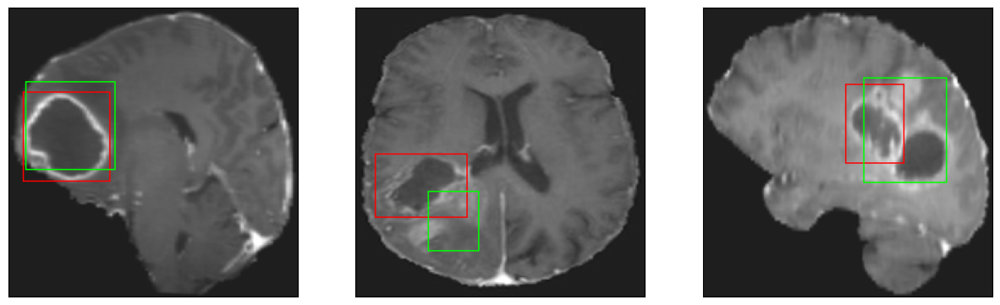

26/26 [==============================] - 7s 283ms/step - loss: 7.8221 - IoU: 0.4621 - val_loss: 10.6615 - val_IoU: 0.4412
Epoch 63/200
26/26 [==============================] - ETA: 0s - loss: 8.2447 - IoU: 0.4461
Epoch 63: val_loss did not improve from 10.35386
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 43ms/step
4


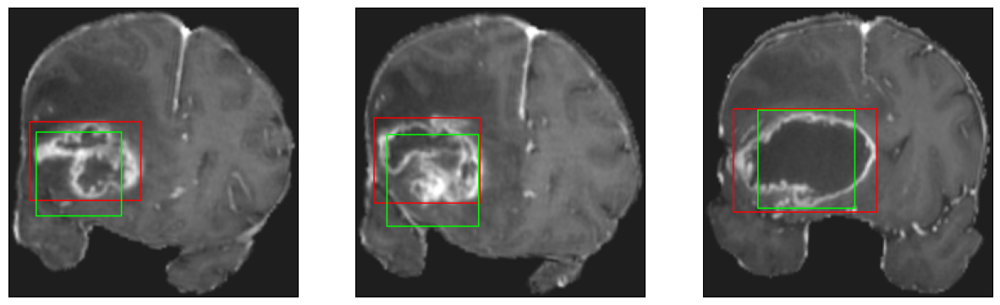

26/26 [==============================] - 8s 313ms/step - loss: 8.2447 - IoU: 0.4461 - val_loss: 10.4811 - val_IoU: 0.4373
Epoch 64/200
26/26 [==============================] - ETA: 0s - loss: 7.8207 - IoU: 0.4648
Epoch 64: val_loss did not improve from 10.35386
8/8 [==============================] - 0s 47ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 46ms/step
4


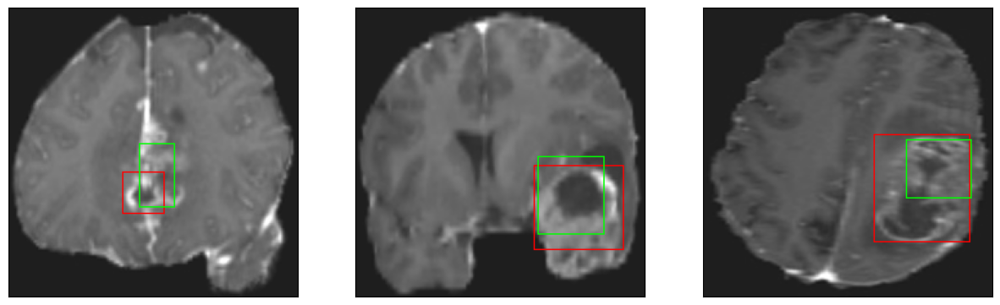

26/26 [==============================] - 8s 308ms/step - loss: 7.8207 - IoU: 0.4648 - val_loss: 11.4365 - val_IoU: 0.3780
Epoch 65/200
26/26 [==============================] - ETA: 0s - loss: 8.0672 - IoU: 0.4493
Epoch 65: val_loss did not improve from 10.35386
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4


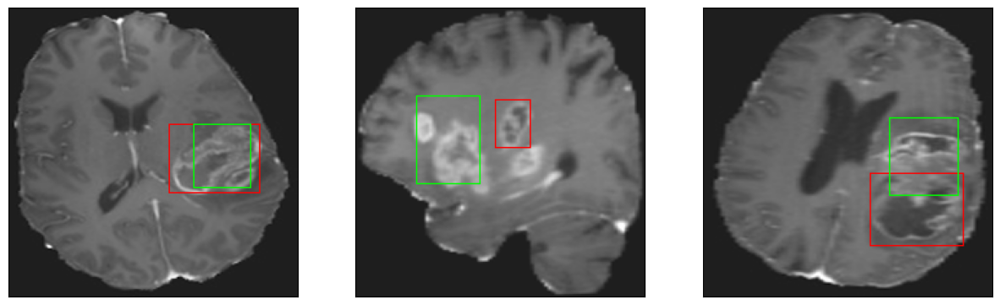

26/26 [==============================] - 7s 273ms/step - loss: 8.0672 - IoU: 0.4493 - val_loss: 12.2452 - val_IoU: 0.3859
Epoch 66/200
26/26 [==============================] - ETA: 0s - loss: 7.5537 - IoU: 0.4744
Epoch 66: val_loss did not improve from 10.35386
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 46ms/step
4


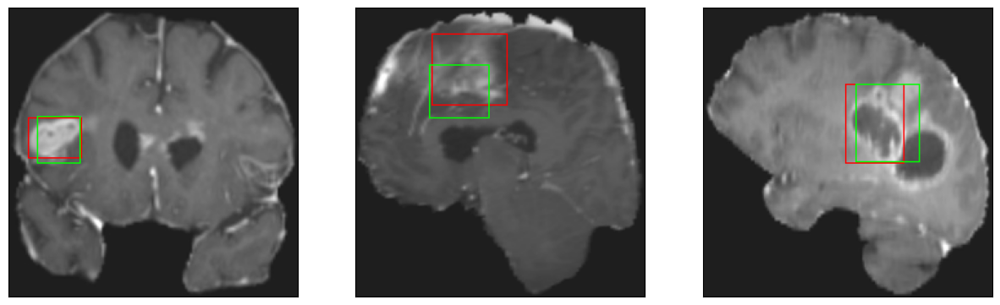

26/26 [==============================] - 8s 309ms/step - loss: 7.5537 - IoU: 0.4744 - val_loss: 11.0716 - val_IoU: 0.3995
Epoch 67/200
26/26 [==============================] - ETA: 0s - loss: 7.3735 - IoU: 0.4758
Epoch 67: val_loss improved from 10.35386 to 9.97763, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


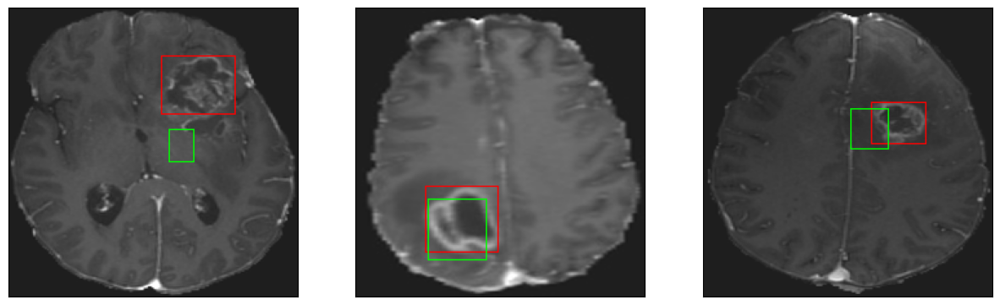

26/26 [==============================] - 17s 675ms/step - loss: 7.3735 - IoU: 0.4758 - val_loss: 9.9776 - val_IoU: 0.4654
Epoch 68/200
26/26 [==============================] - ETA: 0s - loss: 7.5872 - IoU: 0.4672
Epoch 68: val_loss did not improve from 9.97763
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 44ms/step
4


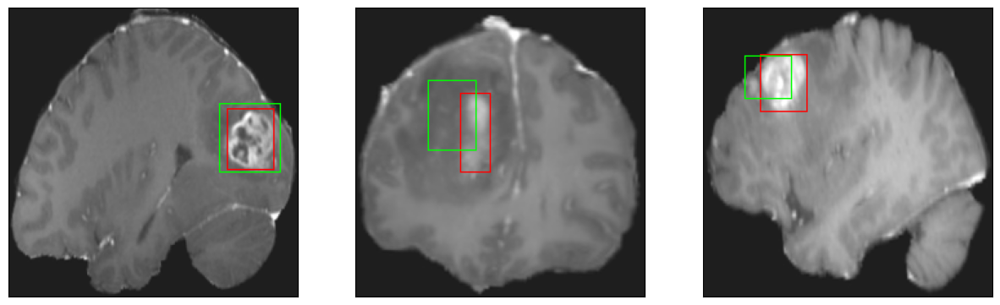

26/26 [==============================] - 9s 338ms/step - loss: 7.5872 - IoU: 0.4672 - val_loss: 10.0977 - val_IoU: 0.4417
Epoch 69/200
26/26 [==============================] - ETA: 0s - loss: 7.7048 - IoU: 0.4636
Epoch 69: val_loss did not improve from 9.97763
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 48ms/step
4


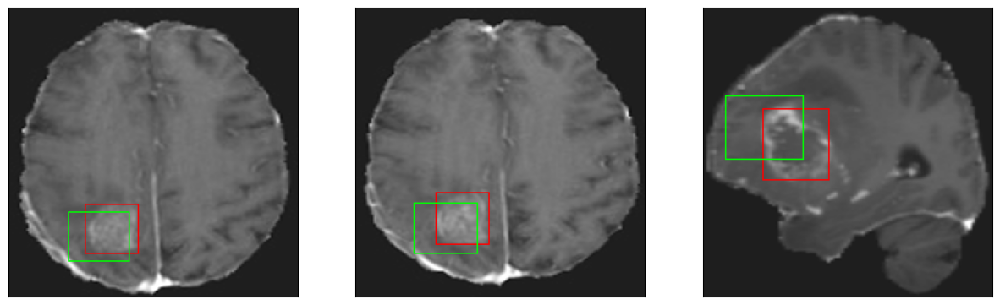

26/26 [==============================] - 9s 334ms/step - loss: 7.7048 - IoU: 0.4636 - val_loss: 11.9666 - val_IoU: 0.3842
Epoch 70/200
26/26 [==============================] - ETA: 0s - loss: 7.8529 - IoU: 0.4589
Epoch 70: val_loss did not improve from 9.97763
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 45ms/step
4


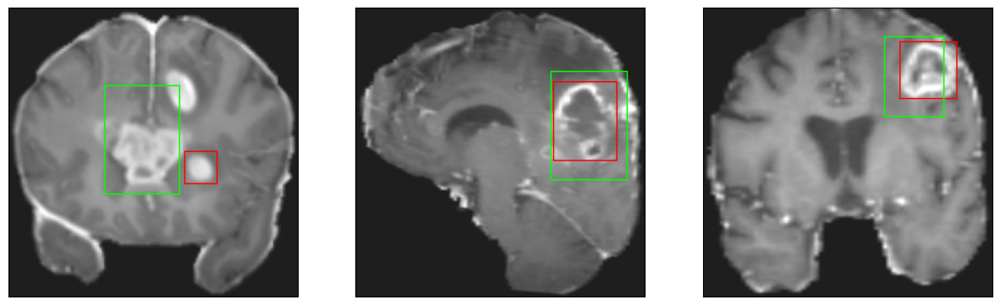

26/26 [==============================] - 8s 313ms/step - loss: 7.8529 - IoU: 0.4589 - val_loss: 10.5490 - val_IoU: 0.4549
Epoch 71/200
26/26 [==============================] - ETA: 0s - loss: 7.9790 - IoU: 0.4525
Epoch 71: val_loss did not improve from 9.97763
8/8 [==============================] - 0s 47ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 43ms/step
4


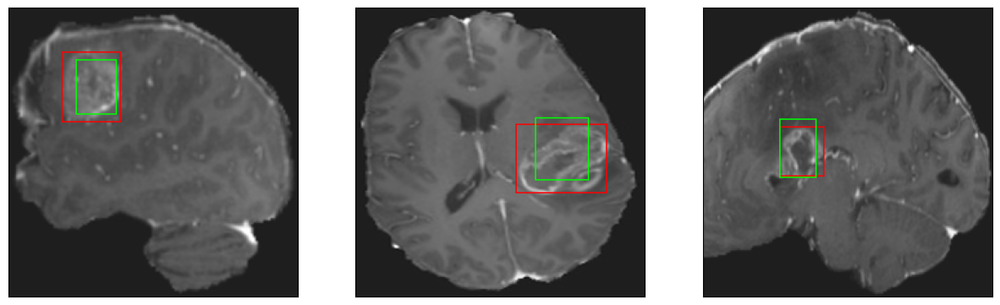

26/26 [==============================] - 8s 316ms/step - loss: 7.9790 - IoU: 0.4525 - val_loss: 13.0048 - val_IoU: 0.3742
Epoch 72/200
26/26 [==============================] - ETA: 0s - loss: 7.6334 - IoU: 0.4732
Epoch 72: val_loss improved from 9.97763 to 9.54946, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 50ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 42ms/step
4


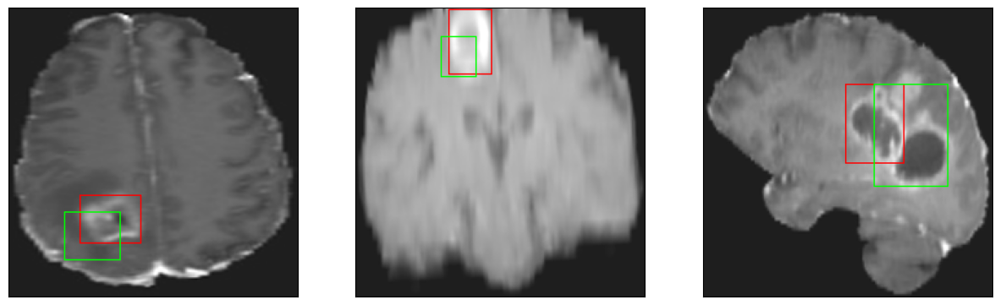

26/26 [==============================] - 18s 719ms/step - loss: 7.6334 - IoU: 0.4732 - val_loss: 9.5495 - val_IoU: 0.4791
Epoch 73/200
26/26 [==============================] - ETA: 0s - loss: 7.4489 - IoU: 0.4765
Epoch 73: val_loss did not improve from 9.54946
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4


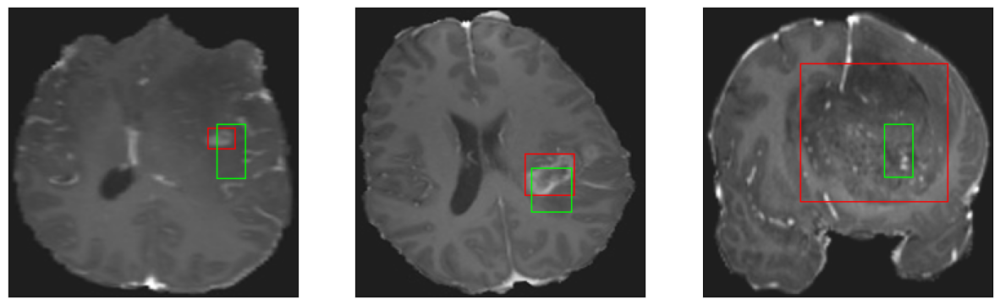

26/26 [==============================] - 8s 314ms/step - loss: 7.4489 - IoU: 0.4765 - val_loss: 10.4081 - val_IoU: 0.4336
Epoch 74/200
26/26 [==============================] - ETA: 0s - loss: 7.5987 - IoU: 0.4761
Epoch 74: val_loss improved from 9.54946 to 9.44093, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 47ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


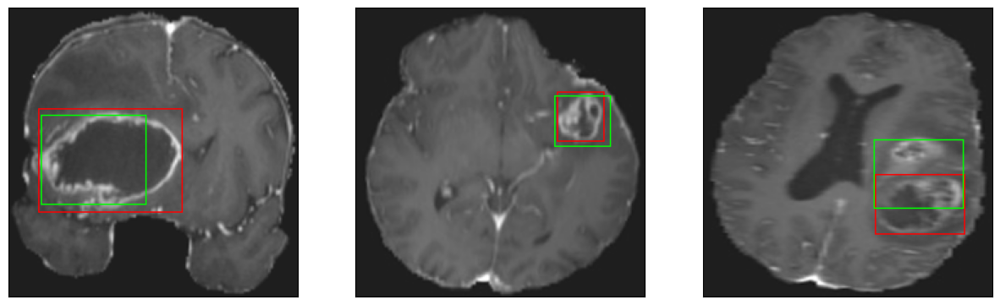

26/26 [==============================] - 14s 564ms/step - loss: 7.5987 - IoU: 0.4761 - val_loss: 9.4409 - val_IoU: 0.4957
Epoch 75/200
26/26 [==============================] - ETA: 0s - loss: 7.7440 - IoU: 0.4627
Epoch 75: val_loss improved from 9.44093 to 9.41691, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 51ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


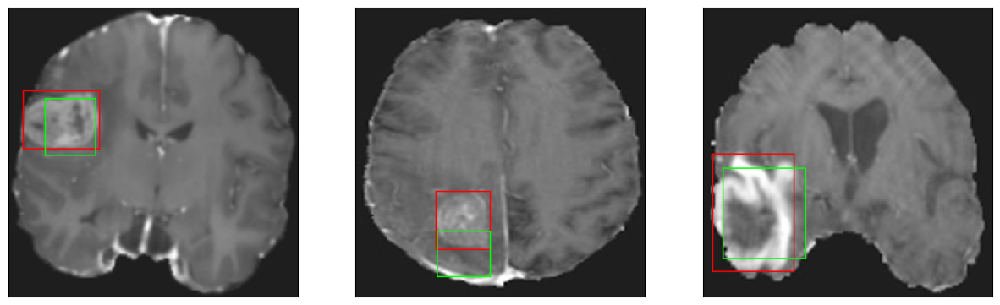

26/26 [==============================] - 17s 657ms/step - loss: 7.7440 - IoU: 0.4627 - val_loss: 9.4169 - val_IoU: 0.4829
Epoch 76/200
26/26 [==============================] - ETA: 0s - loss: 7.2906 - IoU: 0.4898
Epoch 76: val_loss did not improve from 9.41691
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 46ms/step
4


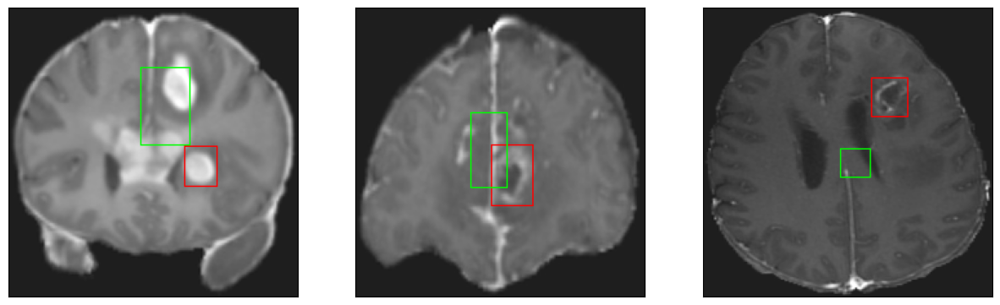

26/26 [==============================] - 8s 314ms/step - loss: 7.2906 - IoU: 0.4898 - val_loss: 10.2541 - val_IoU: 0.4545
Epoch 77/200
26/26 [==============================] - ETA: 0s - loss: 7.0440 - IoU: 0.4919
Epoch 77: val_loss did not improve from 9.41691
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 46ms/step
4


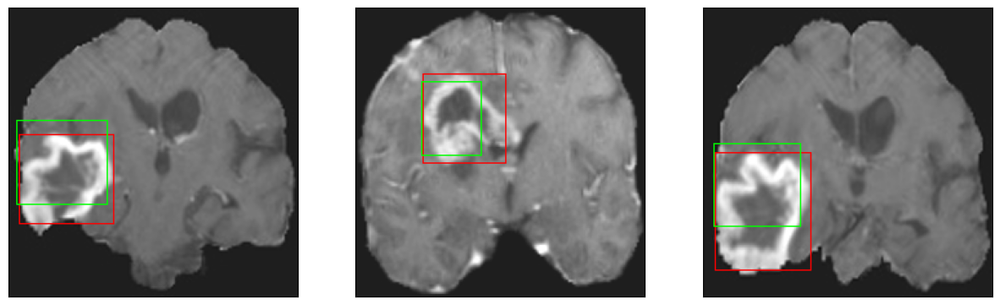

26/26 [==============================] - 8s 315ms/step - loss: 7.0440 - IoU: 0.4919 - val_loss: 10.4041 - val_IoU: 0.4241
Epoch 78/200
26/26 [==============================] - ETA: 0s - loss: 7.1840 - IoU: 0.5000
Epoch 78: val_loss did not improve from 9.41691
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


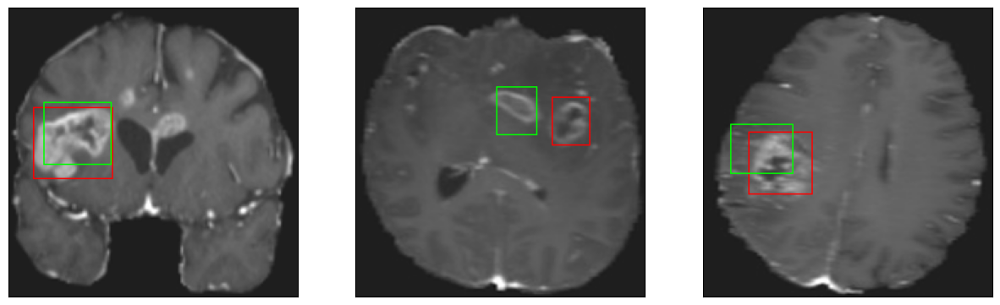

26/26 [==============================] - 8s 322ms/step - loss: 7.1840 - IoU: 0.5000 - val_loss: 11.6932 - val_IoU: 0.3525
Epoch 79/200
26/26 [==============================] - ETA: 0s - loss: 7.3130 - IoU: 0.4917
Epoch 79: val_loss did not improve from 9.41691
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


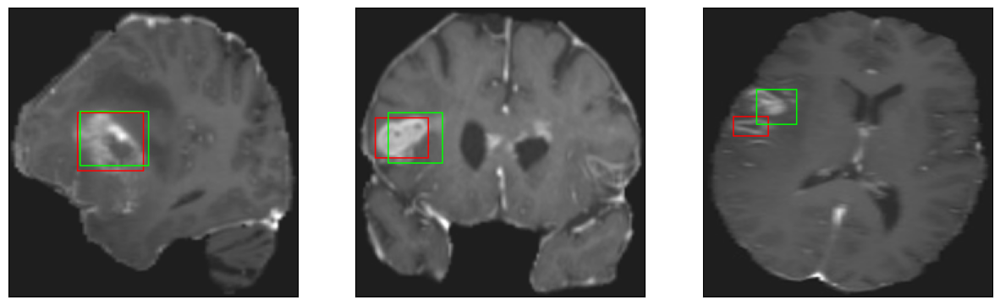

26/26 [==============================] - 8s 294ms/step - loss: 7.3130 - IoU: 0.4917 - val_loss: 10.2945 - val_IoU: 0.4455
Epoch 80/200
26/26 [==============================] - ETA: 0s - loss: 7.1205 - IoU: 0.4853
Epoch 80: val_loss did not improve from 9.41691
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4


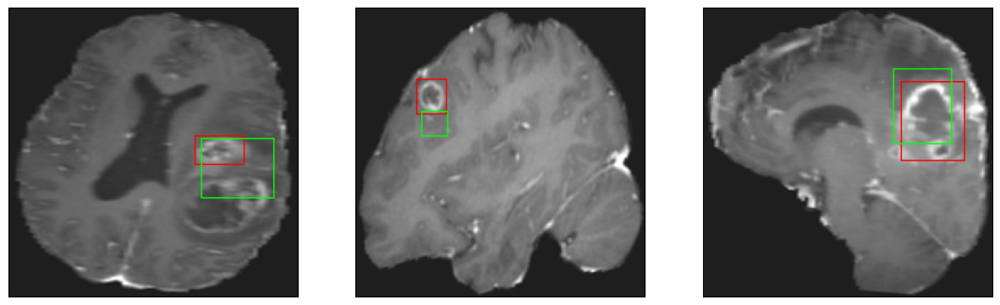

26/26 [==============================] - 8s 301ms/step - loss: 7.1205 - IoU: 0.4853 - val_loss: 10.6926 - val_IoU: 0.4099
Epoch 81/200
26/26 [==============================] - ETA: 0s - loss: 7.1909 - IoU: 0.4849
Epoch 81: val_loss did not improve from 9.41691
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


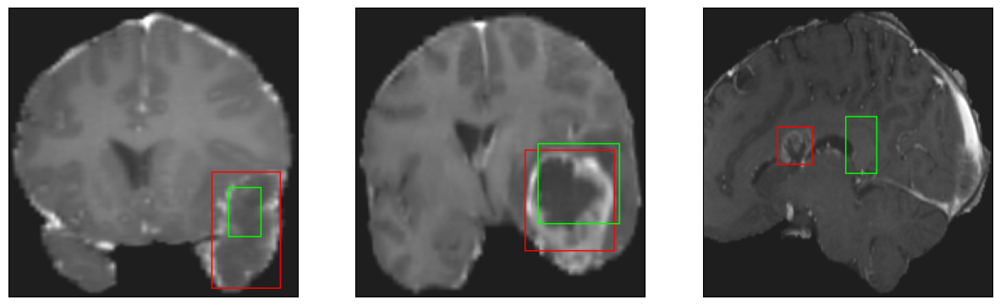

26/26 [==============================] - 8s 303ms/step - loss: 7.1909 - IoU: 0.4849 - val_loss: 10.0428 - val_IoU: 0.4585
Epoch 82/200
26/26 [==============================] - ETA: 0s - loss: 6.9630 - IoU: 0.5161
Epoch 82: val_loss did not improve from 9.41691
8/8 [==============================] - 0s 47ms/step
4
8/8 [==============================] - 0s 49ms/step
4
8/8 [==============================] - 0s 45ms/step
4


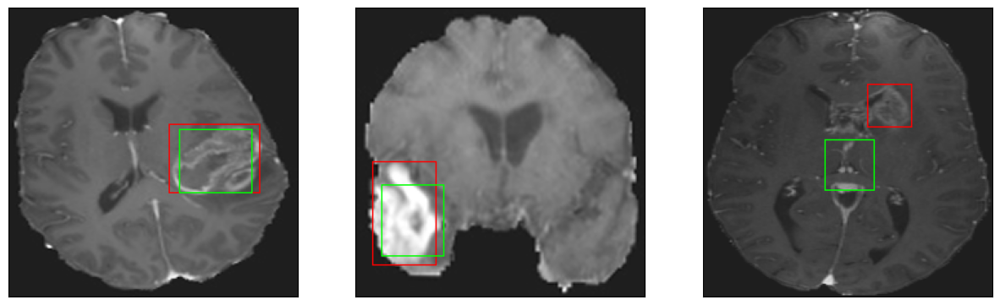

26/26 [==============================] - 8s 303ms/step - loss: 6.9630 - IoU: 0.5161 - val_loss: 10.5681 - val_IoU: 0.4332
Epoch 83/200
26/26 [==============================] - ETA: 0s - loss: 6.6878 - IoU: 0.5099
Epoch 83: val_loss did not improve from 9.41691
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


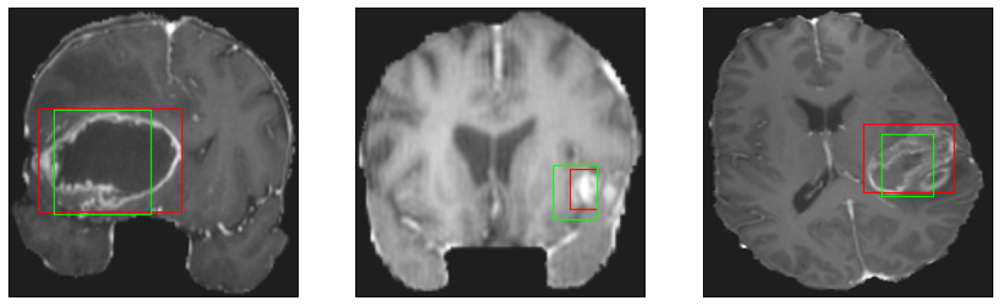

26/26 [==============================] - 7s 281ms/step - loss: 6.6878 - IoU: 0.5099 - val_loss: 10.2578 - val_IoU: 0.4197
Epoch 84/200
26/26 [==============================] - ETA: 0s - loss: 6.8377 - IoU: 0.5078
Epoch 84: val_loss did not improve from 9.41691
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 44ms/step
4


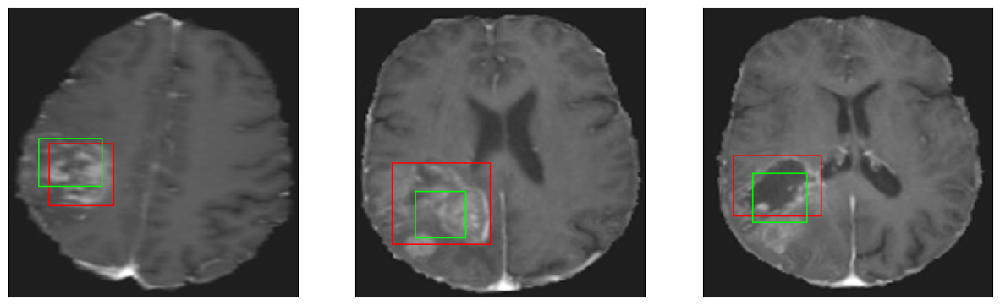

26/26 [==============================] - 8s 320ms/step - loss: 6.8377 - IoU: 0.5078 - val_loss: 12.1163 - val_IoU: 0.3682
Epoch 85/200
26/26 [==============================] - ETA: 0s - loss: 6.5504 - IoU: 0.5168
Epoch 85: val_loss did not improve from 9.41691
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


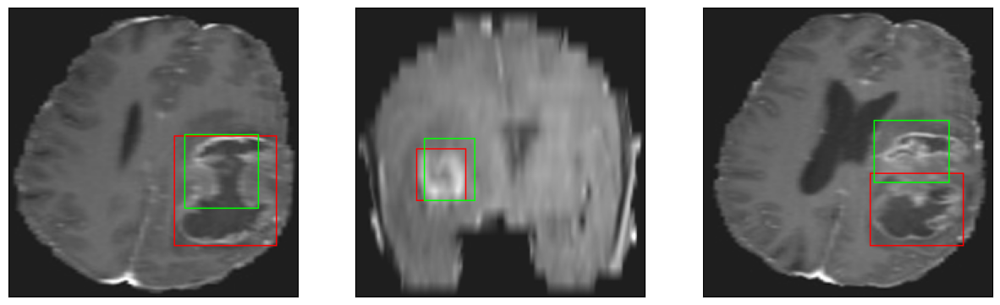

26/26 [==============================] - 7s 288ms/step - loss: 6.5504 - IoU: 0.5168 - val_loss: 10.7517 - val_IoU: 0.4655
Epoch 86/200
26/26 [==============================] - ETA: 0s - loss: 6.5674 - IoU: 0.5277
Epoch 86: val_loss did not improve from 9.41691
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 44ms/step
4


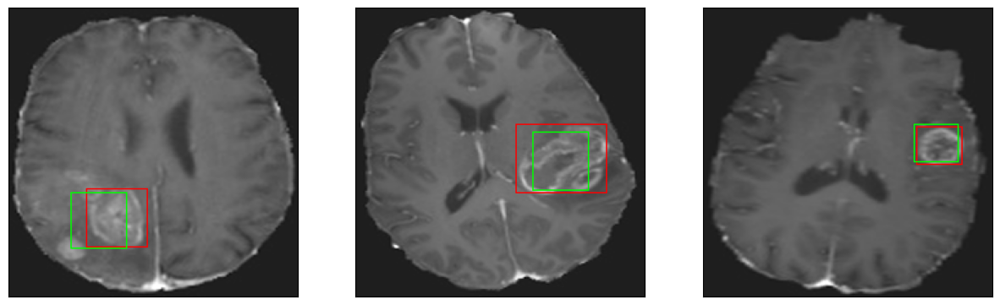

26/26 [==============================] - 8s 296ms/step - loss: 6.5674 - IoU: 0.5277 - val_loss: 10.5287 - val_IoU: 0.4845
Epoch 87/200
26/26 [==============================] - ETA: 0s - loss: 7.1815 - IoU: 0.4889
Epoch 87: val_loss did not improve from 9.41691
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


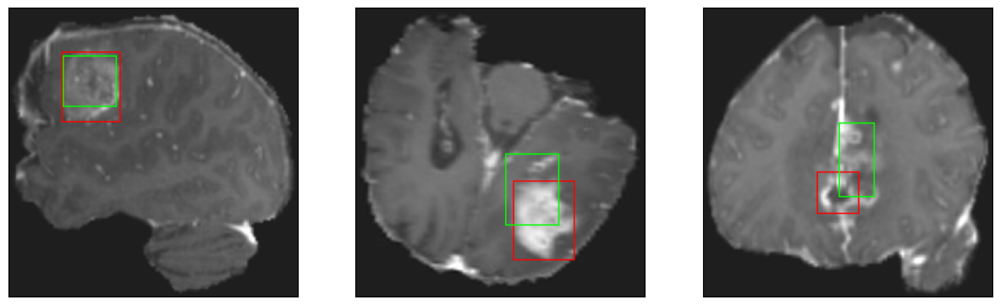

26/26 [==============================] - 8s 312ms/step - loss: 7.1815 - IoU: 0.4889 - val_loss: 10.8016 - val_IoU: 0.4293
Epoch 88/200
26/26 [==============================] - ETA: 0s - loss: 7.0146 - IoU: 0.4935
Epoch 88: val_loss did not improve from 9.41691
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


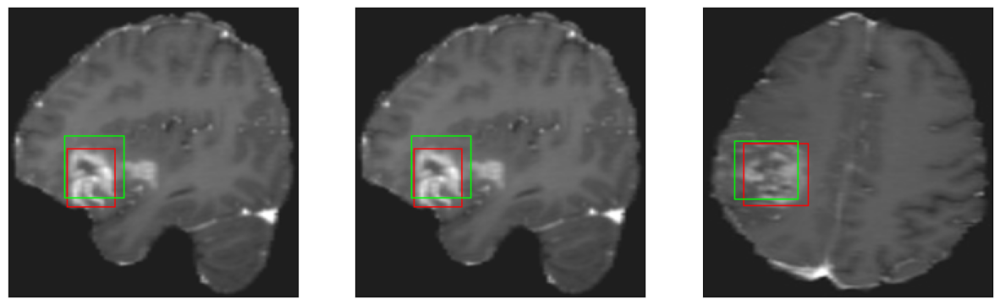

26/26 [==============================] - 8s 299ms/step - loss: 7.0146 - IoU: 0.4935 - val_loss: 11.7135 - val_IoU: 0.4000
Epoch 89/200
26/26 [==============================] - ETA: 0s - loss: 6.7412 - IoU: 0.5093
Epoch 89: val_loss did not improve from 9.41691
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 43ms/step
4


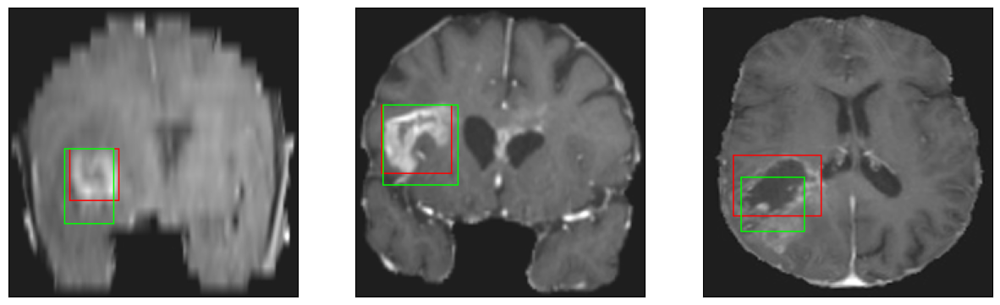

26/26 [==============================] - 8s 304ms/step - loss: 6.7412 - IoU: 0.5093 - val_loss: 14.0670 - val_IoU: 0.3556
Epoch 90/200
26/26 [==============================] - ETA: 0s - loss: 6.6295 - IoU: 0.5330
Epoch 90: val_loss did not improve from 9.41691
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4


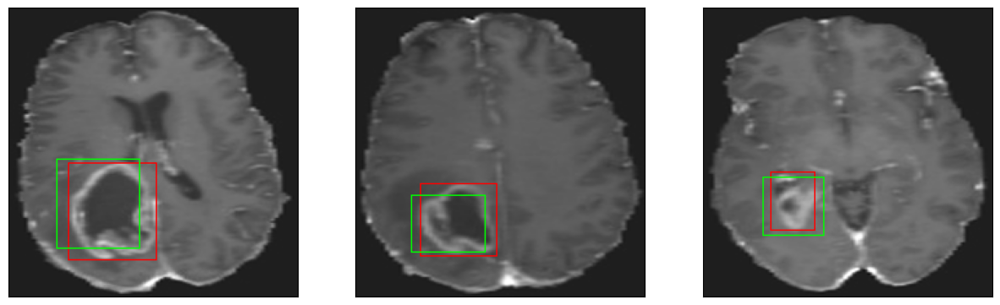

26/26 [==============================] - 8s 301ms/step - loss: 6.6295 - IoU: 0.5330 - val_loss: 9.4899 - val_IoU: 0.4845
Epoch 91/200
26/26 [==============================] - ETA: 0s - loss: 6.9333 - IoU: 0.4992
Epoch 91: val_loss improved from 9.41691 to 9.34995, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 44ms/step
4


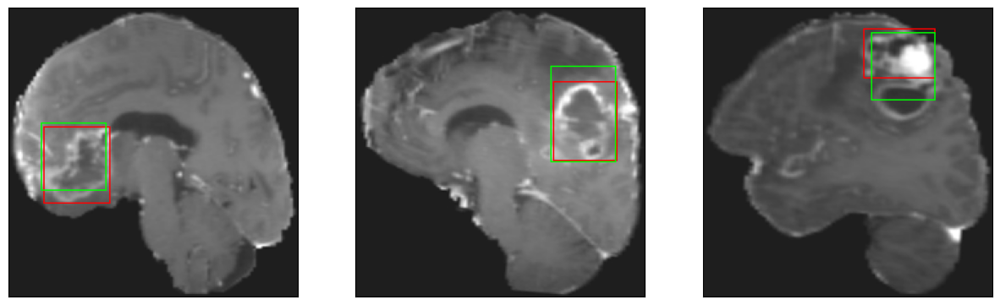

26/26 [==============================] - 19s 745ms/step - loss: 6.9333 - IoU: 0.4992 - val_loss: 9.3500 - val_IoU: 0.4733
Epoch 92/200
26/26 [==============================] - ETA: 0s - loss: 6.5706 - IoU: 0.5143
Epoch 92: val_loss did not improve from 9.34995
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 45ms/step
4


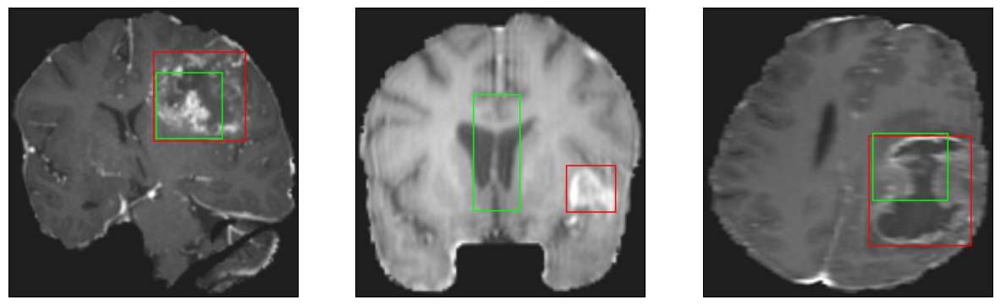

26/26 [==============================] - 8s 306ms/step - loss: 6.5706 - IoU: 0.5143 - val_loss: 10.7892 - val_IoU: 0.4346
Epoch 93/200
26/26 [==============================] - ETA: 0s - loss: 6.5818 - IoU: 0.5128
Epoch 93: val_loss did not improve from 9.34995
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 44ms/step
4


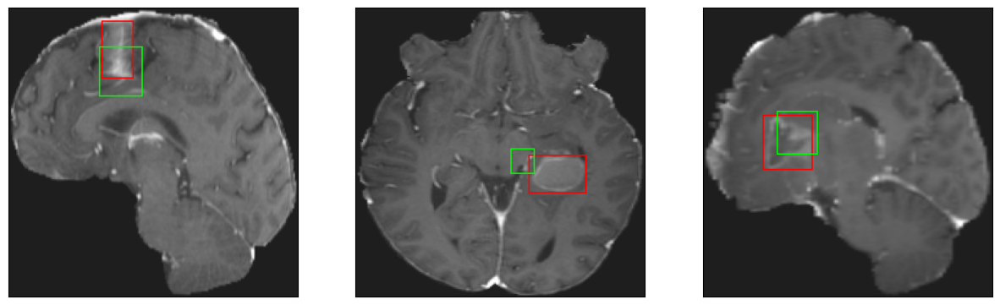

26/26 [==============================] - 8s 328ms/step - loss: 6.5818 - IoU: 0.5128 - val_loss: 9.8224 - val_IoU: 0.4539
Epoch 94/200
26/26 [==============================] - ETA: 0s - loss: 7.1958 - IoU: 0.4953
Epoch 94: val_loss did not improve from 9.34995
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


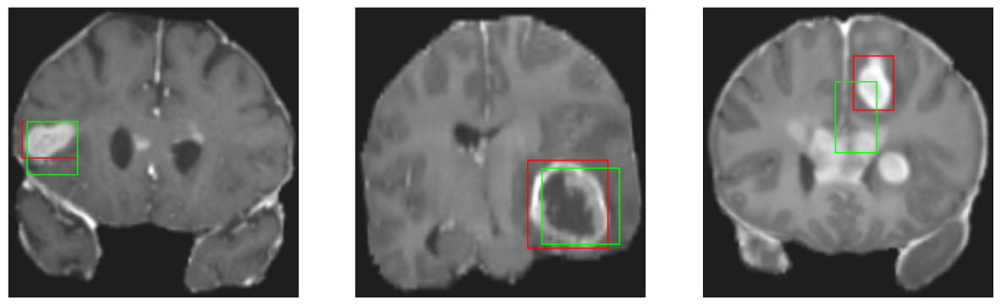

26/26 [==============================] - 7s 276ms/step - loss: 7.1958 - IoU: 0.4953 - val_loss: 9.6616 - val_IoU: 0.4699
Epoch 95/200
26/26 [==============================] - ETA: 0s - loss: 6.8498 - IoU: 0.4979
Epoch 95: val_loss did not improve from 9.34995
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


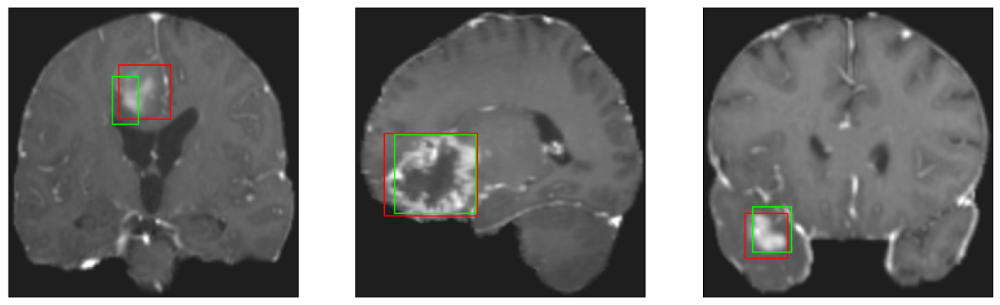

26/26 [==============================] - 8s 303ms/step - loss: 6.8498 - IoU: 0.4979 - val_loss: 10.6618 - val_IoU: 0.4461
Epoch 96/200
26/26 [==============================] - ETA: 0s - loss: 6.7426 - IoU: 0.5115
Epoch 96: val_loss did not improve from 9.34995
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 44ms/step
4


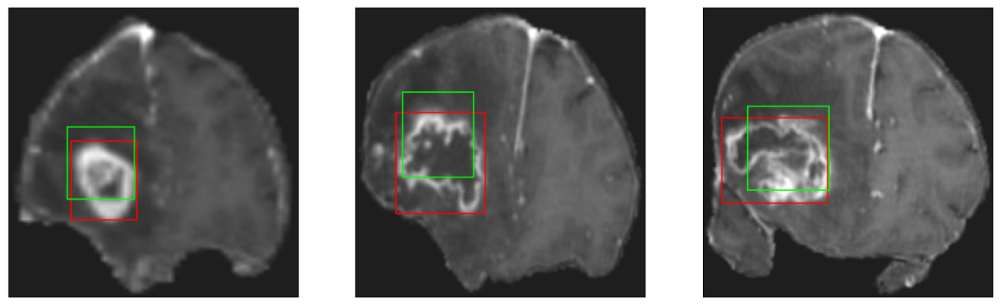

26/26 [==============================] - 8s 317ms/step - loss: 6.7426 - IoU: 0.5115 - val_loss: 9.7540 - val_IoU: 0.4613
Epoch 97/200
26/26 [==============================] - ETA: 0s - loss: 6.7563 - IoU: 0.5028
Epoch 97: val_loss improved from 9.34995 to 9.11772, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


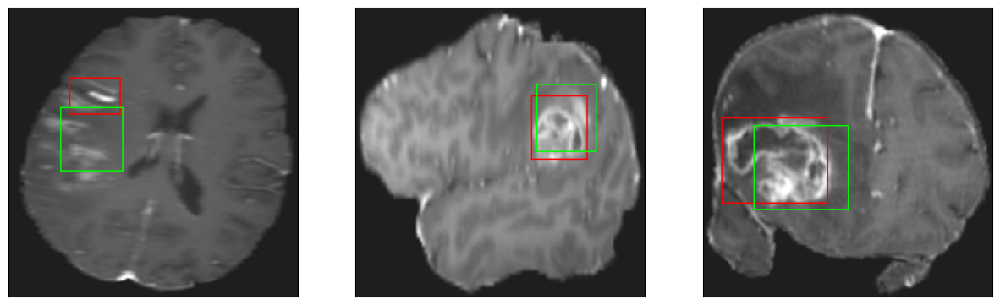

26/26 [==============================] - 20s 805ms/step - loss: 6.7563 - IoU: 0.5028 - val_loss: 9.1177 - val_IoU: 0.4977
Epoch 98/200
26/26 [==============================] - ETA: 0s - loss: 6.6723 - IoU: 0.5085
Epoch 98: val_loss did not improve from 9.11772
8/8 [==============================] - 0s 53ms/step
4
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 49ms/step
4


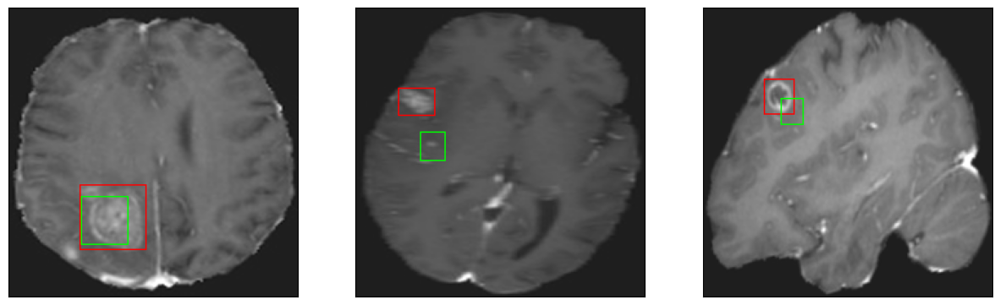

26/26 [==============================] - 9s 345ms/step - loss: 6.6723 - IoU: 0.5085 - val_loss: 10.7730 - val_IoU: 0.4379
Epoch 99/200
26/26 [==============================] - ETA: 0s - loss: 6.5829 - IoU: 0.5236
Epoch 99: val_loss did not improve from 9.11772
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


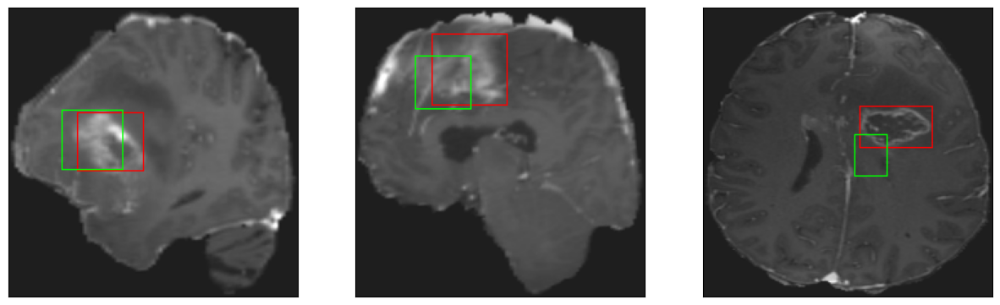

26/26 [==============================] - 7s 290ms/step - loss: 6.5829 - IoU: 0.5236 - val_loss: 10.0704 - val_IoU: 0.4494
Epoch 100/200
26/26 [==============================] - ETA: 0s - loss: 6.5137 - IoU: 0.5181
Epoch 100: val_loss did not improve from 9.11772
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 45ms/step
4


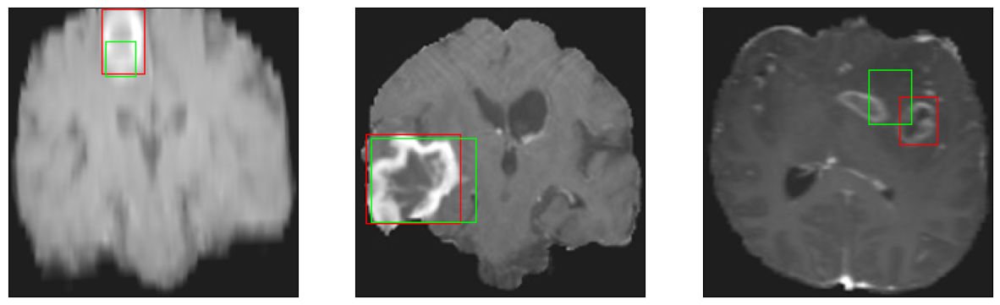

26/26 [==============================] - 8s 322ms/step - loss: 6.5137 - IoU: 0.5181 - val_loss: 9.3243 - val_IoU: 0.4924
Epoch 101/200
26/26 [==============================] - ETA: 0s - loss: 6.7509 - IoU: 0.5102
Epoch 101: val_loss improved from 9.11772 to 8.96789, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


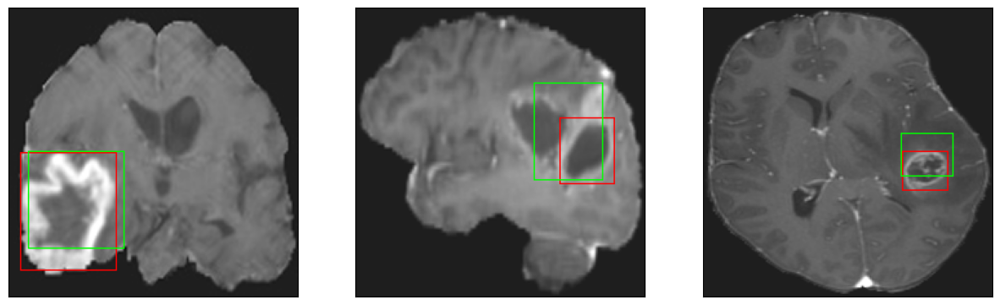

26/26 [==============================] - 19s 766ms/step - loss: 6.7509 - IoU: 0.5102 - val_loss: 8.9679 - val_IoU: 0.5062
Epoch 102/200
26/26 [==============================] - ETA: 0s - loss: 6.7432 - IoU: 0.5142
Epoch 102: val_loss did not improve from 8.96789
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 45ms/step
4


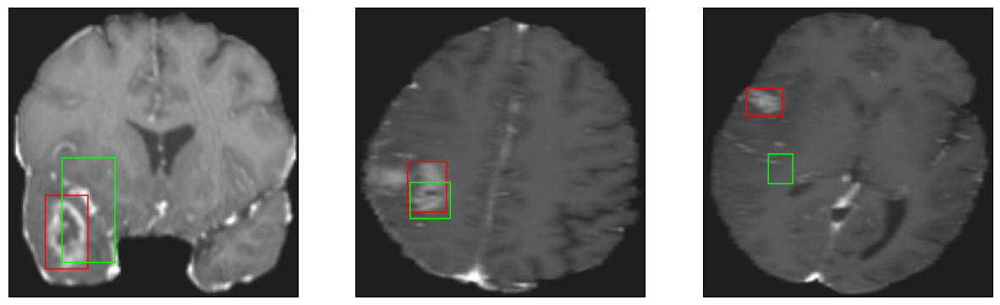

26/26 [==============================] - 8s 321ms/step - loss: 6.7432 - IoU: 0.5142 - val_loss: 12.1548 - val_IoU: 0.4061
Epoch 103/200
26/26 [==============================] - ETA: 0s - loss: 6.7145 - IoU: 0.5096
Epoch 103: val_loss did not improve from 8.96789
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 43ms/step
4


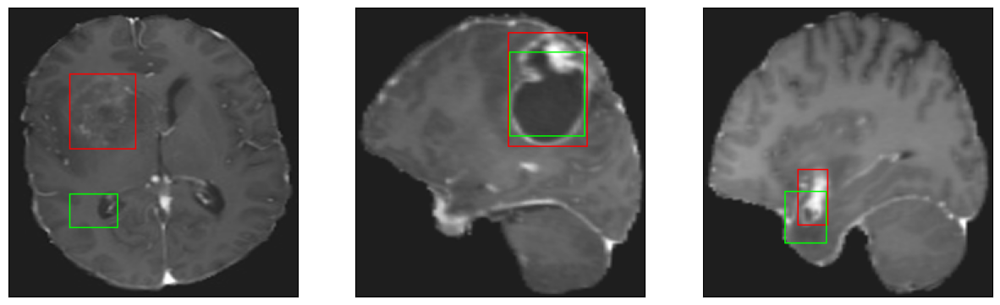

26/26 [==============================] - 8s 292ms/step - loss: 6.7145 - IoU: 0.5096 - val_loss: 10.0059 - val_IoU: 0.4628
Epoch 104/200
26/26 [==============================] - ETA: 0s - loss: 6.5817 - IoU: 0.5177
Epoch 104: val_loss did not improve from 8.96789
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 45ms/step
4


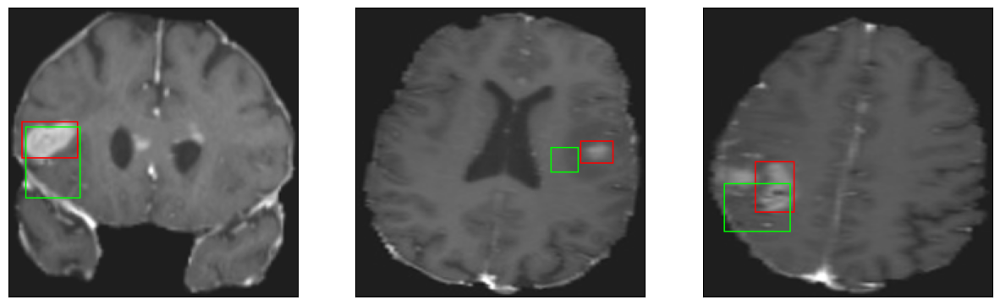

26/26 [==============================] - 8s 321ms/step - loss: 6.5817 - IoU: 0.5177 - val_loss: 9.3686 - val_IoU: 0.4828
Epoch 105/200
26/26 [==============================] - ETA: 0s - loss: 6.3078 - IoU: 0.5411
Epoch 105: val_loss did not improve from 8.96789
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


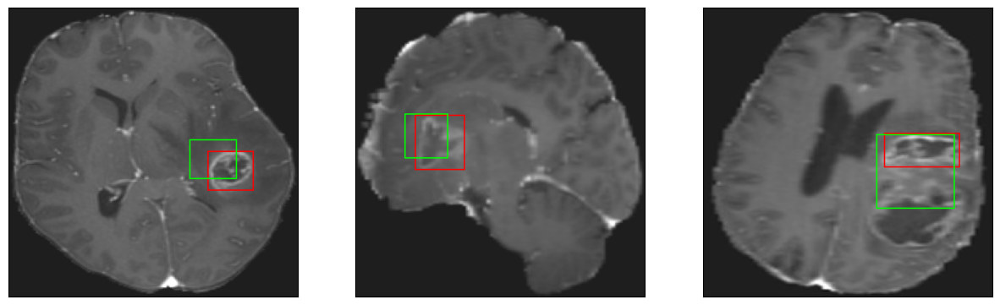

26/26 [==============================] - 8s 290ms/step - loss: 6.3078 - IoU: 0.5411 - val_loss: 9.0276 - val_IoU: 0.5014
Epoch 106/200
26/26 [==============================] - ETA: 0s - loss: 6.3842 - IoU: 0.5327
Epoch 106: val_loss did not improve from 8.96789
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 44ms/step
4


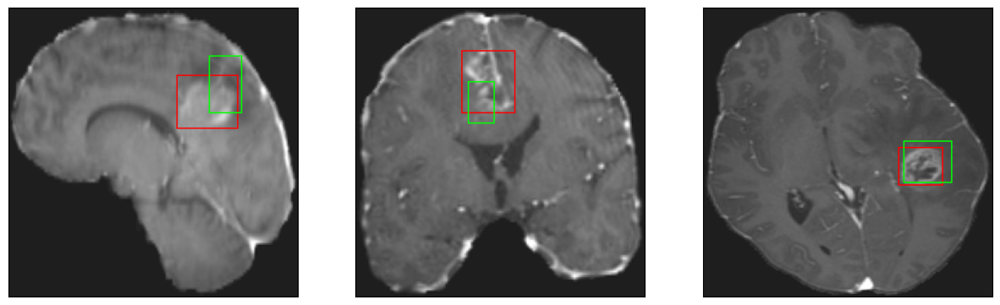

26/26 [==============================] - 8s 294ms/step - loss: 6.3842 - IoU: 0.5327 - val_loss: 9.5564 - val_IoU: 0.4731
Epoch 107/200
26/26 [==============================] - ETA: 0s - loss: 6.9247 - IoU: 0.5017
Epoch 107: val_loss did not improve from 8.96789
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 44ms/step
4


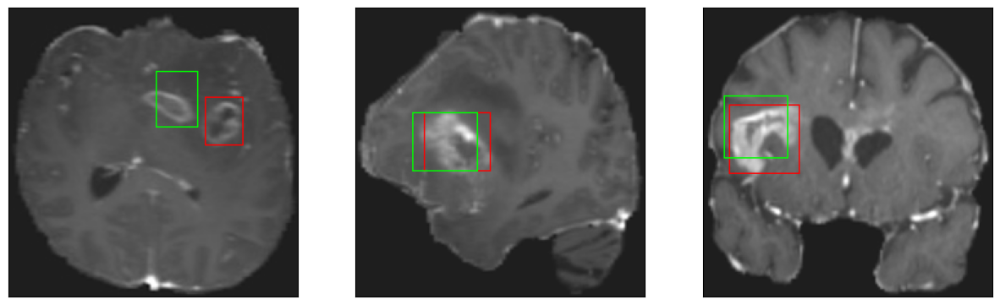

26/26 [==============================] - 8s 291ms/step - loss: 6.9247 - IoU: 0.5017 - val_loss: 9.0123 - val_IoU: 0.4841
Epoch 108/200
26/26 [==============================] - ETA: 0s - loss: 6.6160 - IoU: 0.5200
Epoch 108: val_loss did not improve from 8.96789
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


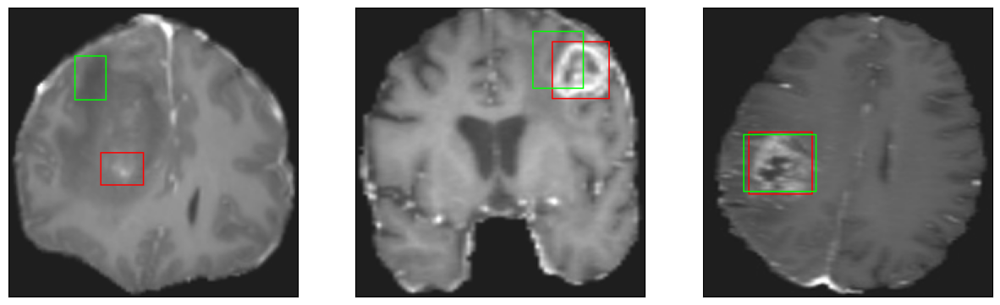

26/26 [==============================] - 7s 276ms/step - loss: 6.6160 - IoU: 0.5200 - val_loss: 10.0077 - val_IoU: 0.4487
Epoch 109/200
26/26 [==============================] - ETA: 0s - loss: 6.3054 - IoU: 0.5348
Epoch 109: val_loss did not improve from 8.96789
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 42ms/step
4


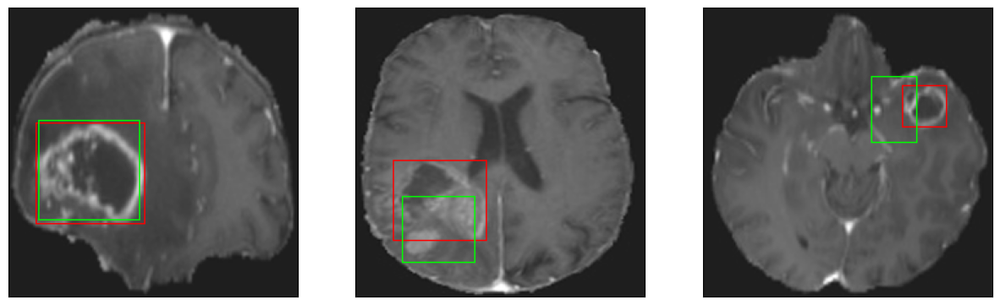

26/26 [==============================] - 8s 313ms/step - loss: 6.3054 - IoU: 0.5348 - val_loss: 9.0606 - val_IoU: 0.5291
Epoch 110/200
26/26 [==============================] - ETA: 0s - loss: 6.4405 - IoU: 0.5279
Epoch 110: val_loss did not improve from 8.96789
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 46ms/step
4


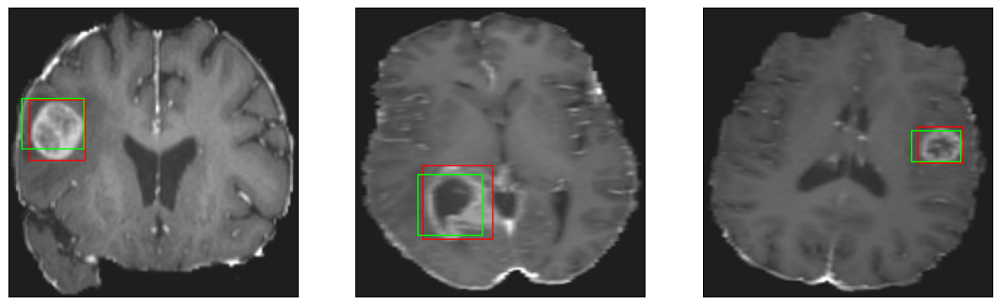

26/26 [==============================] - 8s 299ms/step - loss: 6.4405 - IoU: 0.5279 - val_loss: 9.4060 - val_IoU: 0.4694
Epoch 111/200
26/26 [==============================] - ETA: 0s - loss: 6.3433 - IoU: 0.5270
Epoch 111: val_loss did not improve from 8.96789
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4


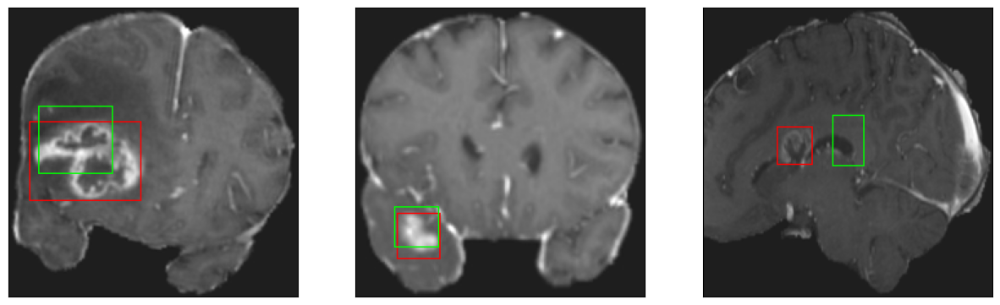

26/26 [==============================] - 8s 321ms/step - loss: 6.3433 - IoU: 0.5270 - val_loss: 10.8224 - val_IoU: 0.4212
Epoch 112/200
26/26 [==============================] - ETA: 0s - loss: 6.4669 - IoU: 0.5216
Epoch 112: val_loss did not improve from 8.96789
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 45ms/step
4


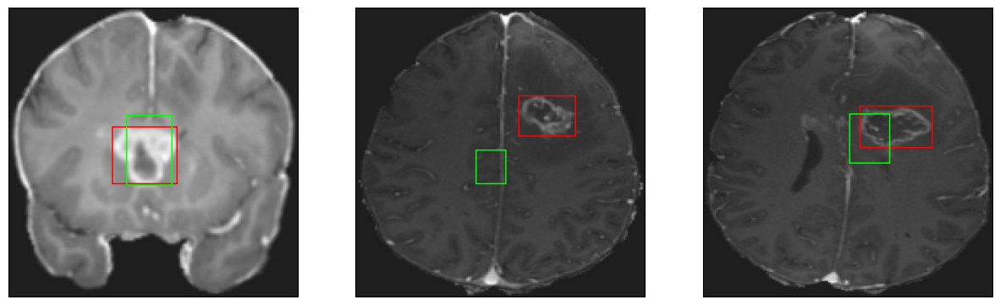

26/26 [==============================] - 8s 316ms/step - loss: 6.4669 - IoU: 0.5216 - val_loss: 9.2665 - val_IoU: 0.4832
Epoch 113/200
26/26 [==============================] - ETA: 0s - loss: 5.8841 - IoU: 0.5539
Epoch 113: val_loss did not improve from 8.96789
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


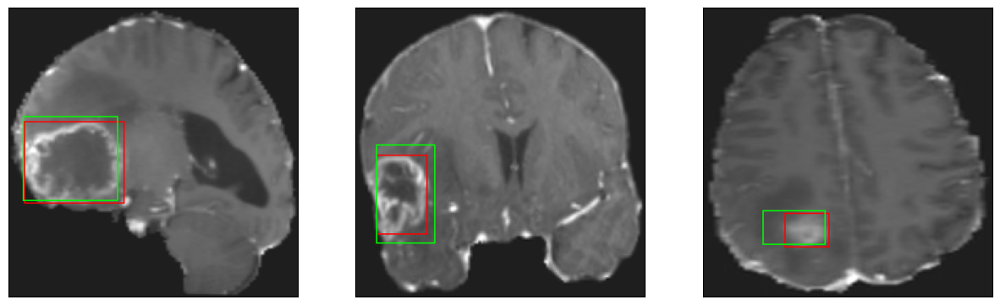

26/26 [==============================] - 8s 304ms/step - loss: 5.8841 - IoU: 0.5539 - val_loss: 9.7478 - val_IoU: 0.4689
Epoch 114/200
26/26 [==============================] - ETA: 0s - loss: 6.3003 - IoU: 0.5357
Epoch 114: val_loss improved from 8.96789 to 8.50615, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


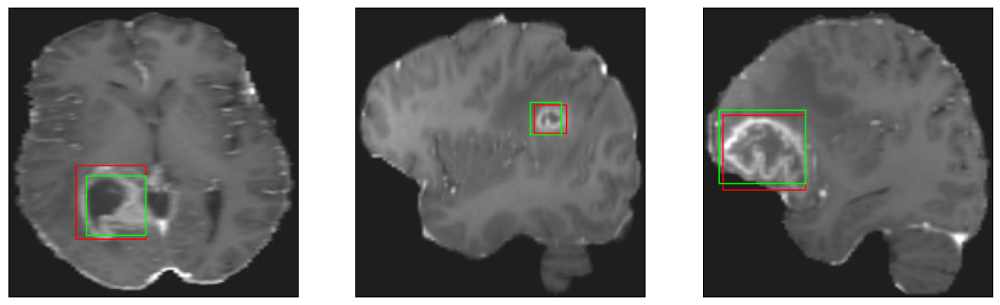

26/26 [==============================] - 20s 774ms/step - loss: 6.3003 - IoU: 0.5357 - val_loss: 8.5061 - val_IoU: 0.5269
Epoch 115/200
26/26 [==============================] - ETA: 0s - loss: 6.2659 - IoU: 0.5392
Epoch 115: val_loss did not improve from 8.50615
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 46ms/step
4


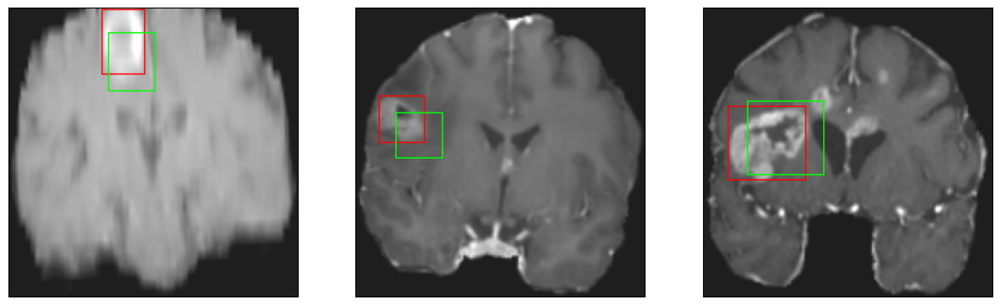

26/26 [==============================] - 8s 330ms/step - loss: 6.2659 - IoU: 0.5392 - val_loss: 9.1373 - val_IoU: 0.4889
Epoch 116/200
26/26 [==============================] - ETA: 0s - loss: 6.1738 - IoU: 0.5466
Epoch 116: val_loss did not improve from 8.50615
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


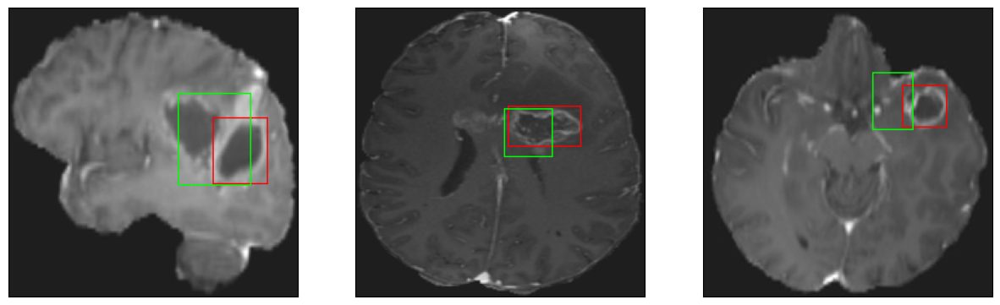

26/26 [==============================] - 8s 327ms/step - loss: 6.1738 - IoU: 0.5466 - val_loss: 8.9829 - val_IoU: 0.5009
Epoch 117/200
26/26 [==============================] - ETA: 0s - loss: 6.0827 - IoU: 0.5434
Epoch 117: val_loss did not improve from 8.50615
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 47ms/step
4
8/8 [==============================] - 0s 45ms/step
4


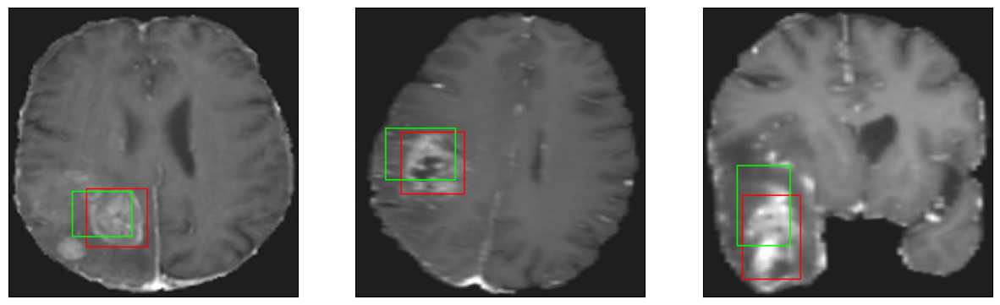

26/26 [==============================] - 9s 337ms/step - loss: 6.0827 - IoU: 0.5434 - val_loss: 9.8624 - val_IoU: 0.4464
Epoch 118/200
26/26 [==============================] - ETA: 0s - loss: 6.0711 - IoU: 0.5480
Epoch 118: val_loss did not improve from 8.50615
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


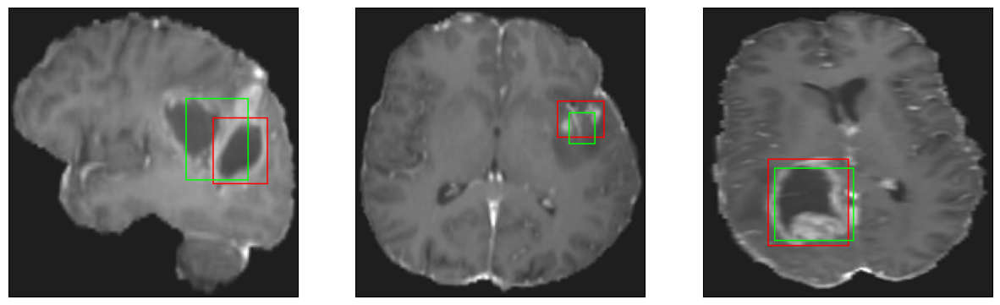

26/26 [==============================] - 8s 296ms/step - loss: 6.0711 - IoU: 0.5480 - val_loss: 9.5964 - val_IoU: 0.4834
Epoch 119/200
26/26 [==============================] - ETA: 0s - loss: 6.2113 - IoU: 0.5434
Epoch 119: val_loss did not improve from 8.50615
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


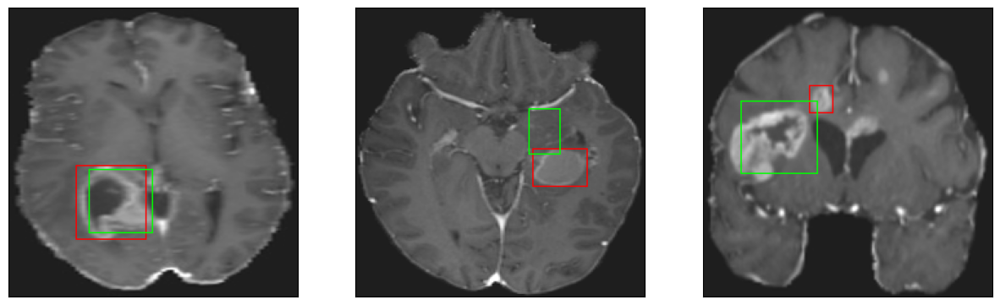

26/26 [==============================] - 7s 288ms/step - loss: 6.2113 - IoU: 0.5434 - val_loss: 8.8023 - val_IoU: 0.5134
Epoch 120/200
26/26 [==============================] - ETA: 0s - loss: 6.3689 - IoU: 0.5337
Epoch 120: val_loss did not improve from 8.50615
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 44ms/step
4


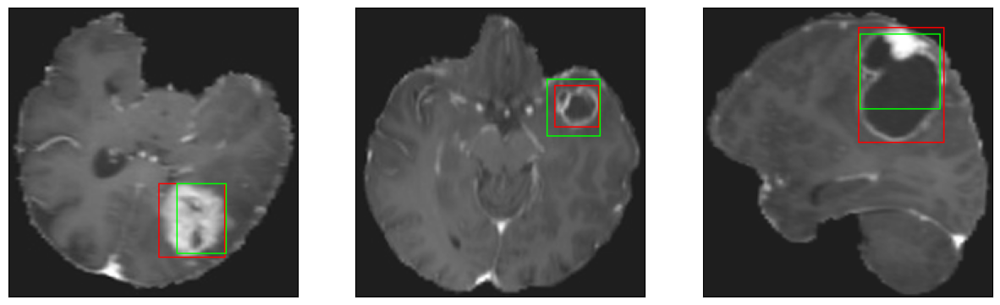

26/26 [==============================] - 8s 294ms/step - loss: 6.3689 - IoU: 0.5337 - val_loss: 9.5291 - val_IoU: 0.4789
Epoch 121/200
26/26 [==============================] - ETA: 0s - loss: 6.2159 - IoU: 0.5367
Epoch 121: val_loss did not improve from 8.50615
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


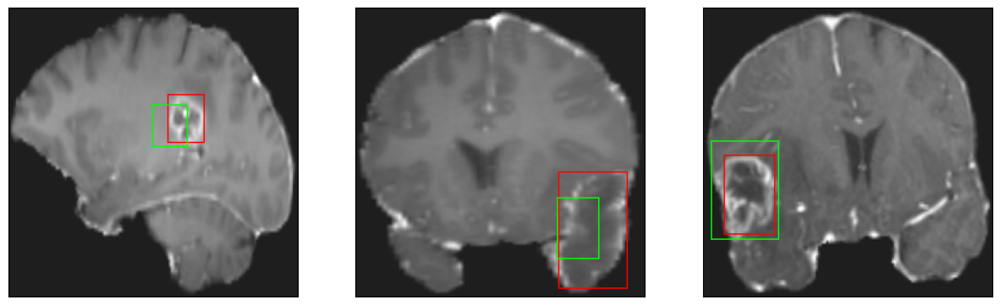

26/26 [==============================] - 8s 288ms/step - loss: 6.2159 - IoU: 0.5367 - val_loss: 9.4362 - val_IoU: 0.4646
Epoch 122/200
26/26 [==============================] - ETA: 0s - loss: 6.4513 - IoU: 0.5288
Epoch 122: val_loss did not improve from 8.50615
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 43ms/step
4


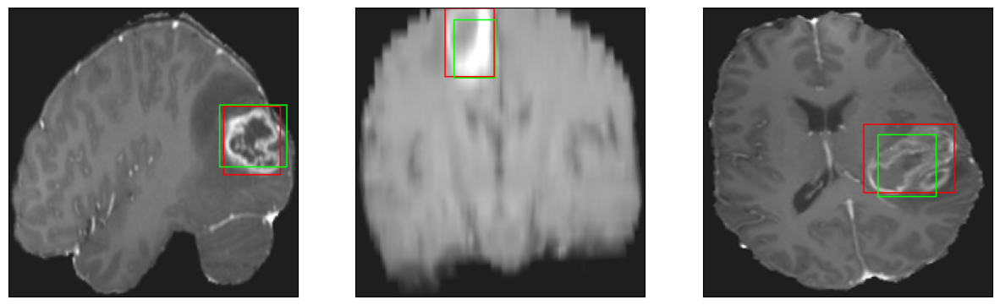

26/26 [==============================] - 8s 313ms/step - loss: 6.4513 - IoU: 0.5288 - val_loss: 10.5642 - val_IoU: 0.4221
Epoch 123/200
26/26 [==============================] - ETA: 0s - loss: 6.1441 - IoU: 0.5450
Epoch 123: val_loss did not improve from 8.50615
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


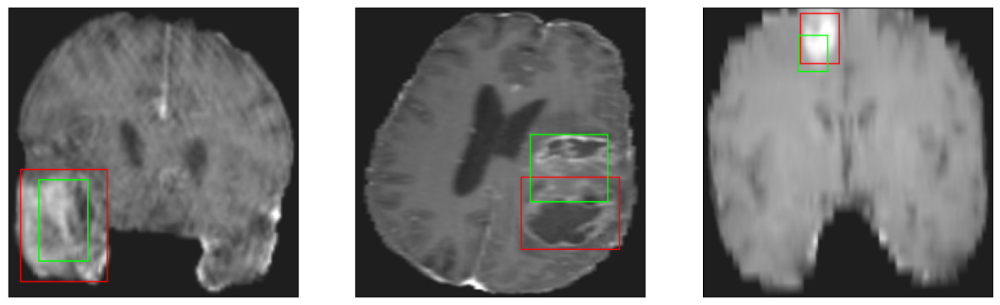

26/26 [==============================] - 7s 277ms/step - loss: 6.1441 - IoU: 0.5450 - val_loss: 9.3199 - val_IoU: 0.4883
Epoch 124/200
26/26 [==============================] - ETA: 0s - loss: 6.4814 - IoU: 0.5245
Epoch 124: val_loss did not improve from 8.50615
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 42ms/step
4


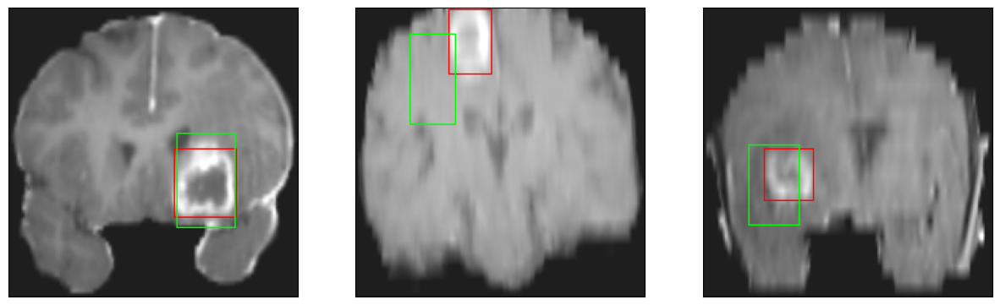

26/26 [==============================] - 8s 310ms/step - loss: 6.4814 - IoU: 0.5245 - val_loss: 14.0886 - val_IoU: 0.3476
Epoch 125/200
26/26 [==============================] - ETA: 0s - loss: 5.9257 - IoU: 0.5525
Epoch 125: val_loss did not improve from 8.50615
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 43ms/step
4


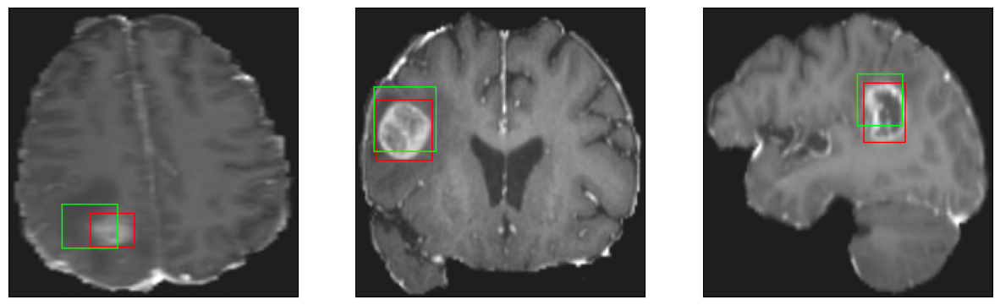

26/26 [==============================] - 8s 312ms/step - loss: 5.9257 - IoU: 0.5525 - val_loss: 9.0584 - val_IoU: 0.4992
Epoch 126/200
26/26 [==============================] - ETA: 0s - loss: 5.7134 - IoU: 0.5685
Epoch 126: val_loss did not improve from 8.50615
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


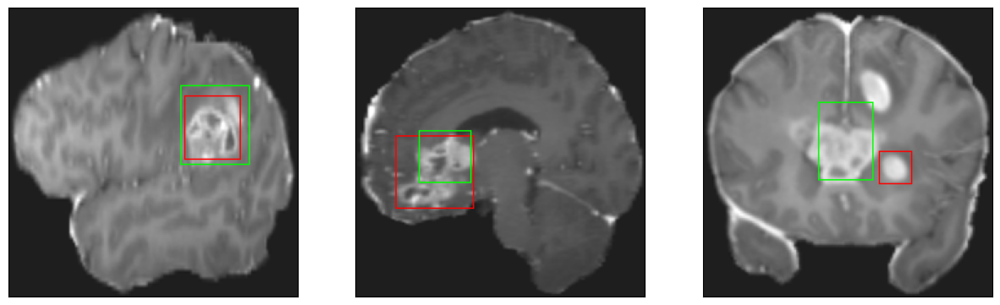

26/26 [==============================] - 7s 277ms/step - loss: 5.7134 - IoU: 0.5685 - val_loss: 10.2478 - val_IoU: 0.4583
Epoch 127/200
26/26 [==============================] - ETA: 0s - loss: 6.6749 - IoU: 0.5137
Epoch 127: val_loss did not improve from 8.50615
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 44ms/step
4


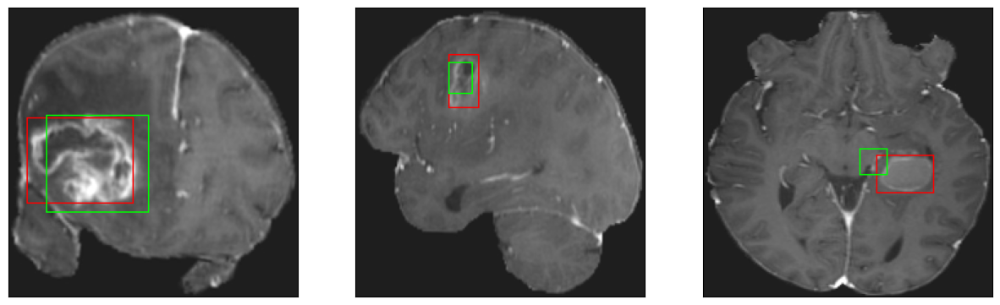

26/26 [==============================] - 8s 320ms/step - loss: 6.6749 - IoU: 0.5137 - val_loss: 9.3827 - val_IoU: 0.5004
Epoch 128/200
26/26 [==============================] - ETA: 0s - loss: 5.9824 - IoU: 0.5533
Epoch 128: val_loss did not improve from 8.50615
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


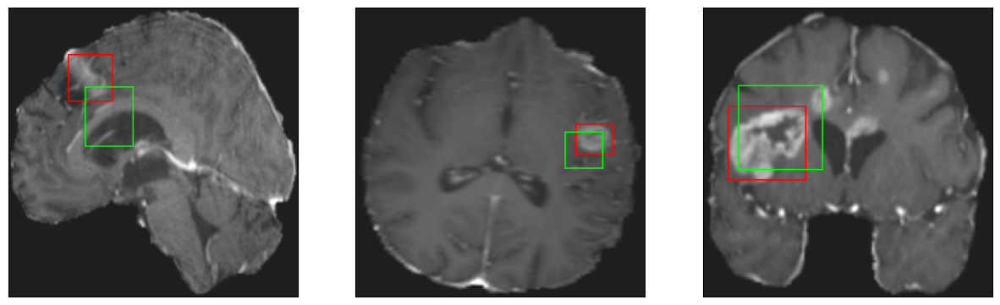

26/26 [==============================] - 8s 296ms/step - loss: 5.9824 - IoU: 0.5533 - val_loss: 9.8826 - val_IoU: 0.4654
Epoch 129/200
26/26 [==============================] - ETA: 0s - loss: 5.9484 - IoU: 0.5570
Epoch 129: val_loss did not improve from 8.50615
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


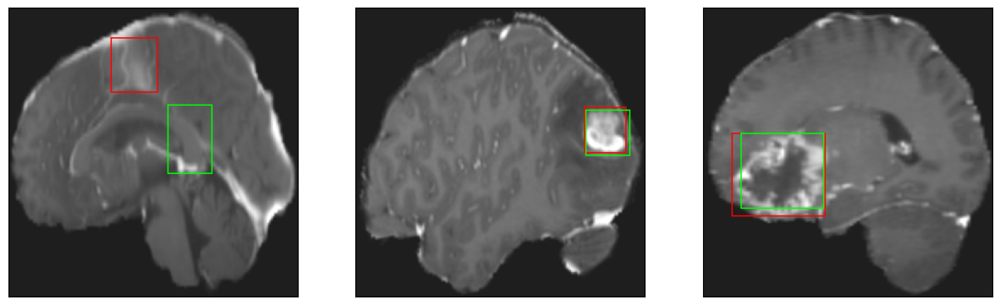

26/26 [==============================] - 8s 308ms/step - loss: 5.9484 - IoU: 0.5570 - val_loss: 10.6168 - val_IoU: 0.4406
Epoch 130/200
26/26 [==============================] - ETA: 0s - loss: 5.8206 - IoU: 0.5649
Epoch 130: val_loss did not improve from 8.50615
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


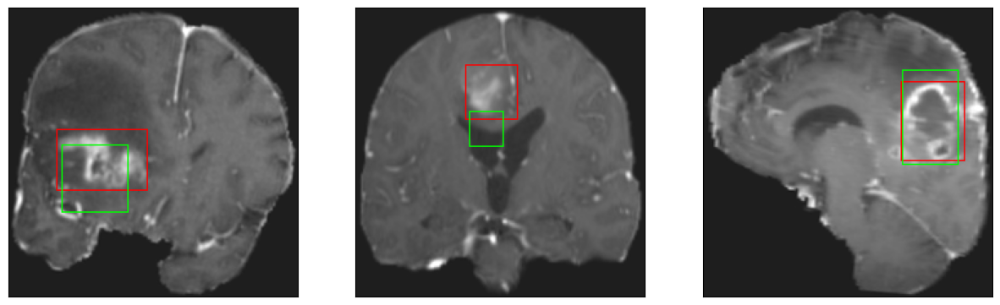

26/26 [==============================] - 7s 288ms/step - loss: 5.8206 - IoU: 0.5649 - val_loss: 10.4386 - val_IoU: 0.4470
Epoch 131/200
26/26 [==============================] - ETA: 0s - loss: 6.1810 - IoU: 0.5419
Epoch 131: val_loss did not improve from 8.50615
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


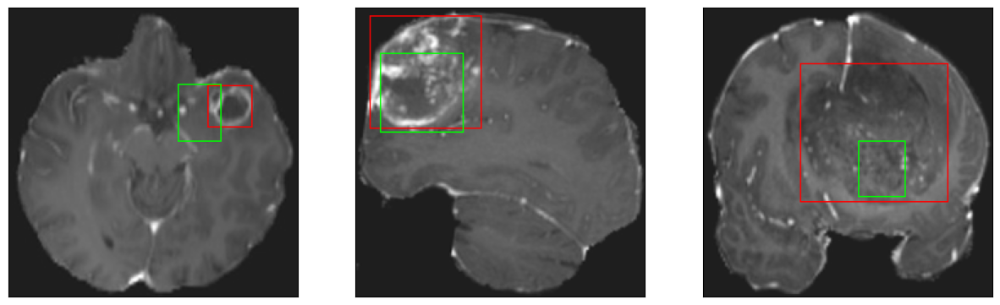

26/26 [==============================] - 7s 274ms/step - loss: 6.1810 - IoU: 0.5419 - val_loss: 9.0998 - val_IoU: 0.5113
Epoch 132/200
26/26 [==============================] - ETA: 0s - loss: 5.9833 - IoU: 0.5568
Epoch 132: val_loss did not improve from 8.50615
8/8 [==============================] - 0s 47ms/step
4
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 45ms/step
4


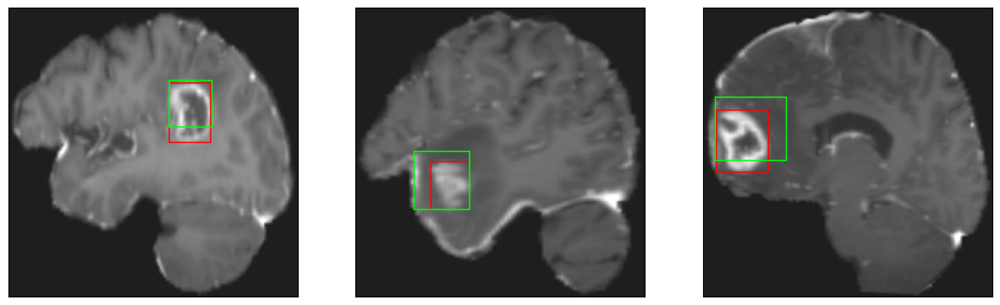

26/26 [==============================] - 8s 305ms/step - loss: 5.9833 - IoU: 0.5568 - val_loss: 9.4090 - val_IoU: 0.4832
Epoch 133/200
26/26 [==============================] - ETA: 0s - loss: 6.0885 - IoU: 0.5541
Epoch 133: val_loss did not improve from 8.50615
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


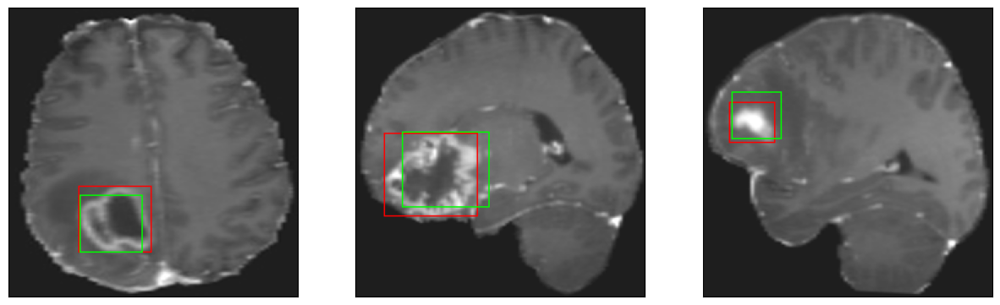

26/26 [==============================] - 8s 292ms/step - loss: 6.0885 - IoU: 0.5541 - val_loss: 9.1272 - val_IoU: 0.4994
Epoch 134/200
26/26 [==============================] - ETA: 0s - loss: 6.1064 - IoU: 0.5475
Epoch 134: val_loss did not improve from 8.50615
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


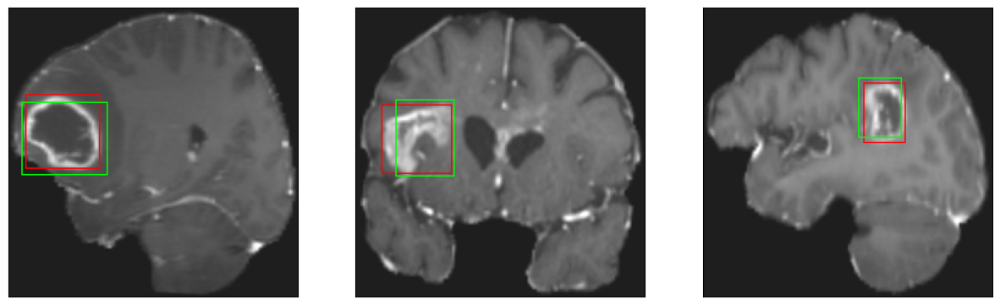

26/26 [==============================] - 8s 314ms/step - loss: 6.1064 - IoU: 0.5475 - val_loss: 11.2851 - val_IoU: 0.4391
Epoch 135/200
26/26 [==============================] - ETA: 0s - loss: 5.7235 - IoU: 0.5716
Epoch 135: val_loss did not improve from 8.50615
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


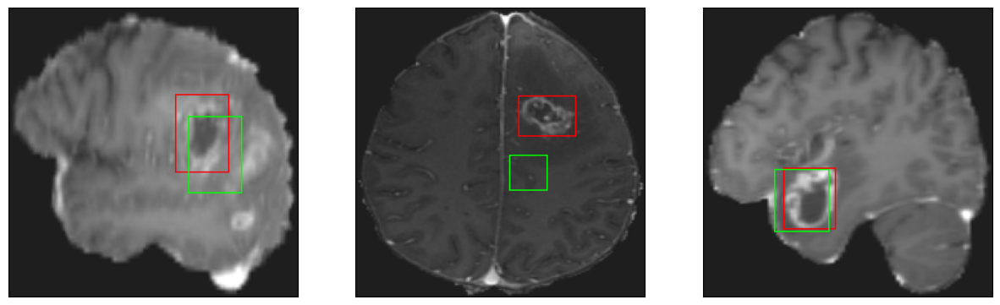

26/26 [==============================] - 8s 314ms/step - loss: 5.7235 - IoU: 0.5716 - val_loss: 8.8623 - val_IoU: 0.5102
Epoch 136/200
26/26 [==============================] - ETA: 0s - loss: 5.6756 - IoU: 0.5705
Epoch 136: val_loss did not improve from 8.50615
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


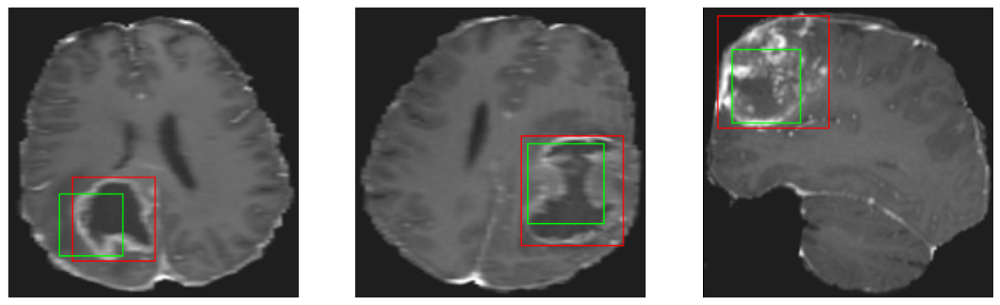

26/26 [==============================] - 8s 292ms/step - loss: 5.6756 - IoU: 0.5705 - val_loss: 10.9139 - val_IoU: 0.4442
Epoch 137/200
26/26 [==============================] - ETA: 0s - loss: 5.9875 - IoU: 0.5422
Epoch 137: val_loss did not improve from 8.50615
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 47ms/step
4
8/8 [==============================] - 0s 45ms/step
4


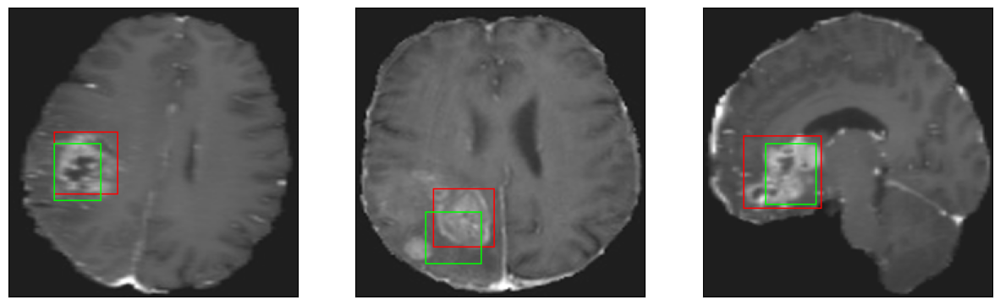

26/26 [==============================] - 8s 300ms/step - loss: 5.9875 - IoU: 0.5422 - val_loss: 9.8212 - val_IoU: 0.4487
Epoch 138/200
26/26 [==============================] - ETA: 0s - loss: 5.7629 - IoU: 0.5632
Epoch 138: val_loss did not improve from 8.50615
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


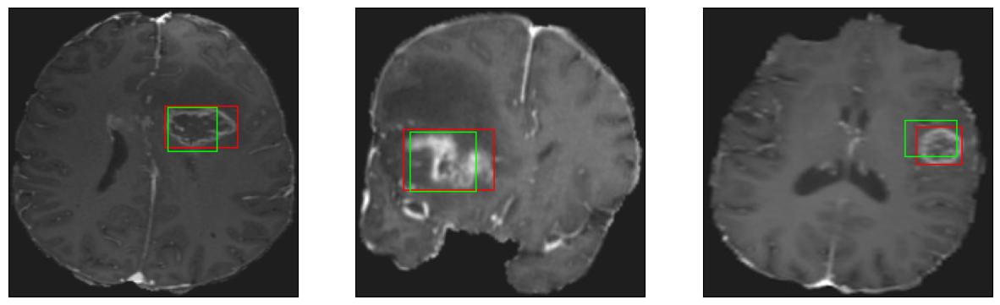

26/26 [==============================] - 7s 276ms/step - loss: 5.7629 - IoU: 0.5632 - val_loss: 9.0168 - val_IoU: 0.5038
Epoch 139/200
26/26 [==============================] - ETA: 0s - loss: 6.0102 - IoU: 0.5506
Epoch 139: val_loss improved from 8.50615 to 8.42452, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 47ms/step
4
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 43ms/step
4


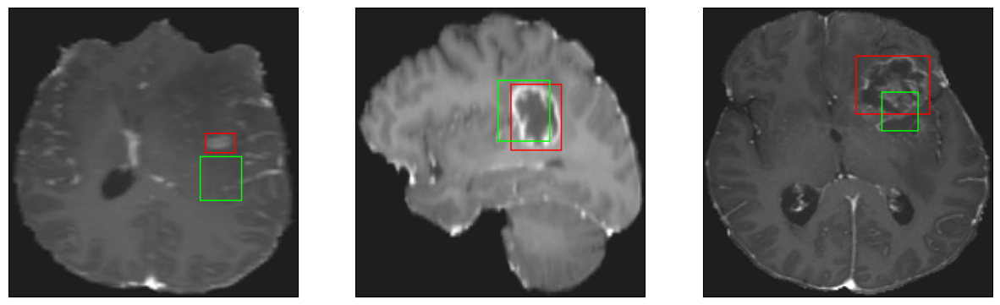

26/26 [==============================] - 20s 784ms/step - loss: 6.0102 - IoU: 0.5506 - val_loss: 8.4245 - val_IoU: 0.5263
Epoch 140/200
26/26 [==============================] - ETA: 0s - loss: 6.0340 - IoU: 0.5468
Epoch 140: val_loss did not improve from 8.42452
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 43ms/step
4


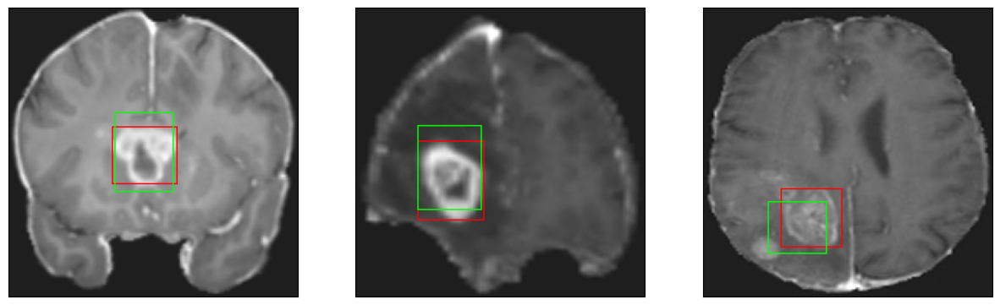

26/26 [==============================] - 8s 302ms/step - loss: 6.0340 - IoU: 0.5468 - val_loss: 8.7927 - val_IoU: 0.5122
Epoch 141/200
26/26 [==============================] - ETA: 0s - loss: 6.1185 - IoU: 0.5479
Epoch 141: val_loss did not improve from 8.42452
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 48ms/step
4
8/8 [==============================] - 0s 44ms/step
4


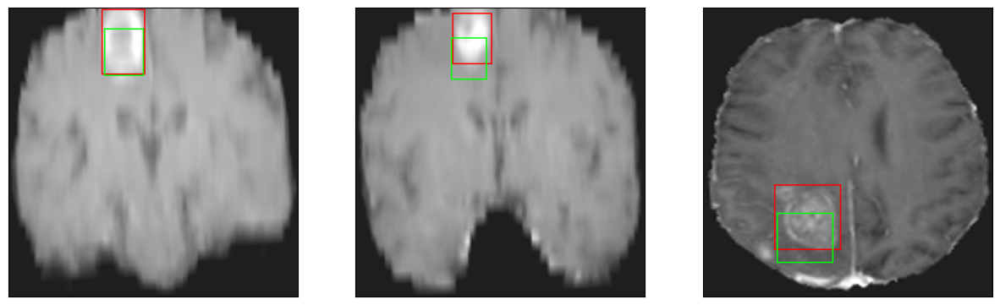

26/26 [==============================] - 8s 317ms/step - loss: 6.1185 - IoU: 0.5479 - val_loss: 8.5470 - val_IoU: 0.5125
Epoch 142/200
26/26 [==============================] - ETA: 0s - loss: 5.8181 - IoU: 0.5633
Epoch 142: val_loss did not improve from 8.42452
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4


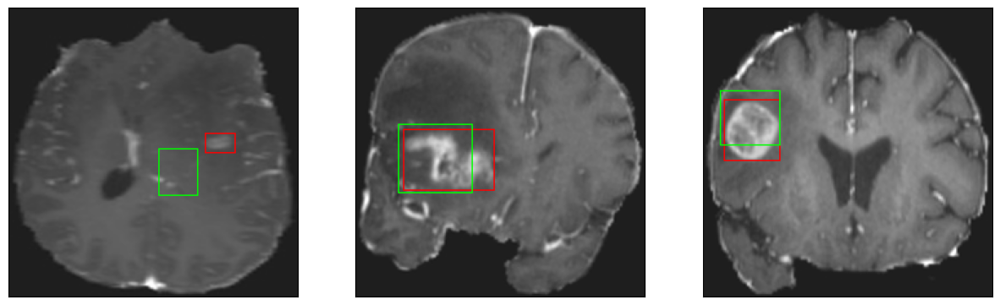

26/26 [==============================] - 8s 312ms/step - loss: 5.8181 - IoU: 0.5633 - val_loss: 9.0632 - val_IoU: 0.4974
Epoch 143/200
26/26 [==============================] - ETA: 0s - loss: 5.9534 - IoU: 0.5610
Epoch 143: val_loss did not improve from 8.42452
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


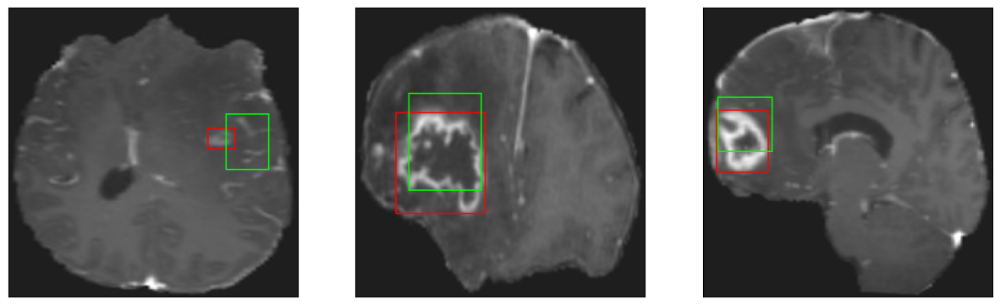

26/26 [==============================] - 8s 310ms/step - loss: 5.9534 - IoU: 0.5610 - val_loss: 11.3122 - val_IoU: 0.4358
Epoch 144/200
26/26 [==============================] - ETA: 0s - loss: 5.8688 - IoU: 0.5625
Epoch 144: val_loss did not improve from 8.42452
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4


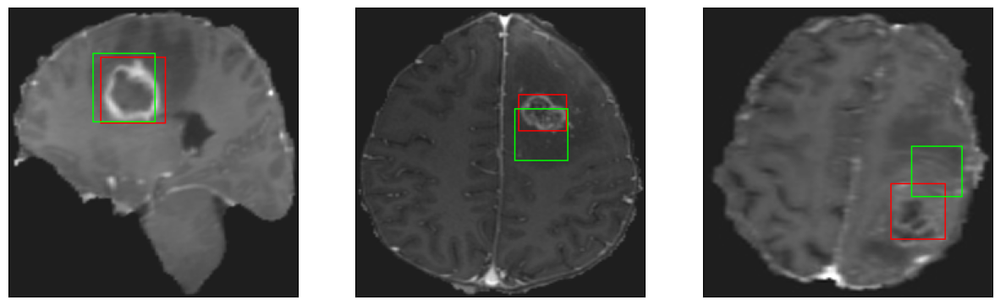

26/26 [==============================] - 8s 309ms/step - loss: 5.8688 - IoU: 0.5625 - val_loss: 8.9654 - val_IoU: 0.4950
Epoch 145/200
26/26 [==============================] - ETA: 0s - loss: 6.0399 - IoU: 0.5351
Epoch 145: val_loss did not improve from 8.42452
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4


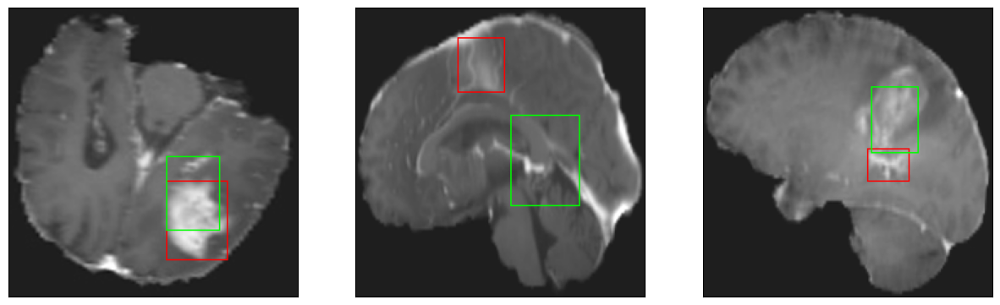

26/26 [==============================] - 7s 287ms/step - loss: 6.0399 - IoU: 0.5351 - val_loss: 14.0140 - val_IoU: 0.3762
Epoch 146/200
26/26 [==============================] - ETA: 0s - loss: 5.8508 - IoU: 0.5595
Epoch 146: val_loss did not improve from 8.42452
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


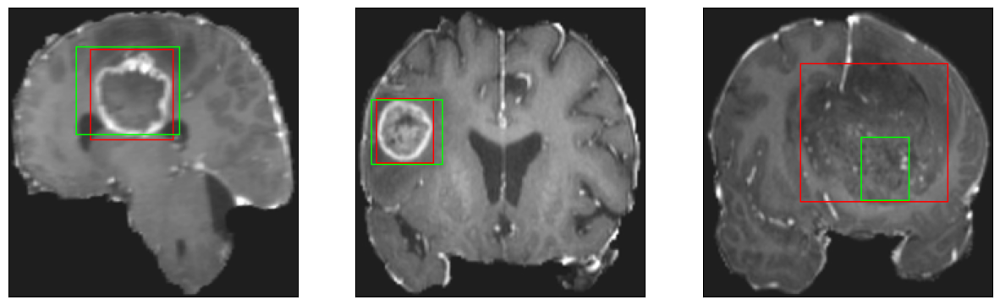

26/26 [==============================] - 7s 287ms/step - loss: 5.8508 - IoU: 0.5595 - val_loss: 9.2779 - val_IoU: 0.5096
Epoch 147/200
26/26 [==============================] - ETA: 0s - loss: 5.9933 - IoU: 0.5506
Epoch 147: val_loss did not improve from 8.42452
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 44ms/step
4


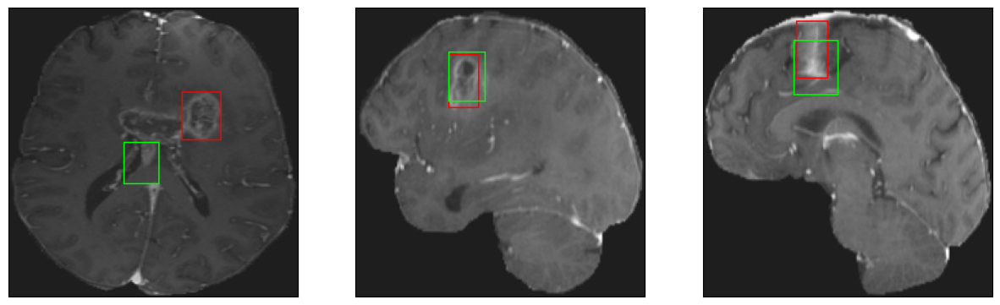

26/26 [==============================] - 8s 305ms/step - loss: 5.9933 - IoU: 0.5506 - val_loss: 9.0877 - val_IoU: 0.4963
Epoch 148/200
26/26 [==============================] - ETA: 0s - loss: 6.0647 - IoU: 0.5416
Epoch 148: val_loss did not improve from 8.42452
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


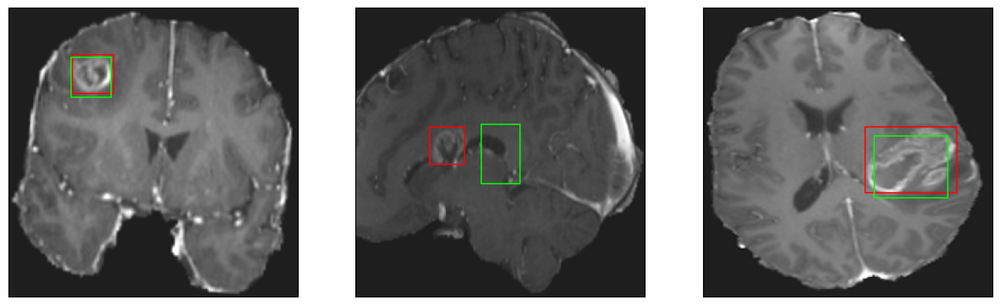

26/26 [==============================] - 8s 307ms/step - loss: 6.0647 - IoU: 0.5416 - val_loss: 8.9726 - val_IoU: 0.5134
Epoch 149/200
26/26 [==============================] - ETA: 0s - loss: 5.7611 - IoU: 0.5624
Epoch 149: val_loss did not improve from 8.42452
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 44ms/step
4


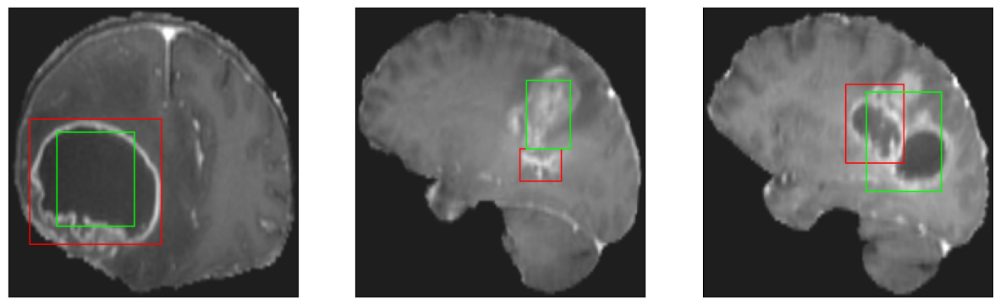

26/26 [==============================] - 8s 301ms/step - loss: 5.7611 - IoU: 0.5624 - val_loss: 9.0256 - val_IoU: 0.5030
Epoch 150/200
26/26 [==============================] - ETA: 0s - loss: 5.8863 - IoU: 0.5582
Epoch 150: val_loss did not improve from 8.42452
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


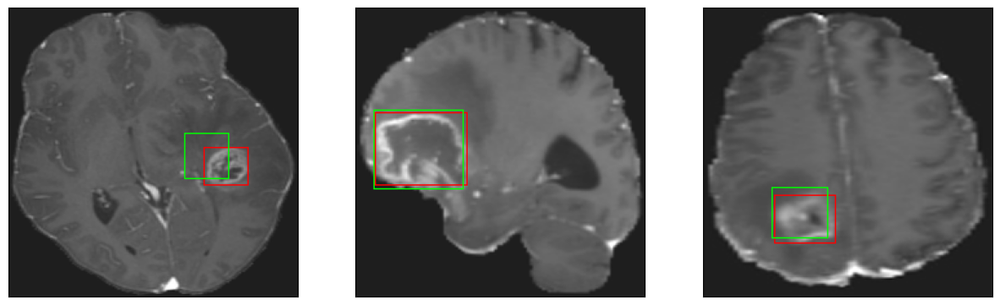

26/26 [==============================] - 8s 301ms/step - loss: 5.8863 - IoU: 0.5582 - val_loss: 9.5743 - val_IoU: 0.4672
Epoch 151/200
26/26 [==============================] - ETA: 0s - loss: 5.7505 - IoU: 0.5729
Epoch 151: val_loss did not improve from 8.42452
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


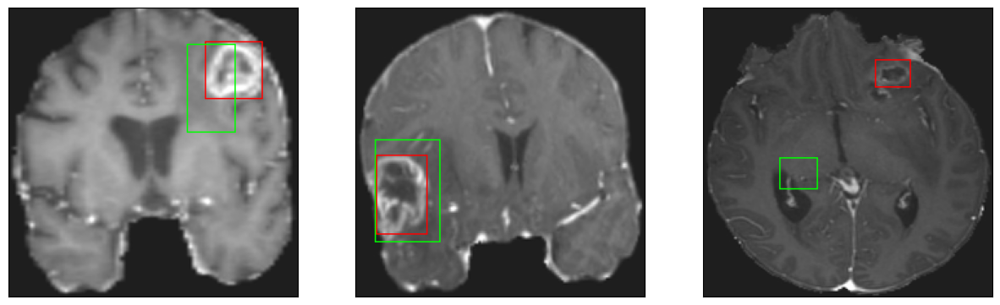

26/26 [==============================] - 8s 305ms/step - loss: 5.7505 - IoU: 0.5729 - val_loss: 10.8416 - val_IoU: 0.4494
Epoch 152/200
26/26 [==============================] - ETA: 0s - loss: 5.5754 - IoU: 0.5700
Epoch 152: val_loss did not improve from 8.42452
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 46ms/step
4


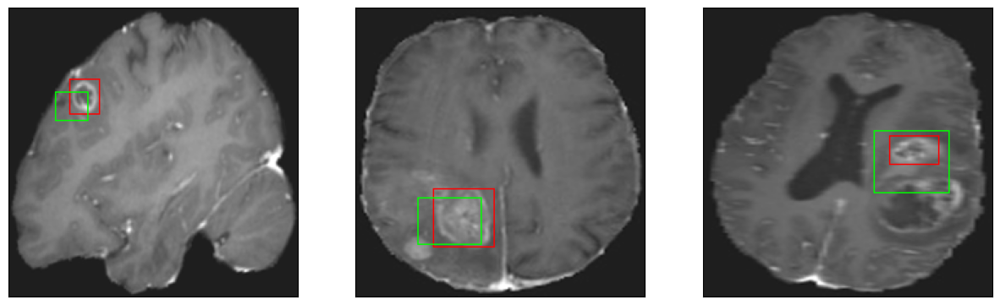

26/26 [==============================] - 8s 307ms/step - loss: 5.5754 - IoU: 0.5700 - val_loss: 9.7091 - val_IoU: 0.4675
Epoch 153/200
26/26 [==============================] - ETA: 0s - loss: 6.1105 - IoU: 0.5515
Epoch 153: val_loss did not improve from 8.42452
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 43ms/step
4


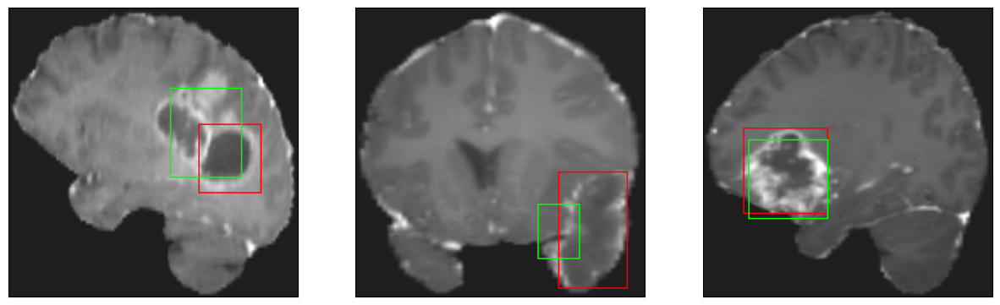

26/26 [==============================] - 7s 273ms/step - loss: 6.1105 - IoU: 0.5515 - val_loss: 10.1166 - val_IoU: 0.4529
Epoch 154/200
26/26 [==============================] - ETA: 0s - loss: 5.9671 - IoU: 0.5473
Epoch 154: val_loss did not improve from 8.42452
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 42ms/step
4


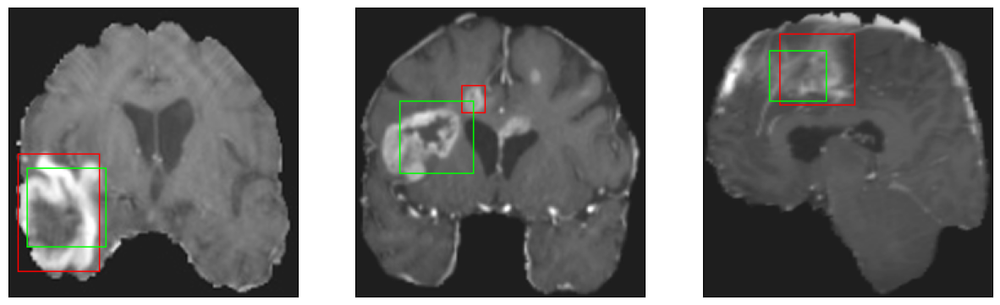

26/26 [==============================] - 8s 306ms/step - loss: 5.9671 - IoU: 0.5473 - val_loss: 8.6950 - val_IoU: 0.5178
Epoch 155/200
26/26 [==============================] - ETA: 0s - loss: 5.6286 - IoU: 0.5766
Epoch 155: val_loss did not improve from 8.42452
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


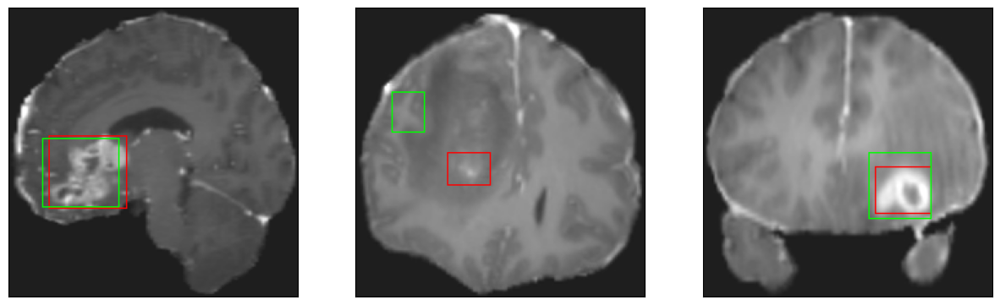

26/26 [==============================] - 8s 311ms/step - loss: 5.6286 - IoU: 0.5766 - val_loss: 11.2361 - val_IoU: 0.4388
Epoch 156/200
26/26 [==============================] - ETA: 0s - loss: 5.2706 - IoU: 0.5924
Epoch 156: val_loss did not improve from 8.42452
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 45ms/step
4


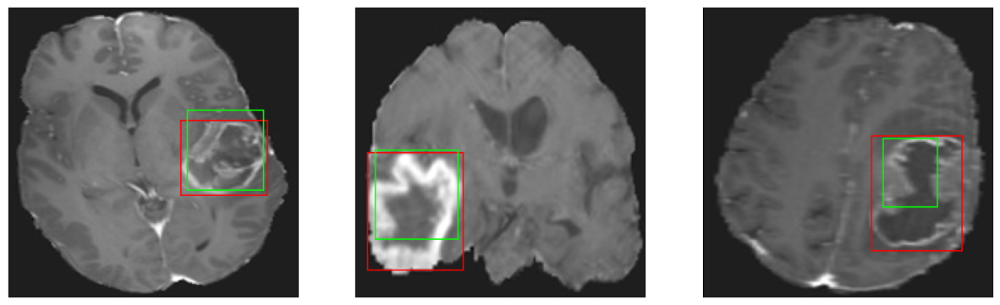

26/26 [==============================] - 8s 302ms/step - loss: 5.2706 - IoU: 0.5924 - val_loss: 10.3009 - val_IoU: 0.4557
Epoch 157/200
26/26 [==============================] - ETA: 0s - loss: 5.5773 - IoU: 0.5660
Epoch 157: val_loss did not improve from 8.42452
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4


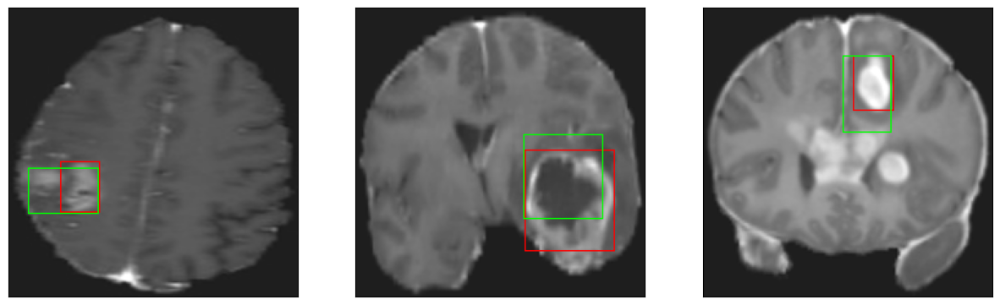

26/26 [==============================] - 8s 303ms/step - loss: 5.5773 - IoU: 0.5660 - val_loss: 10.0735 - val_IoU: 0.4654
Epoch 158/200
26/26 [==============================] - ETA: 0s - loss: 5.6477 - IoU: 0.5736
Epoch 158: val_loss did not improve from 8.42452
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4


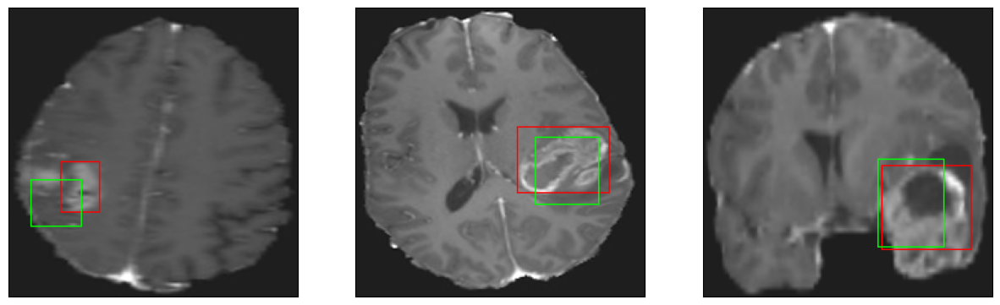

26/26 [==============================] - 8s 312ms/step - loss: 5.6477 - IoU: 0.5736 - val_loss: 10.6205 - val_IoU: 0.4555
Epoch 159/200
26/26 [==============================] - ETA: 0s - loss: 5.3977 - IoU: 0.5924
Epoch 159: val_loss did not improve from 8.42452
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 44ms/step
4


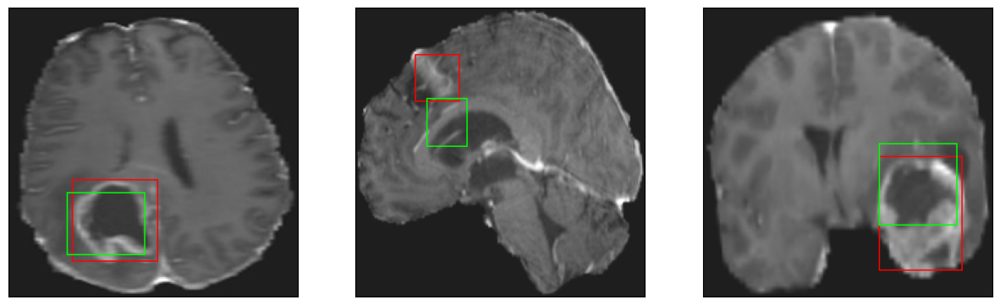

26/26 [==============================] - 8s 330ms/step - loss: 5.3977 - IoU: 0.5924 - val_loss: 9.1315 - val_IoU: 0.4945
Epoch 160/200
26/26 [==============================] - ETA: 0s - loss: 5.3355 - IoU: 0.5859
Epoch 160: val_loss did not improve from 8.42452
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


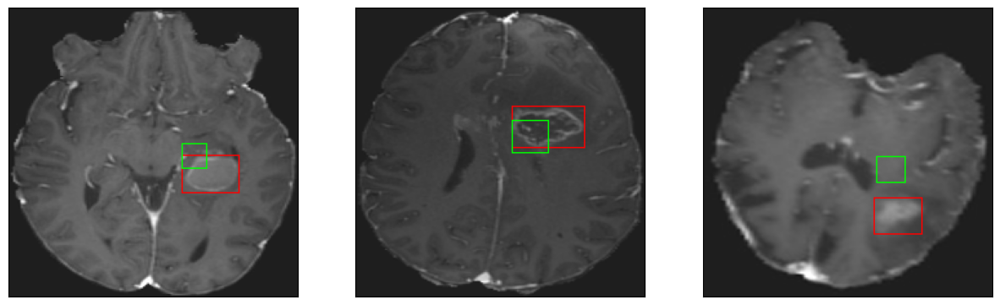

26/26 [==============================] - 7s 289ms/step - loss: 5.3355 - IoU: 0.5859 - val_loss: 9.3703 - val_IoU: 0.4811
Epoch 161/200
26/26 [==============================] - ETA: 0s - loss: 5.5800 - IoU: 0.5744
Epoch 161: val_loss did not improve from 8.42452
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


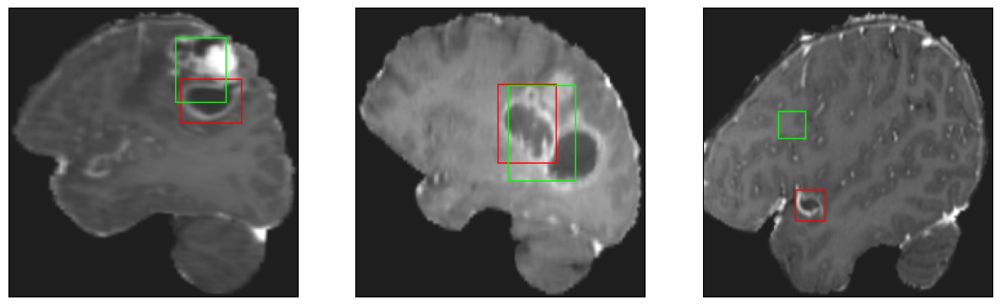

26/26 [==============================] - 8s 299ms/step - loss: 5.5800 - IoU: 0.5744 - val_loss: 8.9188 - val_IoU: 0.5229
Epoch 162/200
26/26 [==============================] - ETA: 0s - loss: 5.7377 - IoU: 0.5794
Epoch 162: val_loss did not improve from 8.42452
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 44ms/step
4


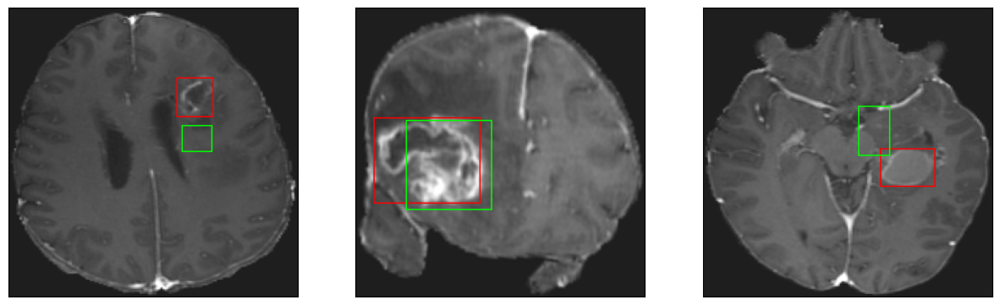

26/26 [==============================] - 8s 308ms/step - loss: 5.7377 - IoU: 0.5794 - val_loss: 8.8279 - val_IoU: 0.4984
Epoch 163/200
26/26 [==============================] - ETA: 0s - loss: 5.3419 - IoU: 0.5856
Epoch 163: val_loss did not improve from 8.42452
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


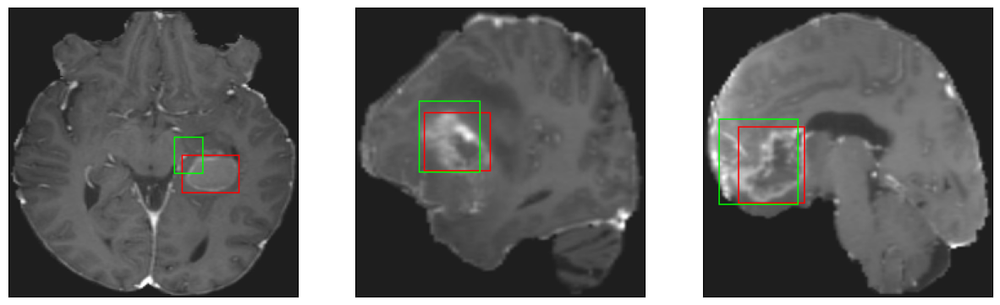

26/26 [==============================] - 7s 287ms/step - loss: 5.3419 - IoU: 0.5856 - val_loss: 9.1877 - val_IoU: 0.5065
Epoch 164/200
26/26 [==============================] - ETA: 0s - loss: 5.8252 - IoU: 0.5640
Epoch 164: val_loss did not improve from 8.42452
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 44ms/step
4


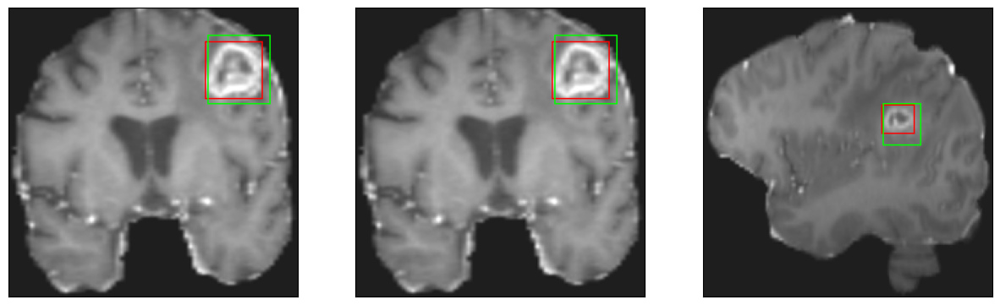

26/26 [==============================] - 8s 300ms/step - loss: 5.8252 - IoU: 0.5640 - val_loss: 8.9790 - val_IoU: 0.4788
Epoch 165/200
26/26 [==============================] - ETA: 0s - loss: 5.8015 - IoU: 0.5638
Epoch 165: val_loss did not improve from 8.42452
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 45ms/step
4


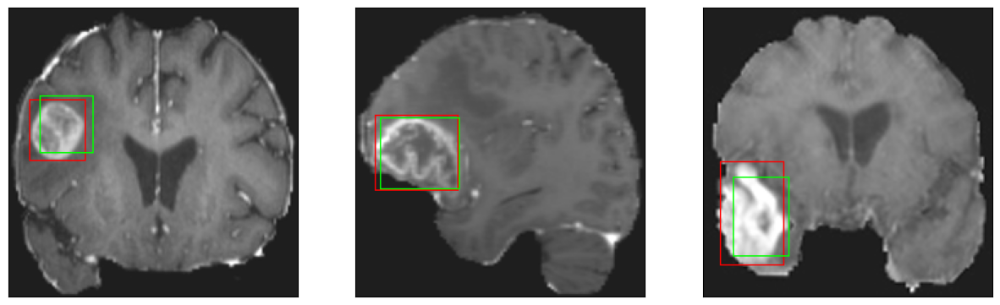

26/26 [==============================] - 8s 311ms/step - loss: 5.8015 - IoU: 0.5638 - val_loss: 9.1545 - val_IoU: 0.4916
Epoch 166/200
26/26 [==============================] - ETA: 0s - loss: 5.4223 - IoU: 0.5784
Epoch 166: val_loss did not improve from 8.42452
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


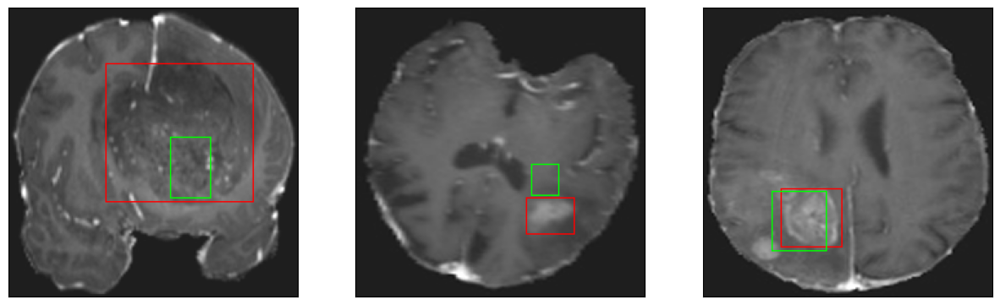

26/26 [==============================] - 8s 299ms/step - loss: 5.4223 - IoU: 0.5784 - val_loss: 9.0692 - val_IoU: 0.5029
Epoch 167/200
26/26 [==============================] - ETA: 0s - loss: 5.5845 - IoU: 0.5678
Epoch 167: val_loss did not improve from 8.42452
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 45ms/step
4


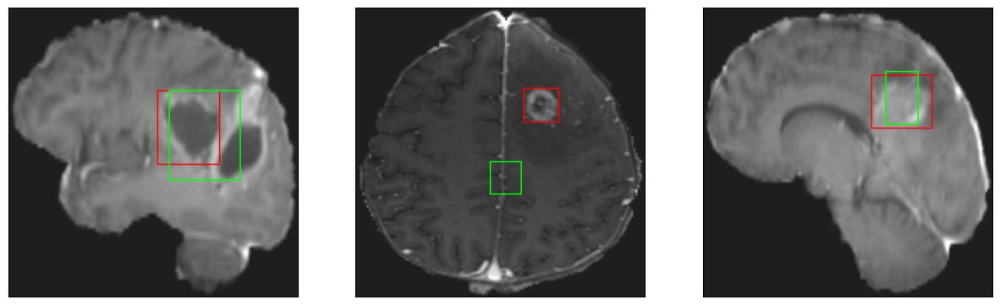

26/26 [==============================] - 8s 312ms/step - loss: 5.5845 - IoU: 0.5678 - val_loss: 8.7680 - val_IoU: 0.5195
Epoch 168/200
26/26 [==============================] - ETA: 0s - loss: 5.7254 - IoU: 0.5684
Epoch 168: val_loss did not improve from 8.42452
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


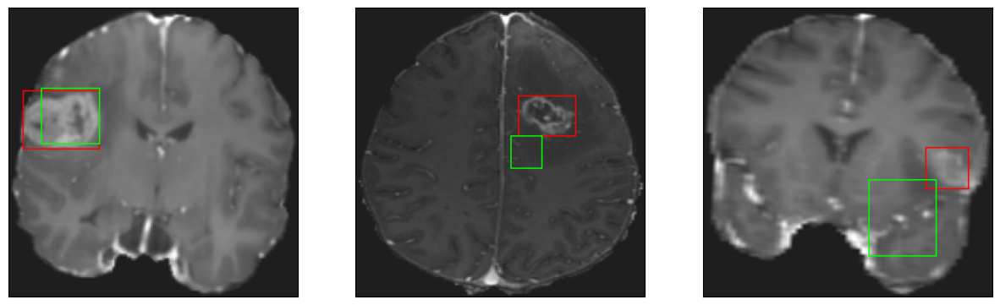

26/26 [==============================] - 7s 290ms/step - loss: 5.7254 - IoU: 0.5684 - val_loss: 9.1648 - val_IoU: 0.4892
Epoch 169/200
26/26 [==============================] - ETA: 0s - loss: 5.6278 - IoU: 0.5682
Epoch 169: val_loss did not improve from 8.42452
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4


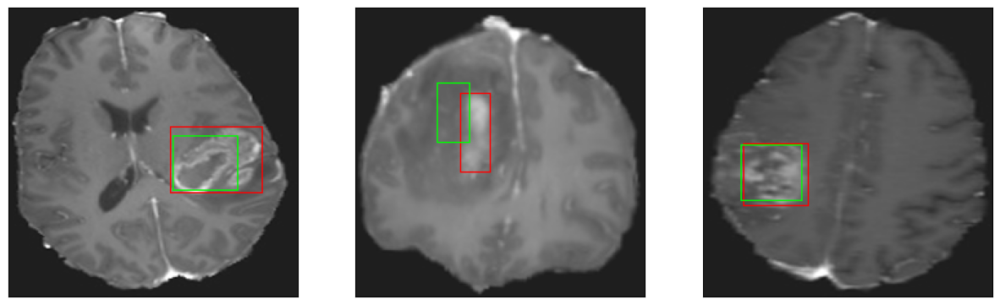

26/26 [==============================] - 8s 305ms/step - loss: 5.6278 - IoU: 0.5682 - val_loss: 9.8445 - val_IoU: 0.4745
Epoch 170/200
26/26 [==============================] - ETA: 0s - loss: 5.5721 - IoU: 0.5700
Epoch 170: val_loss did not improve from 8.42452
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 44ms/step
4


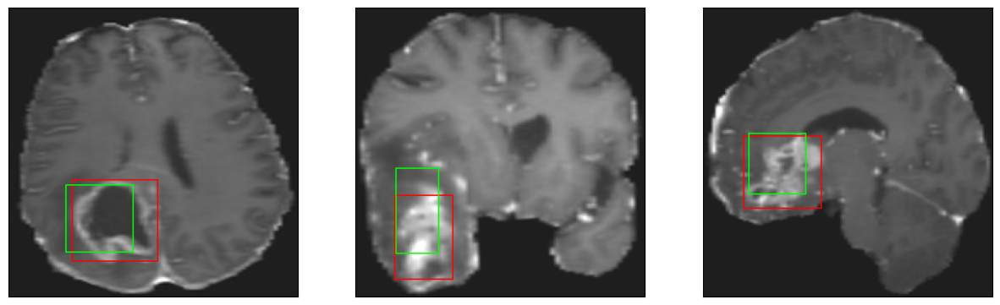

26/26 [==============================] - 8s 299ms/step - loss: 5.5721 - IoU: 0.5700 - val_loss: 8.5396 - val_IoU: 0.5172
Epoch 171/200
26/26 [==============================] - ETA: 0s - loss: 5.6148 - IoU: 0.5771
Epoch 171: val_loss did not improve from 8.42452
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


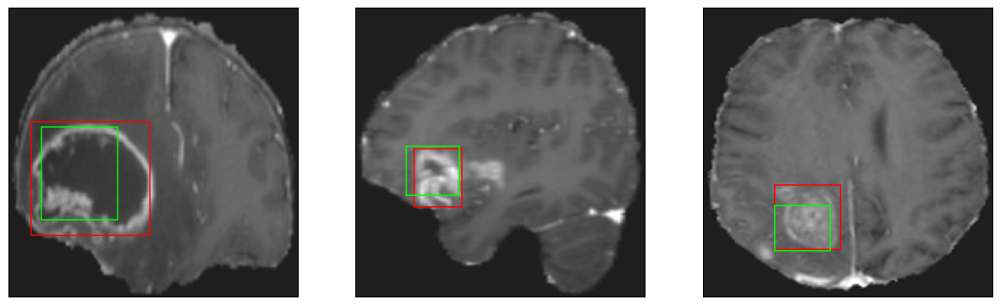

26/26 [==============================] - 7s 277ms/step - loss: 5.6148 - IoU: 0.5771 - val_loss: 9.4797 - val_IoU: 0.4615
Epoch 172/200
26/26 [==============================] - ETA: 0s - loss: 5.8551 - IoU: 0.5598
Epoch 172: val_loss did not improve from 8.42452
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


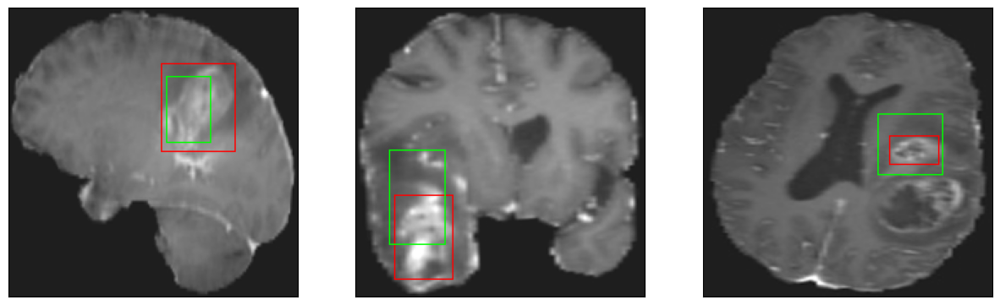

26/26 [==============================] - 8s 308ms/step - loss: 5.8551 - IoU: 0.5598 - val_loss: 12.8194 - val_IoU: 0.3717
Epoch 173/200
26/26 [==============================] - ETA: 0s - loss: 5.5510 - IoU: 0.5788
Epoch 173: val_loss did not improve from 8.42452
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 47ms/step
4
8/8 [==============================] - 0s 46ms/step
4


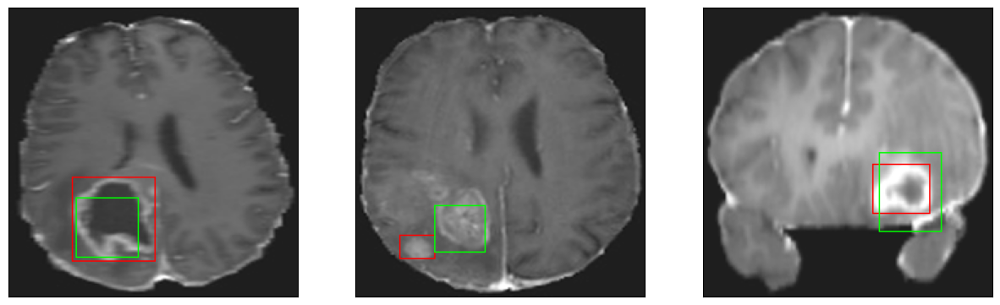

26/26 [==============================] - 8s 313ms/step - loss: 5.5510 - IoU: 0.5788 - val_loss: 10.8672 - val_IoU: 0.4570
Epoch 174/200
26/26 [==============================] - ETA: 0s - loss: 5.5822 - IoU: 0.5816
Epoch 174: val_loss did not improve from 8.42452
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


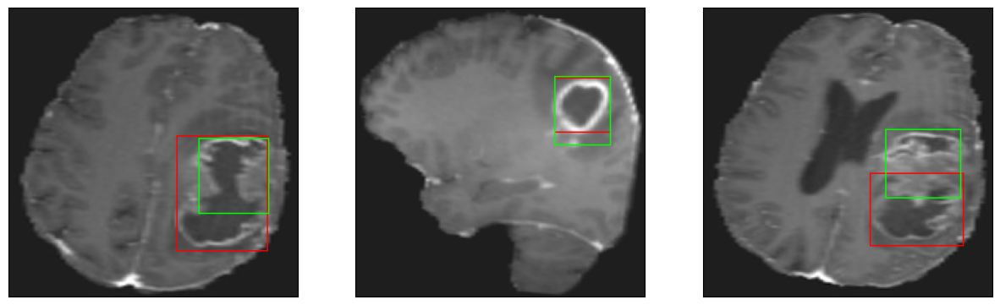

26/26 [==============================] - 8s 298ms/step - loss: 5.5822 - IoU: 0.5816 - val_loss: 8.6191 - val_IoU: 0.5087
Epoch 175/200
26/26 [==============================] - ETA: 0s - loss: 5.5364 - IoU: 0.5790
Epoch 175: val_loss did not improve from 8.42452
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 45ms/step
4


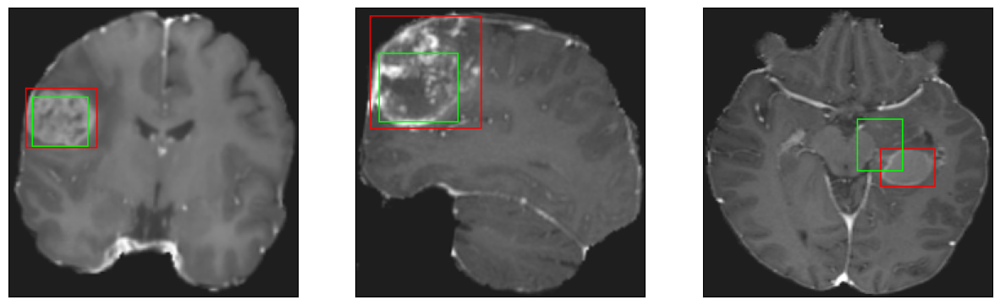

26/26 [==============================] - 8s 313ms/step - loss: 5.5364 - IoU: 0.5790 - val_loss: 10.3073 - val_IoU: 0.4374
Epoch 176/200
26/26 [==============================] - ETA: 0s - loss: 5.4663 - IoU: 0.5682
Epoch 176: val_loss did not improve from 8.42452
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


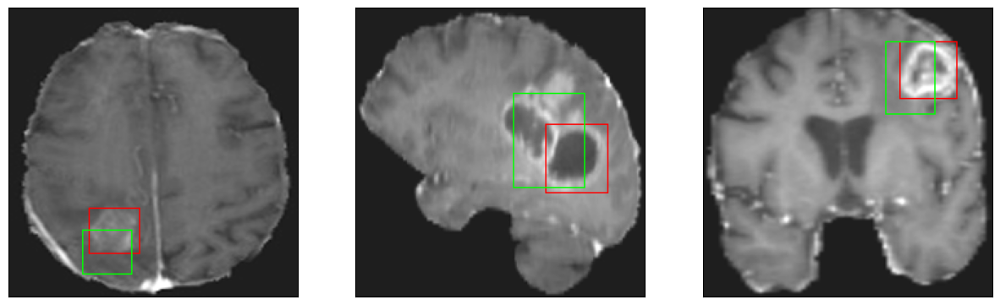

26/26 [==============================] - 8s 297ms/step - loss: 5.4663 - IoU: 0.5682 - val_loss: 10.2636 - val_IoU: 0.4606
Epoch 177/200
26/26 [==============================] - ETA: 0s - loss: 5.5079 - IoU: 0.5798
Epoch 177: val_loss did not improve from 8.42452
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 45ms/step
4


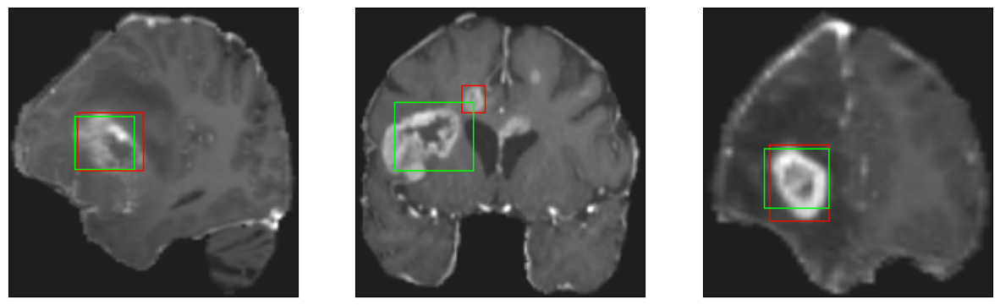

26/26 [==============================] - 8s 306ms/step - loss: 5.5079 - IoU: 0.5798 - val_loss: 9.4018 - val_IoU: 0.4657
Epoch 178/200
26/26 [==============================] - ETA: 0s - loss: 5.5304 - IoU: 0.5758
Epoch 178: val_loss did not improve from 8.42452
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


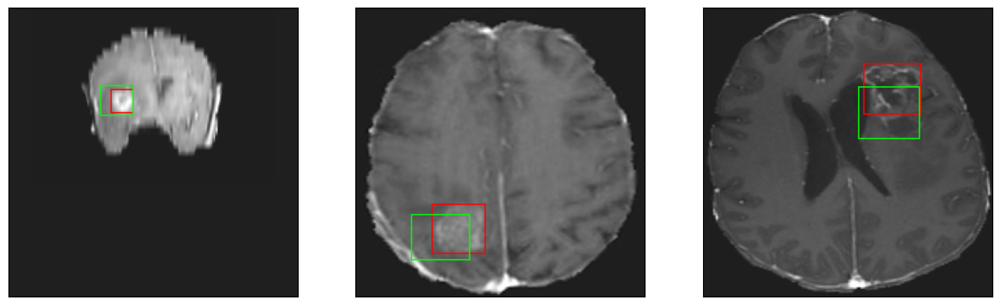

26/26 [==============================] - 8s 316ms/step - loss: 5.5304 - IoU: 0.5758 - val_loss: 9.8654 - val_IoU: 0.4607
Epoch 179/200
26/26 [==============================] - ETA: 0s - loss: 5.5047 - IoU: 0.5797
Epoch 179: val_loss did not improve from 8.42452
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


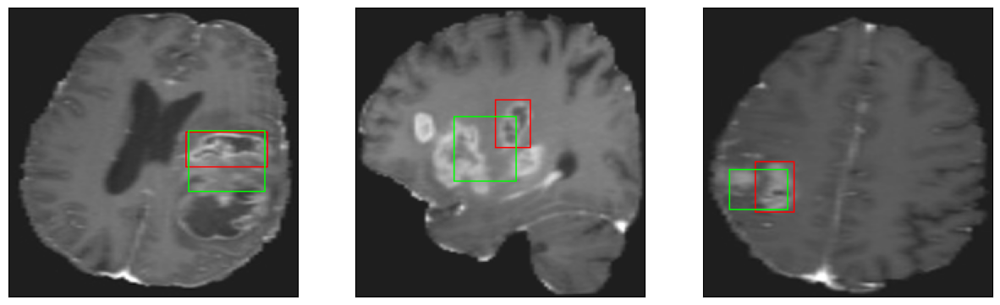

26/26 [==============================] - 8s 309ms/step - loss: 5.5047 - IoU: 0.5797 - val_loss: 8.7406 - val_IoU: 0.5411
Epoch 180/200
26/26 [==============================] - ETA: 0s - loss: 5.5889 - IoU: 0.5676
Epoch 180: val_loss did not improve from 8.42452
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


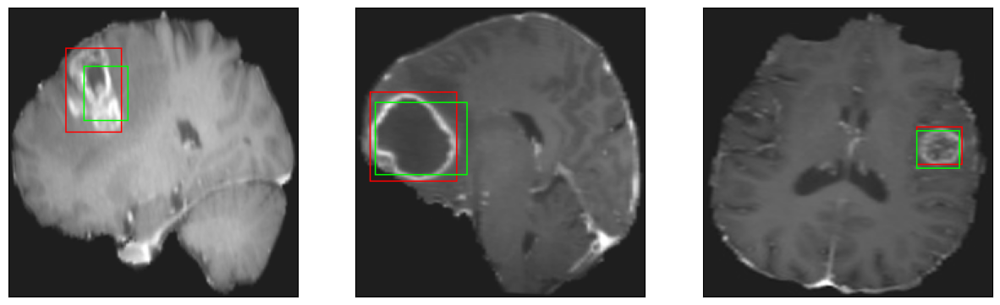

26/26 [==============================] - 7s 290ms/step - loss: 5.5889 - IoU: 0.5676 - val_loss: 8.9028 - val_IoU: 0.5135
Epoch 181/200
26/26 [==============================] - ETA: 0s - loss: 5.4365 - IoU: 0.5813
Epoch 181: val_loss did not improve from 8.42452
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


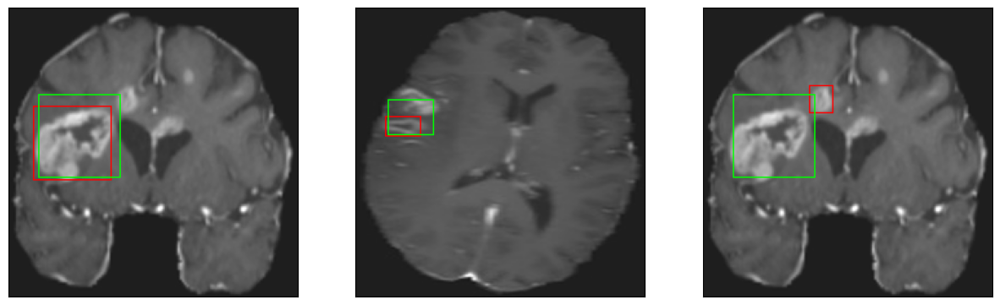

26/26 [==============================] - 7s 274ms/step - loss: 5.4365 - IoU: 0.5813 - val_loss: 8.4471 - val_IoU: 0.5449
Epoch 182/200
26/26 [==============================] - ETA: 0s - loss: 5.9130 - IoU: 0.5466
Epoch 182: val_loss did not improve from 8.42452
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 43ms/step
4


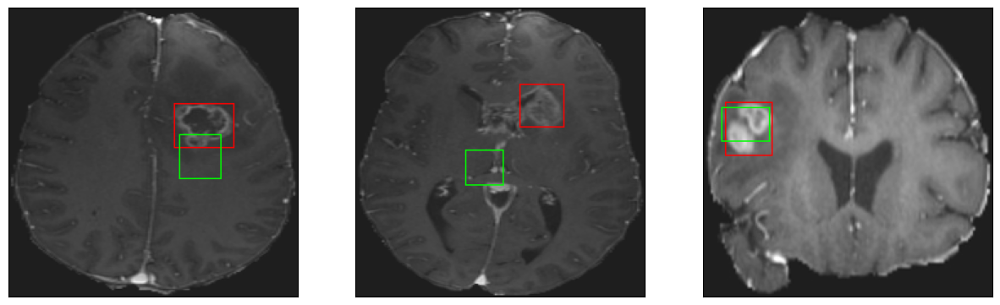

26/26 [==============================] - 8s 317ms/step - loss: 5.9130 - IoU: 0.5466 - val_loss: 8.7949 - val_IoU: 0.5055
Epoch 183/200
26/26 [==============================] - ETA: 0s - loss: 5.3477 - IoU: 0.5928
Epoch 183: val_loss did not improve from 8.42452
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


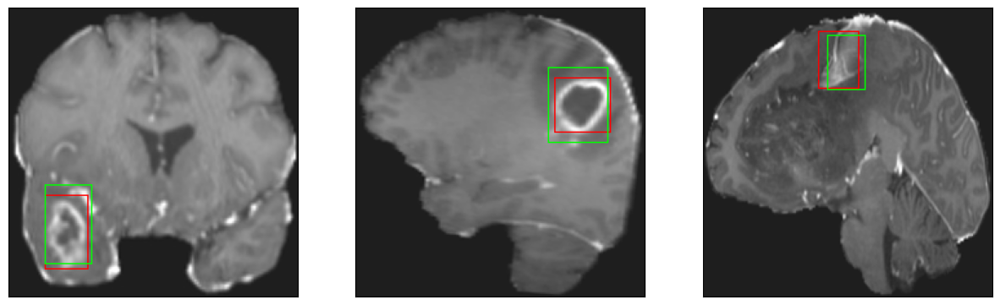

26/26 [==============================] - 8s 310ms/step - loss: 5.3477 - IoU: 0.5928 - val_loss: 10.1294 - val_IoU: 0.4398
Epoch 184/200
26/26 [==============================] - ETA: 0s - loss: 5.4233 - IoU: 0.5797
Epoch 184: val_loss did not improve from 8.42452
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 43ms/step
4


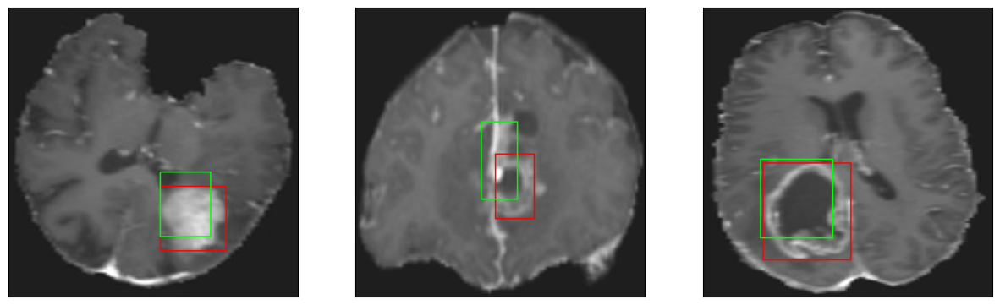

26/26 [==============================] - 8s 292ms/step - loss: 5.4233 - IoU: 0.5797 - val_loss: 8.4866 - val_IoU: 0.5265
Epoch 185/200
26/26 [==============================] - ETA: 0s - loss: 5.1901 - IoU: 0.5868
Epoch 185: val_loss did not improve from 8.42452
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


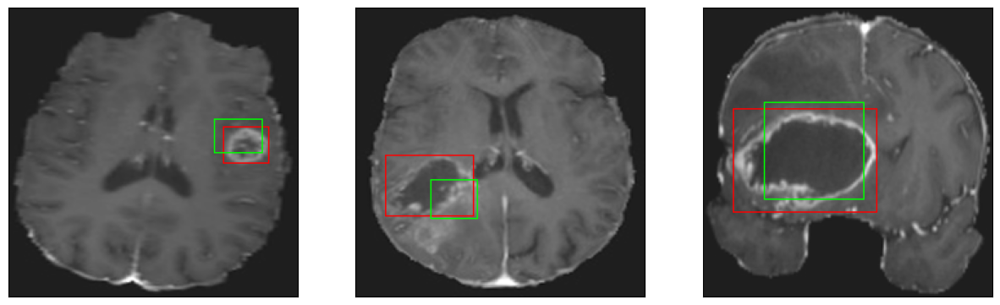

26/26 [==============================] - 7s 288ms/step - loss: 5.1901 - IoU: 0.5868 - val_loss: 9.7758 - val_IoU: 0.4559
Epoch 186/200
26/26 [==============================] - ETA: 0s - loss: 5.4502 - IoU: 0.5825
Epoch 186: val_loss improved from 8.42452 to 8.11518, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 48ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 47ms/step
4


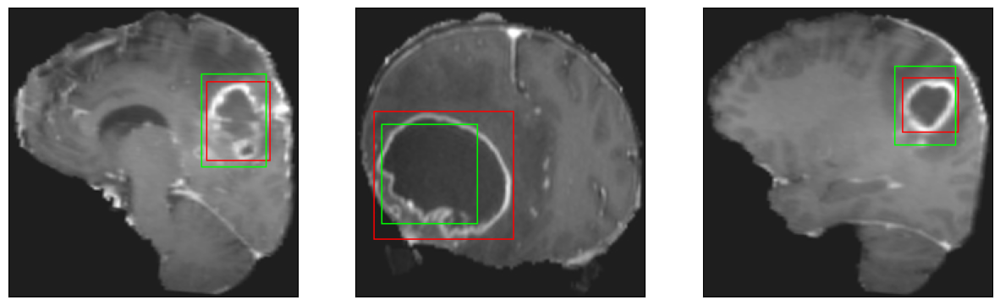

26/26 [==============================] - 18s 728ms/step - loss: 5.4502 - IoU: 0.5825 - val_loss: 8.1152 - val_IoU: 0.5423
Epoch 187/200
26/26 [==============================] - ETA: 0s - loss: 5.4320 - IoU: 0.5837
Epoch 187: val_loss did not improve from 8.11518
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 47ms/step
4
8/8 [==============================] - 0s 43ms/step
4


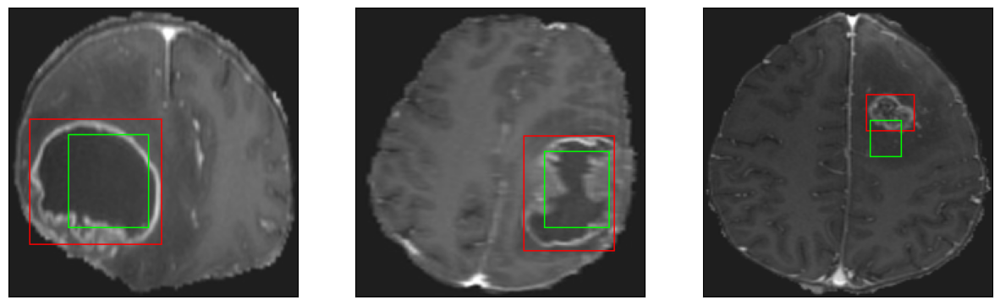

26/26 [==============================] - 8s 324ms/step - loss: 5.4320 - IoU: 0.5837 - val_loss: 9.3342 - val_IoU: 0.4865
Epoch 188/200
26/26 [==============================] - ETA: 0s - loss: 5.2036 - IoU: 0.5930
Epoch 188: val_loss did not improve from 8.11518
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 49ms/step
4
8/8 [==============================] - 0s 42ms/step
4


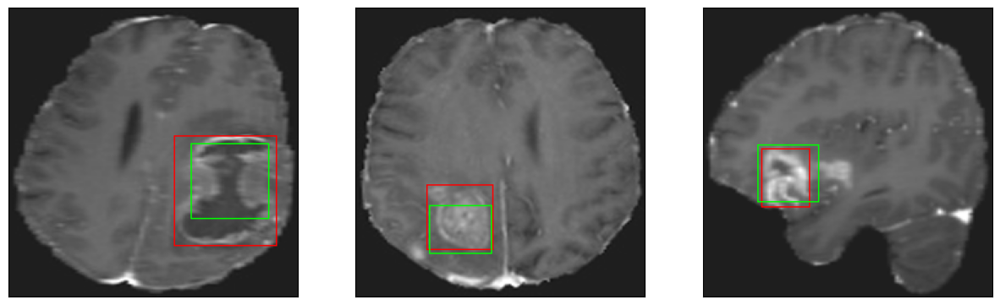

26/26 [==============================] - 9s 350ms/step - loss: 5.2036 - IoU: 0.5930 - val_loss: 8.2131 - val_IoU: 0.5360
Epoch 189/200
26/26 [==============================] - ETA: 0s - loss: 5.3787 - IoU: 0.5767
Epoch 189: val_loss did not improve from 8.11518
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


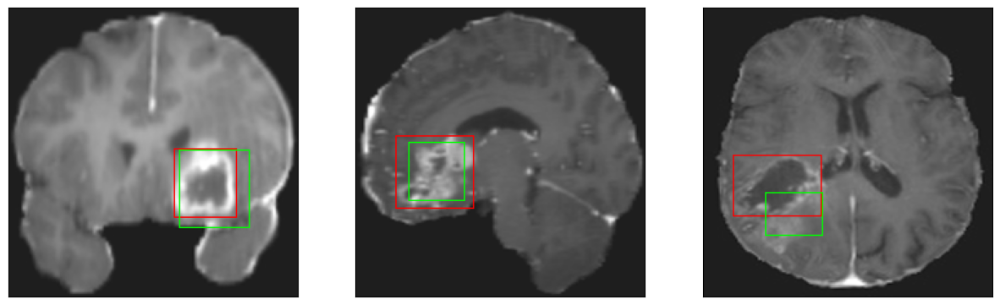

26/26 [==============================] - 7s 273ms/step - loss: 5.3787 - IoU: 0.5767 - val_loss: 8.3377 - val_IoU: 0.5382
Epoch 190/200
26/26 [==============================] - ETA: 0s - loss: 5.2863 - IoU: 0.5924
Epoch 190: val_loss did not improve from 8.11518
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 44ms/step
4


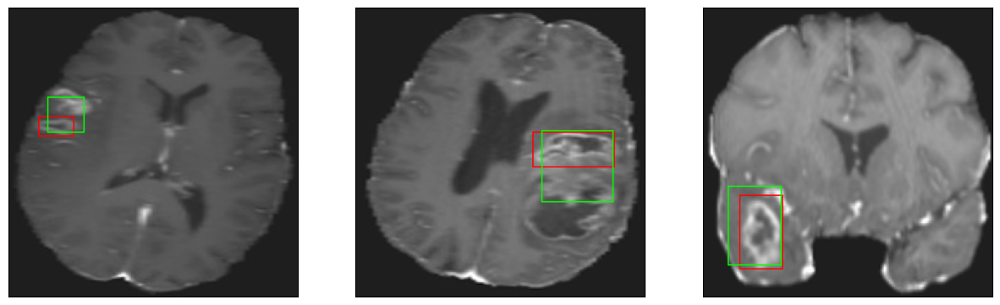

26/26 [==============================] - 7s 275ms/step - loss: 5.2863 - IoU: 0.5924 - val_loss: 8.2152 - val_IoU: 0.5471
Epoch 191/200
26/26 [==============================] - ETA: 0s - loss: 5.2427 - IoU: 0.5939
Epoch 191: val_loss improved from 8.11518 to 7.86072, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


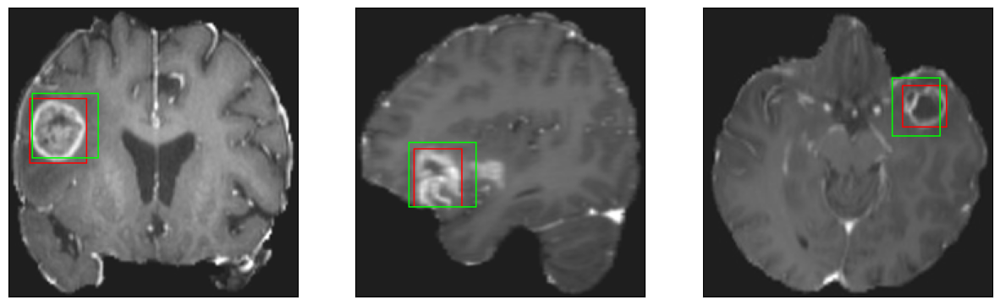

26/26 [==============================] - 19s 754ms/step - loss: 5.2427 - IoU: 0.5939 - val_loss: 7.8607 - val_IoU: 0.5679
Epoch 192/200
26/26 [==============================] - ETA: 0s - loss: 5.3099 - IoU: 0.5943
Epoch 192: val_loss did not improve from 7.86072
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 49ms/step
4


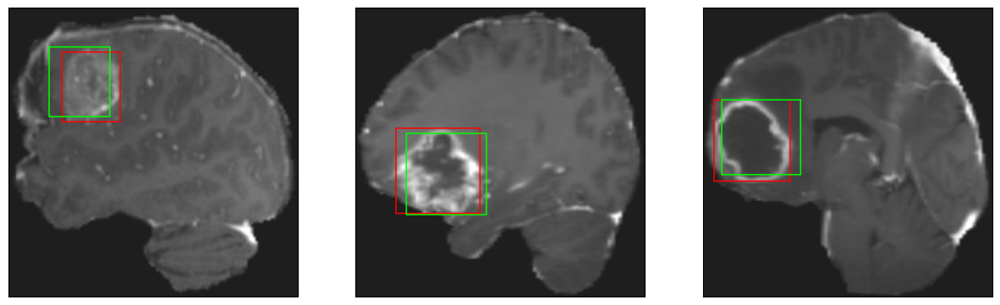

26/26 [==============================] - 8s 311ms/step - loss: 5.3099 - IoU: 0.5943 - val_loss: 9.0815 - val_IoU: 0.5170
Epoch 193/200
26/26 [==============================] - ETA: 0s - loss: 5.1479 - IoU: 0.6100
Epoch 193: val_loss did not improve from 7.86072
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 48ms/step
4


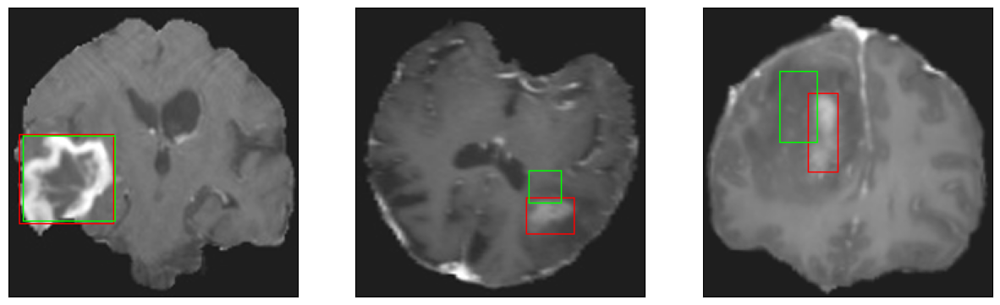

26/26 [==============================] - 9s 339ms/step - loss: 5.1479 - IoU: 0.6100 - val_loss: 8.9749 - val_IoU: 0.5196
Epoch 194/200
26/26 [==============================] - ETA: 0s - loss: 5.2052 - IoU: 0.6096
Epoch 194: val_loss did not improve from 7.86072
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


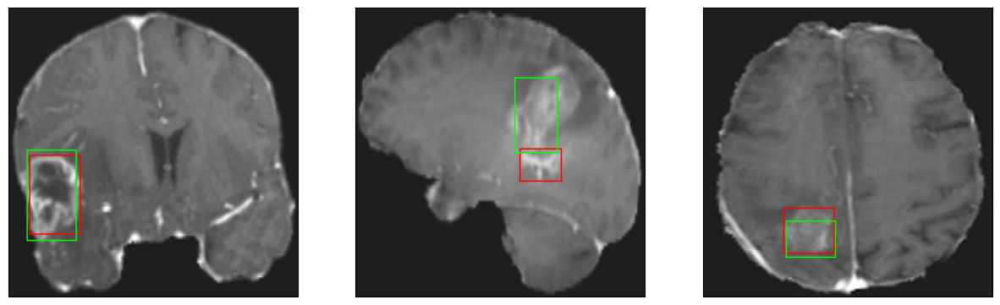

26/26 [==============================] - 8s 306ms/step - loss: 5.2052 - IoU: 0.6096 - val_loss: 11.5505 - val_IoU: 0.4338
Epoch 195/200
26/26 [==============================] - ETA: 0s - loss: 5.4497 - IoU: 0.5813
Epoch 195: val_loss did not improve from 7.86072
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


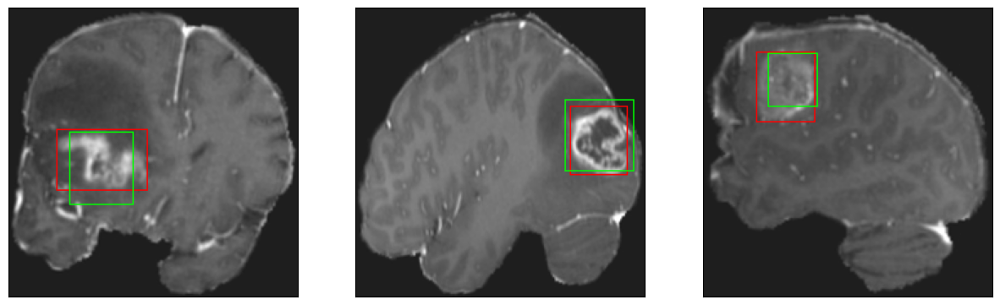

26/26 [==============================] - 8s 293ms/step - loss: 5.4497 - IoU: 0.5813 - val_loss: 8.9645 - val_IoU: 0.5135
Epoch 196/200
26/26 [==============================] - ETA: 0s - loss: 5.1875 - IoU: 0.5959
Epoch 196: val_loss did not improve from 7.86072
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


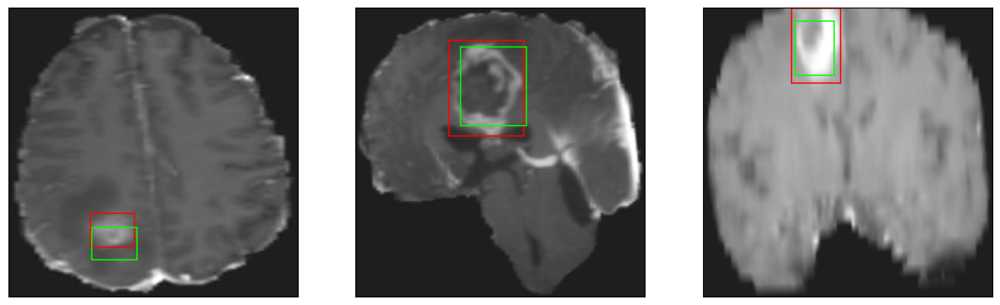

26/26 [==============================] - 8s 311ms/step - loss: 5.1875 - IoU: 0.5959 - val_loss: 9.2219 - val_IoU: 0.4783
Epoch 197/200
26/26 [==============================] - ETA: 0s - loss: 5.1674 - IoU: 0.6009
Epoch 197: val_loss did not improve from 7.86072
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 42ms/step
4


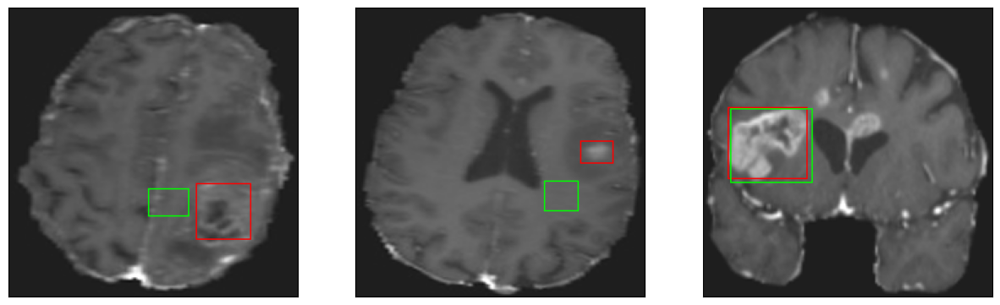

26/26 [==============================] - 8s 322ms/step - loss: 5.1674 - IoU: 0.6009 - val_loss: 9.1160 - val_IoU: 0.4971
Epoch 198/200
26/26 [==============================] - ETA: 0s - loss: 5.3248 - IoU: 0.5899
Epoch 198: val_loss did not improve from 7.86072
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


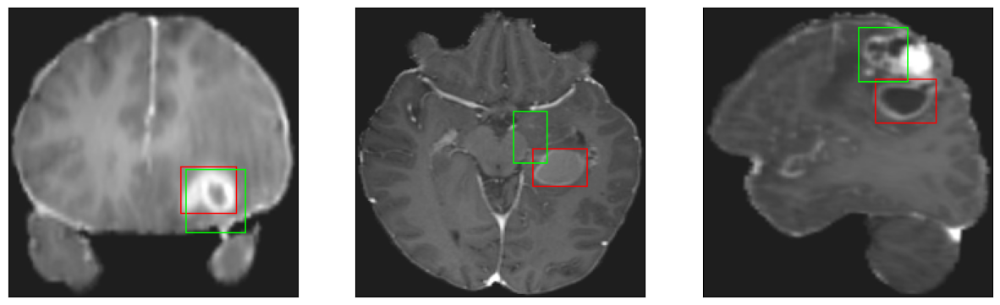

26/26 [==============================] - 8s 299ms/step - loss: 5.3248 - IoU: 0.5899 - val_loss: 8.8929 - val_IoU: 0.5019
Epoch 199/200
26/26 [==============================] - ETA: 0s - loss: 5.4834 - IoU: 0.5751
Epoch 199: val_loss did not improve from 7.86072
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4


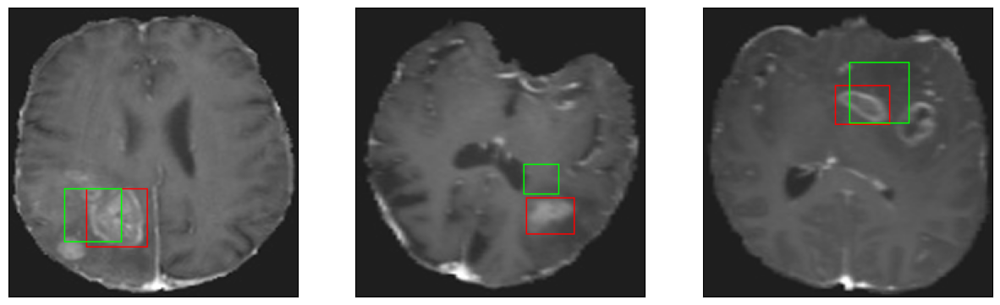

26/26 [==============================] - 7s 284ms/step - loss: 5.4834 - IoU: 0.5751 - val_loss: 8.4193 - val_IoU: 0.5094
Epoch 200/200
26/26 [==============================] - ETA: 0s - loss: 5.1952 - IoU: 0.5870
Epoch 200: val_loss did not improve from 7.86072
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 43ms/step
4


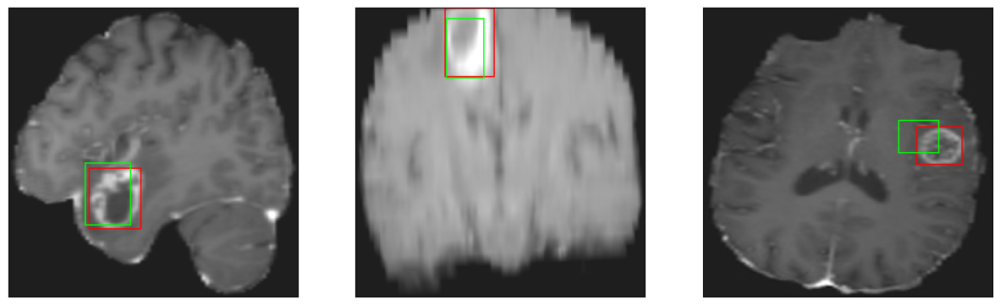

26/26 [==============================] - 8s 295ms/step - loss: 5.1952 - IoU: 0.5870 - val_loss: 9.5785 - val_IoU: 0.4540


In [24]:
model.fit(
        train_dataset,
        epochs=200,
        validation_data = val_dataset,
        callbacks = callbacks_list
        )

In [26]:
#iou = IoU(y_true, y_pred, 4, [1])
model = tf.keras.models.load_model('./model_checkpoint_SCRATCH/model_SCRATCH.h5',compile = False)

In [28]:
model.compile(
    loss={
        'coords': 'mae'
    },
    optimizer=tf.keras.optimizers.Adam(1e-3),
    metrics=[IoU]
)

In [29]:
model.evaluate(test_dataset)

8/8 [==============================] - 1s 61ms/step - loss: 9.3524 - IoU: 0.4997


[9.35243034362793, 0.4996558129787445]